# COSMOS2020 catalogue analysis 

by D. Blanquez, I. Davidzon, G. Magdis

Contacts: dblse@space.dtu.dk

With the present Notebook the user is able to extract valuable information from the COSMOS2020 catalogue, which can be downloaded from [this data repository](https://cosmos2020.calet.org/). This is also a convenient starting point for further analysis. With minimal modifications the code can be useful to study others galaxy catalogues. 

The Notebook is divided in the following sections:

* **Introduction**: loading the tables and selecting the columns
* **Data preparation**: basic manipulations/corrections of the original photometry
* **Data visualization**: sky map, redshift and color distributions, SED fitting
* **Classic diagnostics**: color-color diagrams, SFR vs. M* diagram, ...
* **A simple machine-learning application**: prducing "mock photometry" by means of Gaussian Mixtures

Acknowledgments: if you use the COSMOS2020 catalog in your study, please cite [Weaver et al. (2021)](https://arxiv.org/abs/2110.13923)

In [5]:
%config InlineBackend.figure_format='retina'
%matplotlib inline
import scipy as sp
import time
import numpy as np 
import pandas as pd
from tabulate import tabulate
from matplotlib import pyplot as plt 
import h5py # used in the Data Visualization section 
import mpl_scatter_density
from astropy.io import fits,ascii,votable
from astropy import units as u 
from astropy import constants as const
from astropy import table
from astropy.table import join
from astropy.cosmology import Planck15,FlatLambdaCDM
from scipy.stats import norm
import statistics
import plotly.express as px
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
import matplotlib.tri as mtri
# For ML application
from sklearn.cluster import KMeans
from sklearn import mixture
from itertools import combinations
from sklearn import datasets
from sklearn.linear_model import LogisticRegression
from sklearn.inspection import permutation_importance
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor 
from sklearn.metrics import mean_absolute_error
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.metrics import accuracy_score
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import precision_score
from sklearn.datasets import load_breast_cancer
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OrdinalEncoder

In [6]:
# Specify the version of the catalog and the folder with the input/output files
catversion = 'Farmer'  # this string can be either 'Classic' or 'Farmer'
dir_in = '/Users/yokisalcedo/Cosmos2020repo/data/processed/'  
dir_out = '/Users/yokisalcedo/Cosmos2020repo/models/' # the directory where the output of this notebook will be stored
# Upload the main catalogue
cat = table.Table.read(dir_in+'COSMOS2020_{}_jan_processed.fits'.format(catversion),format='fits',hdu=1)

In [7]:
#All possible non-redundant colors are listed below:
#u: ug ,ur ,ui ,uz , uy
#g: gr, gi, gz, gy
#r: ri, rz, ry
#i: iz, iy
#z: zy

ug = cat['CFHT_u_MAG'] - cat['HSC_g_MAG'] 
ur = cat['CFHT_u_MAG'] - cat['HSC_r_MAG']
ui = cat['CFHT_u_MAG'] - cat['HSC_i_MAG']
uz = cat['CFHT_u_MAG'] - cat['HSC_z_MAG'] 
uy = cat['CFHT_u_MAG'] - cat['HSC_y_MAG']
gr = cat['HSC_g_MAG'] - cat['HSC_r_MAG']
gi = cat['HSC_g_MAG'] - cat['HSC_i_MAG']
gz = cat['HSC_g_MAG'] - cat['HSC_z_MAG']
gy = cat['HSC_g_MAG'] - cat['HSC_y_MAG']
ri = cat['HSC_r_MAG'] - cat['HSC_i_MAG']
rz = cat['HSC_r_MAG'] - cat['HSC_z_MAG']
ry = cat['HSC_r_MAG'] - cat['HSC_y_MAG']
iz = cat['HSC_i_MAG'] - cat['HSC_z_MAG']
iy = cat['HSC_i_MAG'] - cat['HSC_y_MAG']
zy = cat['HSC_z_MAG'] - cat['HSC_y_MAG']
catpd = cat.to_pandas()
catpd['ug']=ug
catpd['ur']=ur
catpd['ui']=ui
catpd['uz']=uz
catpd['uy']=uy
catpd['gr']=gr
catpd['gi']=gi
catpd['gz']=gz
catpd['gy']=gy
catpd['ri']=ri
catpd['rz']=rz
catpd['ry']=ry
catpd['iz']=iz
catpd['iy']=iy
catpd['zy']=zy
colormaskx = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['photoz']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(cat['HSC_i_MAG']),np.isfinite(cat['HSC_y_MAG']),np.isfinite(cat['CFHT_u_MAG']),np.isfinite(cat['HSC_z_MAG']),(cat['HSC_r_MAG']<24.5),(cat['HSC_i_MAG']<24.5),(cat['photoz']<4)))
#npri = np.array(xalln)[:,9]




In [ ]:
'''Indeed, 2D would be the three plots:
(r-i vs i-z), (r-i vs i-y) , (i-z vs i-y)
Those are all  projections of the 3D (z-y) vs (i-z) vs (r-i) space — which can reveal structure that gets hidden in two dimensions (e.g.: two regions could overlap in a 2D plot but be separated out when you look at the third dimension simultaneously).  However, the 2D  plots are easier to look at.  So I think it will be helpful to examine both.
I think it’s OK to just use the full random forest to color code via proba, but do look at the two redshift ranges separately.  That’d make it 6 2D plots, or 2 3D plots.
You should be able to write your code so you use only one function to make a set of 3 plots, and just change the proba array that you pass into the function when you call it to make the two different sets.  I.e.: see if you can avoid copying and pasting code to handle the different cases.'''

In [ ]:
#only use 3 colors, define labels and titles depending on each other, vertical lines for plots, zbin width, 

In [18]:
# c1 = i-z, c2 = r-i, c3 = i-y
#Here I will define my function that will make my 2D color color plots 
def colors(c1, c2, c3, prob, xlabel0= 'i-z', ylabel0= 'r-i', xlabel1 = 'i-y', 
                             ylabel1 = 'r-i', xlabel2 = 'i-y', ylabel2 = 'i-z',
                             title0 = 'r-i vs i-z (1.05 < z < 1.45)',
                             title1 = 'r-i vs i-y (1.05 < z < 1.45)',
                             title2 = 'i-z vs i-y (1.05 < z < 1.45)',
                             xlim0=(-2, 2), ylim0 = (0, 3), xlim1= (-2, 2), 
                             ylim1=(0, 3), xlim2 = (-2, 2), ylim2 = (0, 3),**c_kwargs):
    
    #pcmask = np.logical_and.reduce(prob,colormaskx)

    fig, (ax0, ax1, ax2) = plt.subplots(figsize=(12,4), ncols=3,  constrained_layout = True)
    
    sd0 = ax0.scatter(c1, c2, c=prob, cmap = 'viridis', s = 5, alpha = .5,vmin=0, vmax=1, **c_kwargs)
    sd1 = ax1.scatter(c3, c2, c=prob, cmap = 'viridis', s = 5, alpha = .5,vmin=0, vmax=1, **c_kwargs)
    sd2 = ax2.scatter(c3, c1, c=prob, cmap = 'viridis', s = 5, alpha = .5,vmin=0, vmax=1, **c_kwargs)
    

    ax0.set_xlim(*xlim0)
    ax0.set_ylim(*ylim0)
    ax0.set_xlabel(xlabel0)
    ax0.set_ylabel(ylabel0)
    ax1.set_xlim(*xlim1)
    ax1.set_ylim(*ylim1)
    ax1.set_xlabel(xlabel1)
    ax1.set_ylabel(ylabel1)
    ax2.set_xlim(*xlim2)
    ax2.set_ylim(*ylim2)
    ax2.set_xlabel(xlabel2)
    ax2.set_ylabel(ylabel2)
    
    cbar = plt.colorbar(sd0)
    cbar.set_label('predict_probability')
    
    ax0.set_title(title0)
    ax1.set_title(title1)
    ax2.set_title(title2)
    
    return fig


In [22]:
#Trying to use plotly to plot 3D color color plots 
fig = px.scatter_3d(xallb_test['iz'], xallb_test['ri'], xallb_test['iy'])
fig.show()


In [6]:
def colors_3d(c1, c2, c3, prob, xlabel= 'i-z', ylabel= 'r-i', zlabel = 'i-y', 
                             title = 'r-i vs i-z vs i-y',
                             xlim=(-2, 2), ylim = (0, 3), zlim= (-2, 2), **c_kwargs):
    
    

    fig = plt.figure(figsize=(14,6))
    ax = plt.axes(projection="3d")

    
    
    sd = ax.scatter(c1, c2, c3, c=prob, cmap = 'viridis', s = 5, alpha = .5,vmin=0, vmax=1, **c_kwargs)
    
    

    ax.set_xlim(*xlim)
    ax.set_ylim(*ylim)
    ax.set_zlim(*ylim)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_zlabel(zlabel)
    
    
    cbar = plt.colorbar(sd)
    cbar.set_label('predict_probability')
    
    ax.set_title(title)
    
    
    return fig



In [4]:
#The four versions we want to work with are (xalln, yn, zalln, galln), (x3n, yn, z3n, g3n), (xallb, yb, zallb , gallb ), (x3b, yb, z3b, g3b)

In [8]:
#Here we defind our narrow and broad zcut, all RF, 3 RF
#(xalln, yn, zalln, galln), (x3n, yn, z3n, g3n), (xallb, yb, zallb , gallb ), (x3b, yb, z3b, g3b)
zcutn = np.logical_and(cat['photoz'] > 1.05, cat['photoz'] < 1.45)
zcutb = np.logical_and(cat['photoz'] > 1.05, cat['photoz'] < 1.55)
xalln = catpd.loc[colormaskx,['ug','ur', 'ui', 'uz', 'uy', 'gr', 'gi', 'gz', 'gy', 'ri', 'rz', 'ry', 'iz', 'iy', 'zy','HSC_r_MAG','HSC_i_MAG','HSC_y_MAG','HSC_z_MAG','CFHT_u_MAG', 'HSC_g_MAG']]
xallb = catpd.loc[colormaskx,['ug','ur', 'ui', 'uz', 'uy', 'gr', 'gi', 'gz', 'gy', 'ri', 'rz', 'ry', 'iz', 'iy', 'zy','HSC_r_MAG','HSC_i_MAG','HSC_y_MAG','HSC_z_MAG','CFHT_u_MAG', 'HSC_g_MAG']]
x3n=catpd.loc[colormaskx,[ 'ri', 'iz', 'iy']]
x3b=catpd.loc[colormaskx,[ 'ri', 'iz', 'iy']]
zalln = cat['photoz'][colormaskx]
zallb = cat['photoz'][colormaskx]
z3n = cat['photoz'][colormaskx]
z3b = cat['photoz'][colormaskx]
galln = catpd.loc[colormaskx,['HSC_g_MAG']]
gallb = catpd.loc[colormaskx,['HSC_g_MAG']]
g3n = catpd.loc[colormaskx,['HSC_g_MAG']]
g3b = catpd.loc[colormaskx,['HSC_g_MAG']]
yn= zcutn[colormaskx]
yb=zcutb[colormaskx]

In [12]:
#Defining our classiffier and splitting training and testing data(1.05<z<1.45) with all RF (xalln, yn, zalln, galln)
xalln_train, xalln_test, yn_train, yn_test, zalln_train, zalln_test, galln_train, galln_test = train_test_split(xalln, yn, zalln, galln )
clfall_n = RandomForestClassifier()
clfall_n.fit(xalln_train, yn_train)
predalln = np.array(clfall_n.predict(xalln_test))
proballn = np.array(clfall_n.predict_proba(xalln_test))
proballb = np.array(clfall_n.predict_proba(xallb_test))
istrue_alln = (predalln == True)
isfalse_alln = (predalln == False)



In [9]:
#(x3n, yn, z3n, g3n)
x3n_train, x3n_test, yn_train, yn_test, z3n_train, z3n_test, g3n_train, g3n_test = train_test_split(x3n, yn, z3n, g3n )
clf3_n = RandomForestClassifier()
clf3_n.fit(x3n_train, yn_train)
pred3n = np.array(clf3_n.predict(x3n_test))
prob3n = np.array(clf3_n.predict_proba(x3n_test))
istrue_3n = (pred3n == True)
isfalse_3n = (pred3n == False)




In [13]:
#(xallb, yb, zallb , gallb )
xallb_train, xallb_test, yb_train, yb_test, zallb_train, zallb_test, gallb_train, gallb_test = train_test_split(xallb, yb, zallb, gallb )
clfall_b = RandomForestClassifier()
clfall_b.fit(xallb_train, yb_train)
predallb = np.array(clfall_b.predict(xallb_test))
proballb = np.array(clfall_b.predict_proba(xallb_test))
istrue_allb = (predallb == True)
isfalse_allb = (predalln == False)




In [11]:
#(x3b, yb, z3b, g3b)
x3b_train, x3b_test, yb_train, yb_test, z3b_train, z3b_test, g3b_train, g3b_test = train_test_split(x3b, yb, z3b, g3b )
clf3_b = RandomForestClassifier()
clf3_b.fit(x3b_train, yb_train)
pred3b = np.array(clf3_b.predict(x3b_test))
prob3b = np.array(clf3_b.predict_proba(x3b_test))
istrue_3b = (pred3b == True)
isfalse_3b = (pred3b == False)






In [23]:
def z_hist(c1, istrue, vlinemin, vlinemax, xlabel='Photozs', ylabel='Counts ',
                             title1='Selected objects (1.05 < z < 1.45) all RF',
                             title2='Unselected objects (1.05 < z < 1.45) all RF',histtype = 'step',
                             xlim=(0, 3), **h_kwargs):
    isfalse = ~istrue

    fig, (ax0, ax1) = plt.subplots(figsize=(14,5), ncols=2)
    
    sd0 = ax0.hist(c1[istrue], bins = 100, histtype= histtype, **h_kwargs)
    sd1 = ax1.hist(c1[isfalse], bins = 100, histtype = histtype, **h_kwargs)
    
    for ax in (ax0, ax1):
        ax.set_xlim(*xlim)
        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)
        ax.axvline(vlinemin,ls= '--',color='black')
        ax.axvline(vlinemax,ls= '--',color='black')
        
    ax0.set_title(title1)
    ax1.set_title(title2)
    
    return fig

In [9]:
def f(x, y):
    return x + y

a = (1, 2)
b = dict(y=9, x=7)  # {'y': 9, 'x': 7}
f(**b)
dict(xlabel='HSC g band', ylabel='Photozs')

{'xlabel': 'HSC g band', 'ylabel': 'Photozs'}

In [16]:
def scatter_density_g_photoz(c1, c2, istrue, hlinemin, hlinemax, xlabel='HSC g band', ylabel='Photozs',
                             title1='Selected objects (1.05 < z < 1.45) all RF',
                             title2='Unselected objects (1.05 < z < 1.45) all RF',
                             xlim=(20, 30), ylim=(0, 3), **sd_kwargs):
    isfalse = ~istrue

    fig, (ax0, ax1) = plt.subplots(figsize=(14,5), ncols=2, subplot_kw=dict(projection='scatter_density'))
    
    sd0 = ax0.scatter_density(c1[istrue], c2[istrue], **sd_kwargs)
    sd1 = ax1.scatter_density(c1[isfalse], c2[isfalse], **sd_kwargs)
    
    for ax in (ax0, ax1):
        ax.set_xlim(*xlim)
        ax.set_ylim(*ylim)
        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)
        ax.axhline(hlinemin,ls= '--',color='black')
        ax.axhline(hlinemax,ls= '--',color='black')
        
    ax0.set_title(title1)
    ax1.set_title(title2)
    
    return fig

In [17]:
def scatter_g_photoz(c1, c2, istrue, hlinemin, hlinemax, xlabel='HSC g band', ylabel='Photozs',
                             title1='Selected objects (1.05 < z < 1.45) all RF',
                             title2='Unselected objects (1.05 < z < 1.45) all RF',
                             xlim=(20, 30), ylim=(0, 3), **s_kwargs):
    isfalse = ~istrue

    fig, (ax0, ax1) = plt.subplots(figsize=(14,5), ncols=2)
    
    sd0 = ax0.scatter(c1[istrue], c2[istrue], s = 5, alpha = .5, **s_kwargs)
    sd1 = ax1.scatter(c1[isfalse], c2[isfalse], s = 5, alpha =.5, **s_kwargs)
    
    for ax in (ax0, ax1):
        ax.set_xlim(*xlim)
        ax.set_ylim(*ylim)
        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)
        ax.axhline(hlinemin,ls= '--',color='black')
        ax.axhline(hlinemax,ls= '--',color='black')
        
    ax0.set_title(title1)
    ax1.set_title(title2)
    
    return fig

In [14]:
def scatter(data1, data2, xlabel, ylabel, title,xlim=(20,30),ylim= (0,3),**kwargs):
    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    ax.scatter(data1,data2,**kwargs)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    ax.axhline(y=0,ls= '--',color='black')
    #ax.plot(data1, data2,**kwargs)
    
    return ax

In [10]:
#ii is row, jj is column. ii runs from 0 to 3 and jj from 0 to 1
def color_scat2(data1, data2, xlabel, ylabel,xlim=(-1, 2), ylim=(-1,1.5), **kwargs):
    fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(10, 16))
    
    for ii, row in enumerate(axes):
        for jj, ax in enumerate(row):
            z_min = 0.9 + ((ii * 2) + jj) * 0.1
            z_max = z_min +0.1
            colormask1 = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['photoz']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(cat['HSC_i_MAG']),np.isfinite(cat['HSC_y_MAG']),np.isfinite(cat['CFHT_u_MAG']),np.isfinite(cat['HSC_z_MAG']),(cat['photoz']<4),(cat['HSC_r_MAG']<24.5),(cat['HSC_i_MAG']<24.5)))
            mask = np.logical_and(cat['photoz'] >= z_min, cat['photoz'] < z_max,colormask1)
            plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
            plt.tight_layout()
            ax.scatter(data1[mask], data2[mask], **kwargs)
            ax.set_xlim(xlim)
            ax.set_ylim(ylim)
            ax.set_xlabel(xlabel)
            ax.set_ylabel(ylabel)
            ax.set_title(f'{z_min:0.1f}-{z_max:0.1f}')
            ax.axhline(y=0,ls= '--',color='black')
            ax.axvline(x=0,ls= '--',color='black')
    
    return fig, axes

In [6]:
# Filter names, mean wavelength, and other info (see Table 1 in W+21)
filt_name = ['GALEX_FUV', 'GALEX_NUV','CFHT_u','CFHT_ustar','HSC_g', 'HSC_r', 'HSC_i', 'HSC_z', 'HSC_y', 'UVISTA_Y', 'UVISTA_J', 'UVISTA_H', 'UVISTA_Ks', 
             'SC_IB427', 'SC_IB464', 'SC_IA484', 'SC_IB505', 'SC_IA527', 'SC_IB574', 'SC_IA624', 'SC_IA679',
             'SC_IB709', 'SC_IA738', 'SC_IA767', 'SC_IB827', 'SC_NB711', 'SC_NB816', 'UVISTA_NB118',
             'SC_B', 'SC_gp', 'SC_V', 'SC_rp', 'SC_ip','SC_zp', 'SC_zpp', 'IRAC_CH1', 'IRAC_CH2', 'IRAC_CH3','IRAC_CH4']  
filt_lambda = [0.1526,0.2307,0.3709,0.3858,0.4847,0.6219,0.7699,0.8894,0.9761,1.0216,1.2525,1.6466,2.1557,0.4266,0.4635,0.4851,0.5064,0.5261,0.5766,0.6232,0.6780,0.7073,0.7361,0.7694,0.8243,0.7121,0.8150,1.1909,0.4488,0.4804,0.5487,0.6305,0.7693,0.8978,0.9063,3.5686,4.5067,5.7788,7.9958]
filt_fwhm = [0.0224,0.07909,0.05181,0.05976,0.1383,0.1547,0.1471,0.0766,0.0786,0.0923,0.1718,0.2905,0.3074,0.02073,0.02182,0.02292,0.0231,0.02429,0.02729,0.03004,0.03363,0.03163,0.03235,0.03648,0.0343,0.0072,0.01198,0.01122,0.0892,0.1265,0.0954,0.1376,0.1497,0.0847,0.1335,0.7443,1.0119,1.4082,2.8796] 
# corresponding MW attenuation from Schelgel 
AlambdaDivEBV = [8.31,8.742,4.807,4.674,3.69,2.715,2.0,1.515,1.298,1.213,0.874,0.565,0.365,4.261,3.844,3.622,3.425,3.265,2.938,2.694,2.431,2.29,2.151,1.997,1.748,2.268,1.787,0.946,4.041,3.738,3.128,2.673,2.003,1.436,1.466,0.163,0.112,0.075,0.045]
# photometric offsets (not available for all filters, see Table 3 in W+21)
zpoff1 = [0.000,-0.352,-0.077,-0.023,0.073,0.101,0.038,0.036,0.086,0.054,0.017,-0.045,0.000,-0.104,-0.044,-0.021,-0.018,-0.045,-0.084,0.005,0.166,-0.023,-0.034,-0.032,-0.069,-0.010,-0.064,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,-0.212,-0.219,0.000,0.000]  # Farmer+LePhare
zpoff2 = [0.000,-0.029,-0.006,0.053,0.128,0.127,0.094,0.084,0.100,0.049,0.025,-0.044,0.000,-0.013,-0.008,0.022,0.025,0.033,-0.032,0.031,0.208,-0.009,0.003,-0.015,-0.001,0.023,-0.021,-0.017,-0.075,0.000,0.123,0.035,0.051,0.000,0.095,-0.087,-0.111,0.000,0.000]  # Classic+LePhare
zpoff3 = [0.000,0.000,-0.196,-0.054,0.006,0.090,0.043,0.071,0.118,0.078,0.047,-0.034,0.000,-0.199,-0.129,-0.084,-0.073,-0.087,-0.124,0.004,0.154,-0.022,-0.030,-0.013,-0.057,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,-0.102,-0.044,0.000,0.000] # Farmer+EAZY
zpoff4 = [0.000,0.000,0.000,-0.021,0.055,0.124,0.121,0.121,0.145,0.085,0.057,-0.036,0.000,-0.133,-0.098,-0.046,-0.037,-0.038,-0.062,0.038,0.214,0.024,0.022,0.01,0.022,0.000,0.000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.021,0.025,0.000,0.000] # Classic+EAZY
# create the dictionary
filt_dict = {filt_name[i]:(filt_lambda[i]*1e4,filt_fwhm[i]*1e4,AlambdaDivEBV[i],[zpoff1[i],zpoff2[i],zpoff3[i],zpoff4[i]]) for i in range(len(filt_name))}

In [4]:
# Create a mask to restrict the analysis to a subset of filters (optional)
filt_use = ['CFHT_ustar', 'CFHT_u', 'HSC_g', 'HSC_r', 'HSC_i', 'HSC_z', 'HSC_y', 'UVISTA_Y', 'UVISTA_J', 'UVISTA_H', 'UVISTA_Ks', 'IRAC_CH1', 'IRAC_CH2']
filt_mask = [i in filt_use for i in filt_name]

In [ ]:
#try random forest classifiers for 0.9-1.45, 0.95-1.45, 1-1.45, and 1.05-1.45, in addition to 1-1.5, 1.05-1.55, and 1.1-1.6

In [34]:
#Permutation importances results, mean, std, fit
result1 = permutation_importance(clf1.fit(x1_train, y1_train), x1_test,y1_test, n_repeats = 10)
mean1 = result1.importances_mean
std1 = result1.importances_std
fit1 = clf1.fit(x1_train, y1_train)

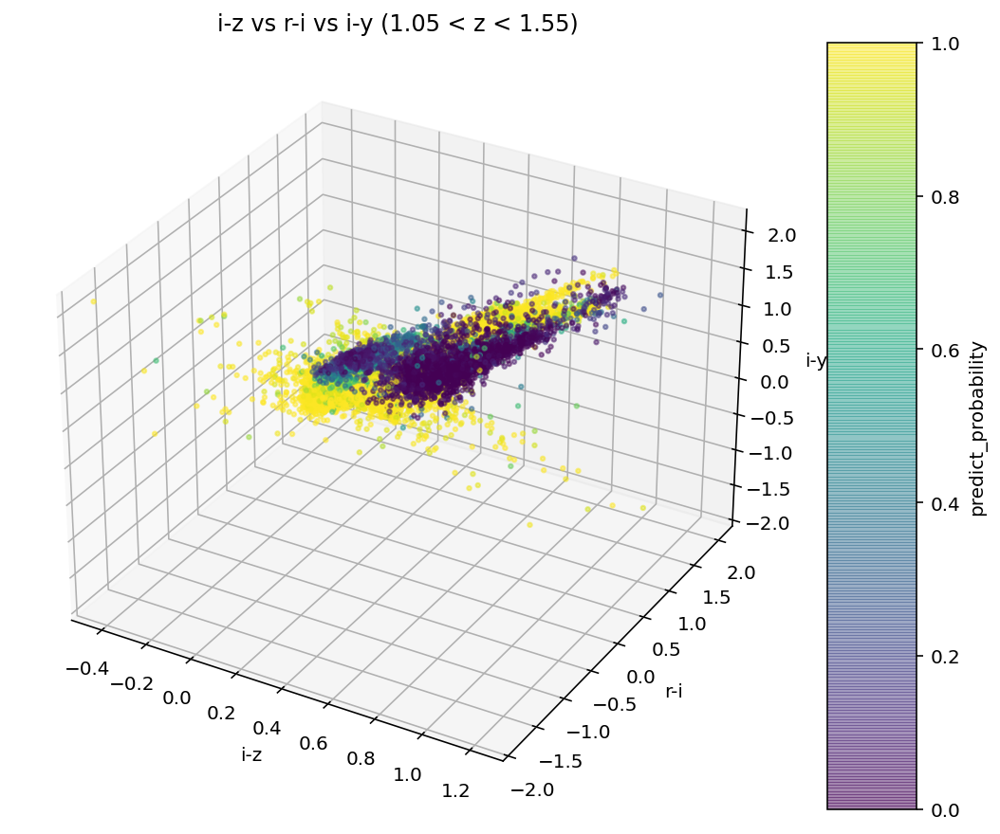

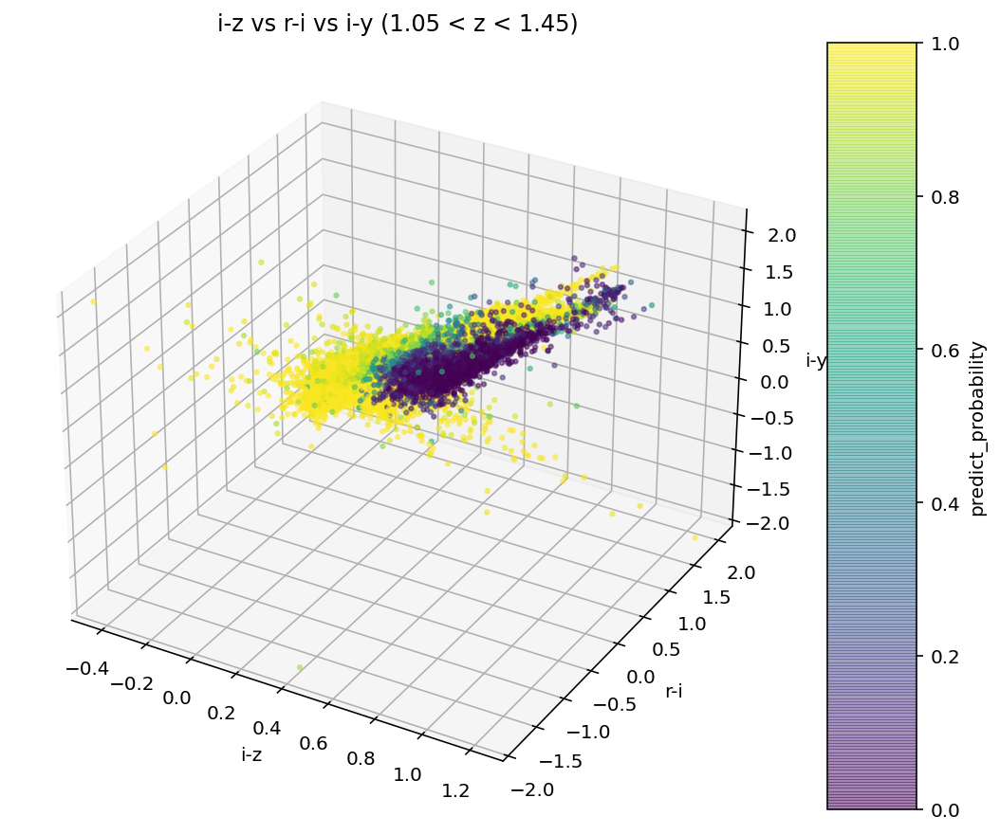

In [32]:
#3D color color plots of i-z vs r-i vs i-y
fig03d = colors_3d(xallb_test['iz'], xallb_test['ri'], xallb_test['iy'], proballb[:, 0], xlim = (-.5, 1.3), ylim = (-2, 2.2), zlim = (-1.7, 1.7), title = 'i-z vs r-i vs i-y (1.05 < z < 1.55)')
fig13d = colors_3d(xalln_test['iz'], xalln_test['ri'], xalln_test['iy'], proballn[:, 0], xlim = (-.5, 1.3), ylim = (-2, 2.2), zlim = (-1.7, 1.7), title = 'i-z vs r-i vs i-y (1.05 < z < 1.45)')

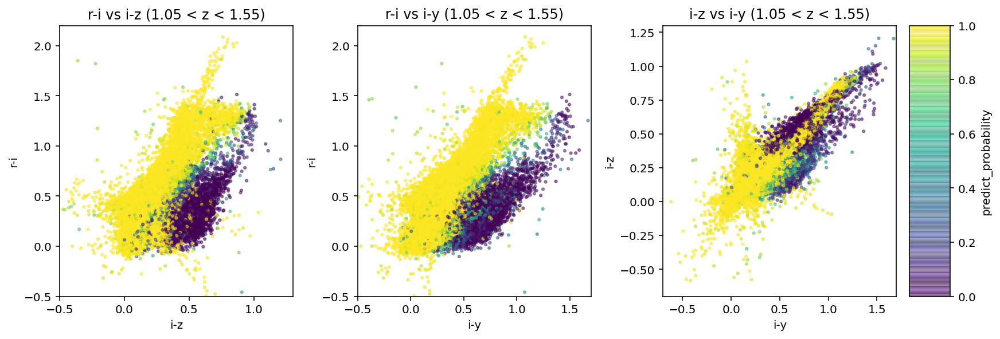

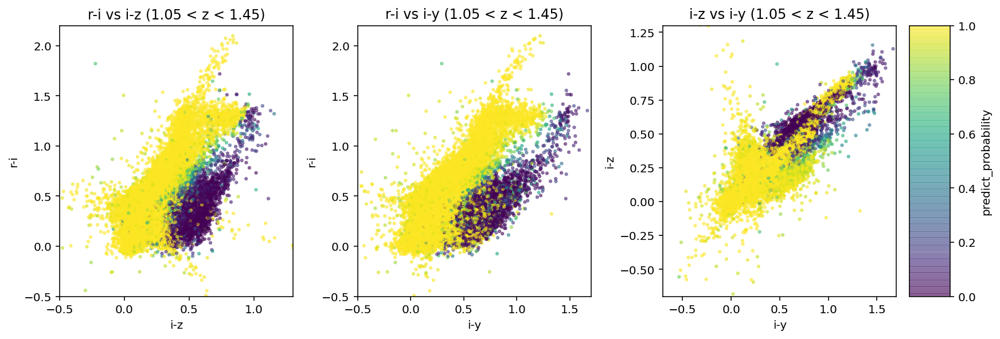

In [19]:
#Broad and narrow band color color plots color coded with predict_proba using all RF (r-i vs i-z), (r-i vs i-y) , (i-z vs i-y)
fig0 = colors(xallb_test['iz'], xallb_test['ri'], xallb_test['iy'], proballb[:, 0], xlim0 = (-.5,1.3), ylim0 = (-.5,2.2), xlim1 = (-.5,1.7), ylim1 = (-.5,2.2), xlim2 = (-.7,1.7), ylim2 = (-.7,1.3), title0 = 'r-i vs i-z (1.05 < z < 1.55)', title1 = 'r-i vs i-y (1.05 < z < 1.55)', title2 = 'i-z vs i-y (1.05 < z < 1.55)')
fig1 = colors(xalln_test['iz'], xalln_test['ri'], xalln_test['iy'], proballn[:, 0], xlim0 = (-.5,1.3), ylim0 = (-.5,2.2), xlim1 = (-.5,1.7), ylim1 = (-.5,2.2), xlim2 = (-.7,1.7), ylim2 = (-.7,1.3))
plt.rcParams['figure.constrained_layout.use'] = True




In [ ]:
'Below we begin to look at histograms of photozs, scatter and density plots of photozs vs gband for objects our model selects 
'and does not select to be within 1.05 < z < 1.45 using all RF AND 3 RF only '

/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


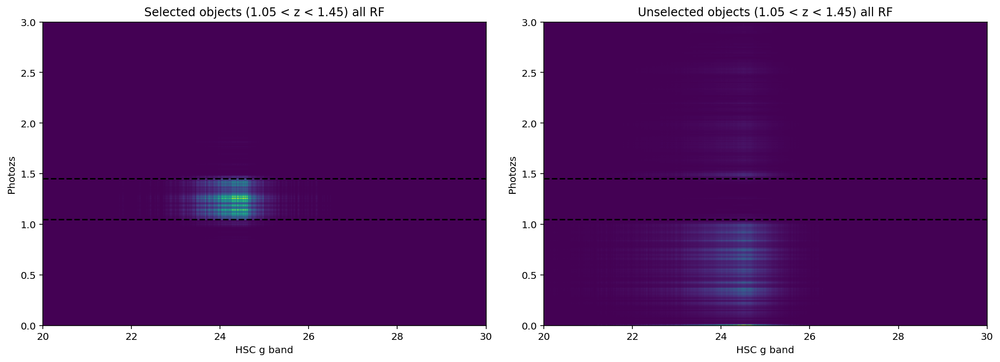

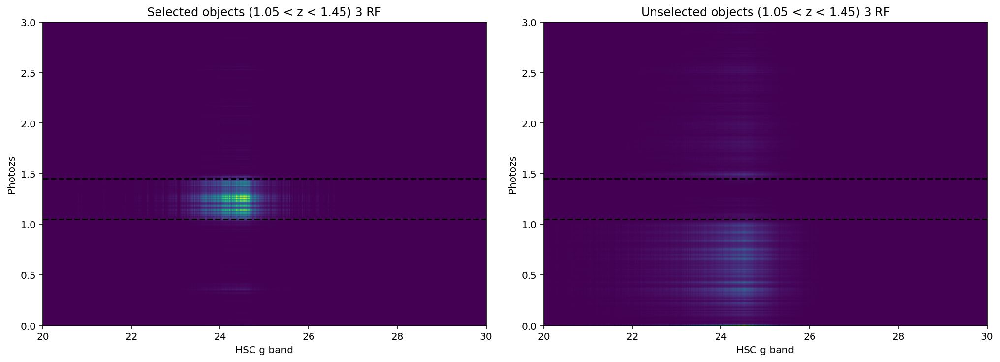

In [20]:
#Selected and not selected photoz vs g band objects(1.05 < z < 1.45) all RF  AND 3 (r-i vs i-z), (r-i vs i-y) , (i-z vs i-y) RF 
fig = scatter_density_g_photoz(galln_test.values, zalln_test, istrue_alln, hlinemin = 1.05, hlinemax = 1.45)
fig1 = scatter_density_g_photoz(g3n_test.values, z3n_test, istrue_3n, hlinemin = 1.05, hlinemax = 1.45, title1 = 'Selected objects (1.05 < z < 1.45) 3 RF', title2 = 'Unselected objects (1.05 < z < 1.45) 3 RF')


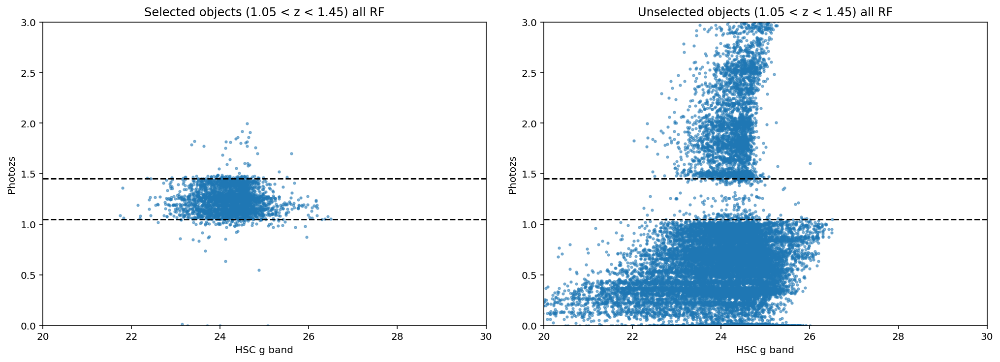

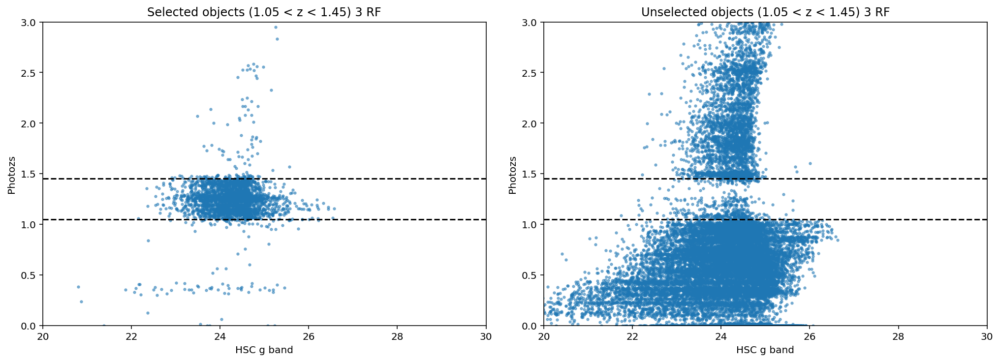

In [21]:
fig = scatter_g_photoz(galln_test.values, zalln_test, istrue_alln, hlinemin = 1.05, hlinemax = 1.45)
fig1 = scatter_g_photoz(g3n_test.values, z3n_test, istrue_3n, hlinemin = 1.05, hlinemax = 1.45, title1 = 'Selected objects (1.05 < z < 1.45) 3 RF', title2 = 'Unselected objects (1.05 < z < 1.45) 3 RF')



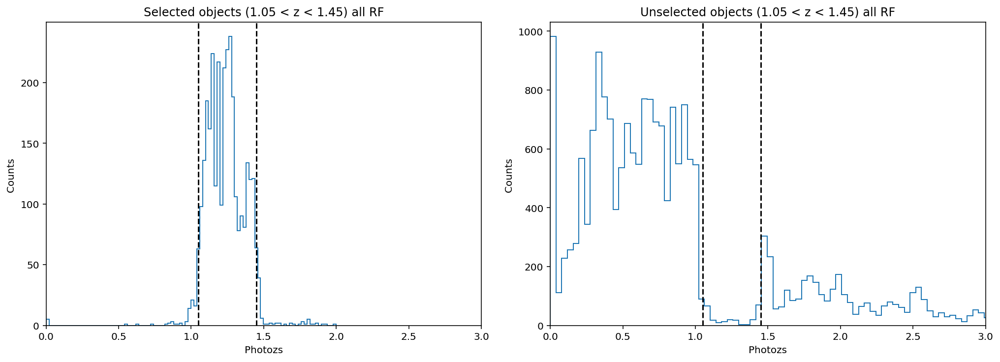

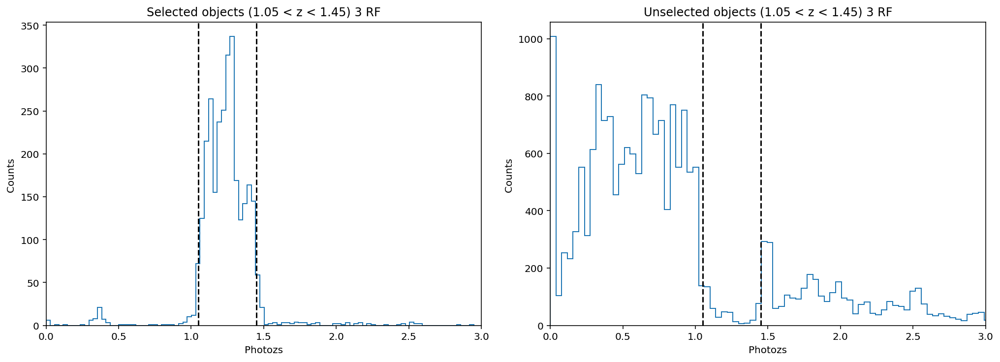

In [24]:

fig = z_hist(zalln_test, istrue_alln, vlinemin = 1.05, vlinemax = 1.45, title1 = 'Selected objects (1.05 < z < 1.45) all RF', title2 = 'Unselected objects (1.05 < z < 1.45) all RF')
fig1 = z_hist(z3n_test, istrue_3n, vlinemin = 1.05, vlinemax = 1.45, title1 = 'Selected objects (1.05 < z < 1.45) 3 RF', title2 = 'Unselected objects (1.05 < z < 1.45) 3 RF')

In [ ]:
'Below we begin to look at histograms of photozs, scatter and density plots of photozs vs gband for objects our model selects 
'and does not select to be within 1.05 < z < 1.55 using all RF AND 3 RF only '

/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning:

All-NaN slice encountered

/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning:

All-NaN slice encountered



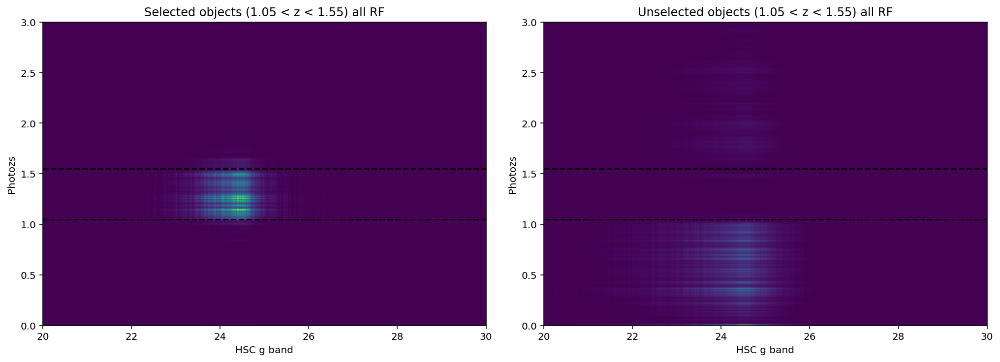

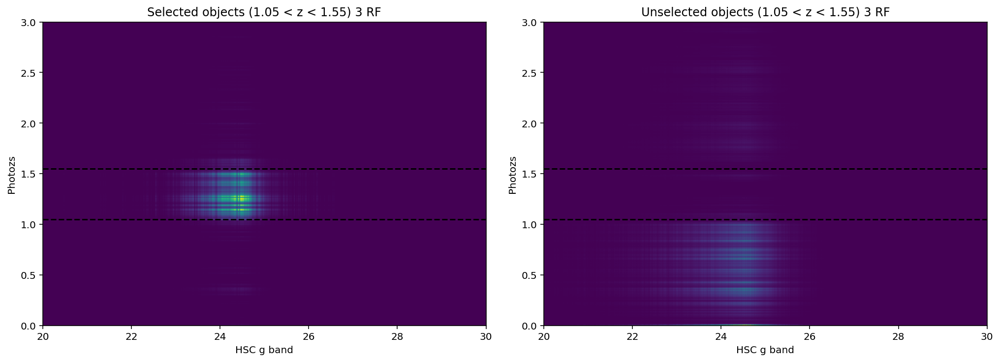

In [28]:
fig = scatter_density_g_photoz(gallb_test.values, zallb_test, istrue_allb, hlinemin = 1.05, hlinemax = 1.55, title1 = 'Selected objects (1.05 < z < 1.55) all RF', title2 = 'Unselected objects (1.05 < z < 1.55) all RF')
fig1 = scatter_density_g_photoz(g3b_test.values, z3b_test, istrue_3b, hlinemin = 1.05, hlinemax = 1.55, title1 = 'Selected objects (1.05 < z < 1.55) 3 RF', title2 = 'Unselected objects (1.05 < z < 1.55) 3 RF')



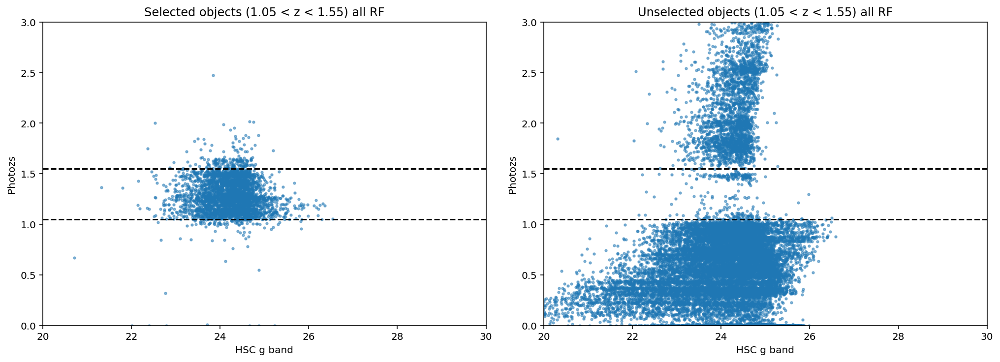

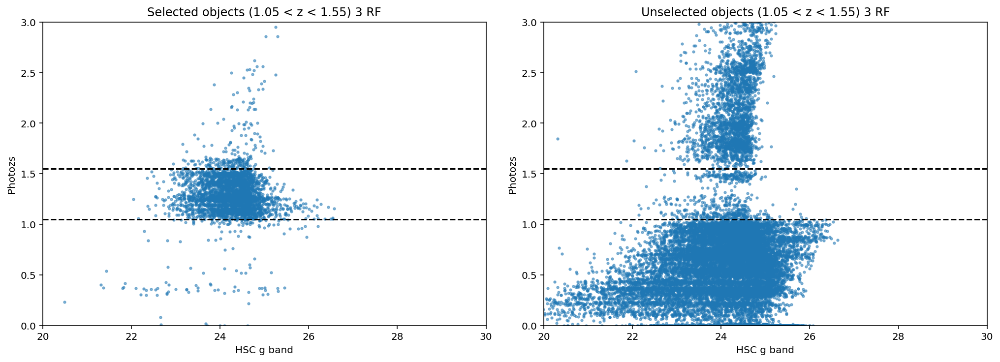

In [29]:
fig = scatter_g_photoz(gallb_test.values, zallb_test, istrue_allb, hlinemin = 1.05, hlinemax = 1.55, title1 = 'Selected objects (1.05 < z < 1.55) all RF', title2 = 'Unselected objects (1.05 < z < 1.55) all RF')
fig1 = scatter_g_photoz(g3b_test.values, z3b_test, istrue_3b, hlinemin = 1.05, hlinemax = 1.55, title1 = 'Selected objects (1.05 < z < 1.55) 3 RF', title2 = 'Unselected objects (1.05 < z < 1.55) 3 RF')




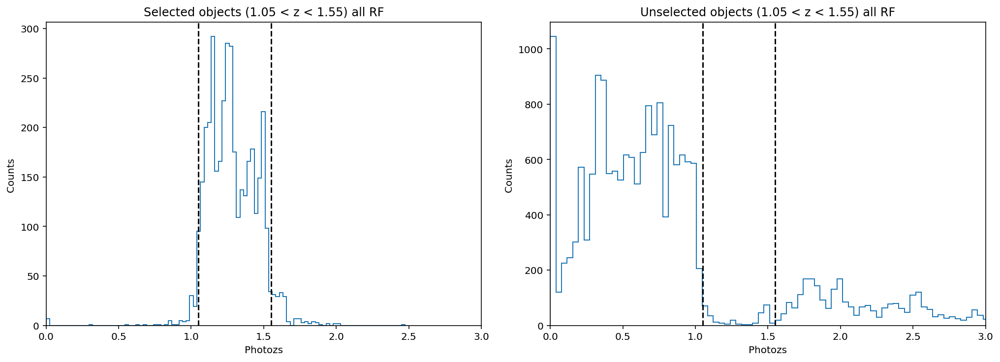

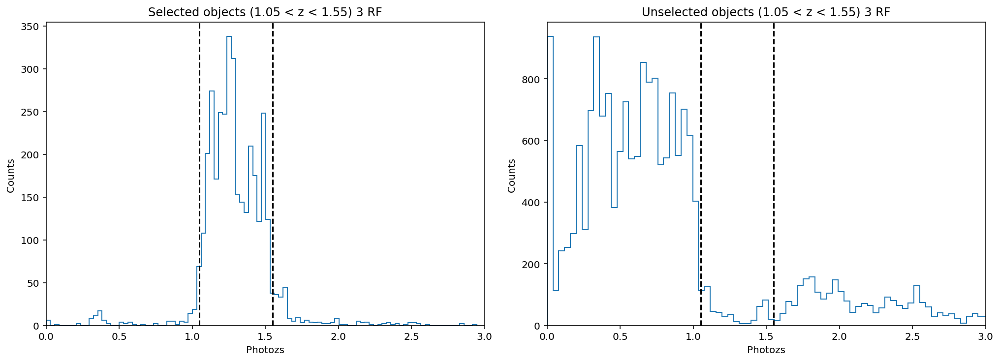

In [31]:
fig = z_hist(zallb_test, istrue_allb, vlinemin = 1.05, vlinemax = 1.55, title1 = 'Selected objects (1.05 < z < 1.55) all RF', title2 = 'Unselected objects (1.05 < z < 1.55) all RF')
fig1 = z_hist(z3b_test, istrue_3b, vlinemin = 1.05, vlinemax = 1.55, title1 = 'Selected objects (1.05 < z < 1.55) 3 RF', title2 = 'Unselected objects (1.05 < z < 1.55) 3 RF')

In [ ]:
#try random forest classifiers for 0.9-1.45, 0.95-1.45, 1-1.45, and 1.05-1.45, in addition to 1-1.5, 1.05-1.55, and 1.1-1.6

In [ ]:
'''Comparing the two Narrow: 1.05 < z < 1.45 and Broad: 1.05 < z < 1.55 ranges, we see below that the model does slightly worse with using only the top 3 features compared to using all features'''

The mean of the permutation importances for 1.05 < photoz < 1.55 are
[ 3.98677117e-04  2.26521089e-03  1.08412993e-02  6.56911158e-04
 -1.72156028e-04  1.44067413e-03  3.79196303e-03  1.81216871e-04
  1.99338558e-04  1.72790287e-02  1.15072713e-03  8.56249717e-04
  2.20223803e-02  7.22692883e-02  1.20056177e-03 -6.34259050e-05
  4.07737960e-05  1.35912653e-05  1.72156028e-04 -2.17460246e-04
 -1.81216871e-05]
The std of the mean of permutation importances for 1.05 < photoz < 1.55 are
[0.00021708 0.00046467 0.00078261 0.00023388 0.00013712 0.00030713
 0.00066461 0.00020159 0.00021746 0.00093445 0.00027721 0.00019481
 0.00083842 0.0009083  0.00028092 0.00026894 0.00017126 0.00010341
 0.00013712 0.00017523 0.00013771]
clf score for 1.05 < photoz < 1.55 is 
0.993408012323166
The balanced accuracy score for 1.05 < photoz < 1.55 is
0.9535228308084214
The recall score for 1.05 < photoz < 1.55 is
0.9228143869782095
The precision score for 1.05 < photoz < 1.55 is
0.9242703129108598
The roc auc s

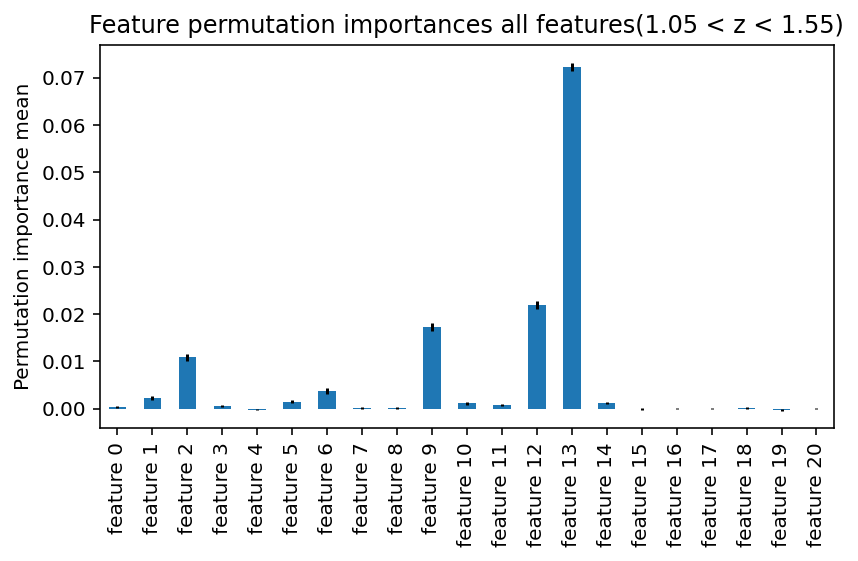

In [29]:
#for 1.05 < photoz < 1.55 (all features)
print("The mean of the permutation importances for 1.05 < photoz < 1.55 are") 
print(mean1) 
print("The std of the mean of permutation importances for 1.05 < photoz < 1.55 are")
print(std1)
#Statistics for  1.05 < photoz < 1.55
print("clf score for 1.05 < photoz < 1.55 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 1.05 < photoz < 1.55 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 1.05 < photoz < 1.55 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 1.05 < photoz < 1.55 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 1.05 < photoz < 1.55 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances all features(1.05 < z < 1.55)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph all features (1.05 < z < 1.55).png',dpi=300)







The mean of the permutation importances for 1.05 < photoz < 1.55 are
[0.15267068 0.06336701 0.1773932 ]
The std of the mean of permutation importances for 1.05 < photoz < 1.55 are
[0.00141875 0.00104181 0.00204514]
clf score for 1.05 < photoz < 1.55 is 
0.9899421218951399
The balanced accuracy score for 1.05 < photoz < 1.55 is
0.9372485004865934
The recall score for 1.05 < photoz < 1.55 is
0.9038785834738617
The precision score for 1.05 < photoz < 1.55 is
0.8553191489361702
The roc auc score for 1.05 < photoz < 1.55 is
0.9372485004865934
[0.00141875 0.00104181 0.00204514]


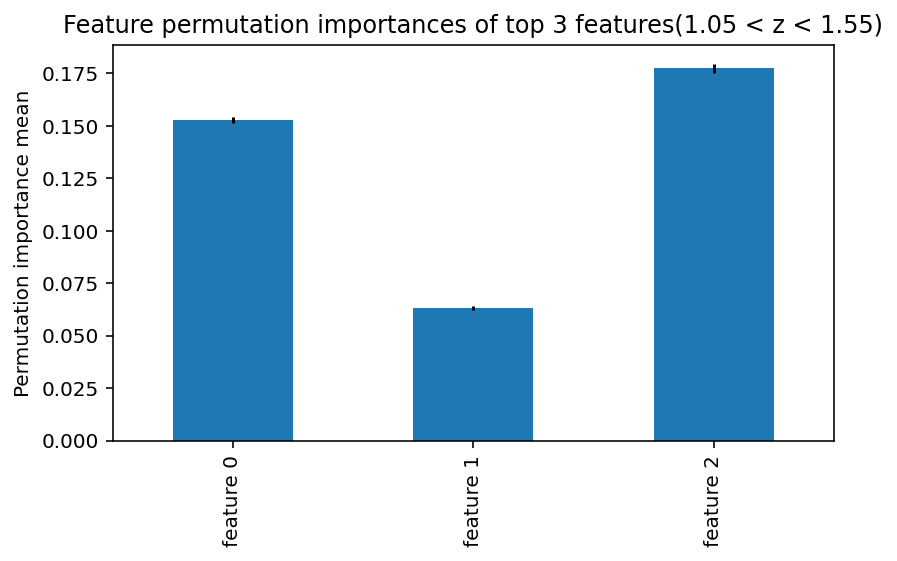

In [24]:
#for 1.05 < photoz < 1.55 (top 3 features of ri, iz, iy)
print("The mean of the permutation importances for 1.05 < photoz < 1.55 are") 
print(mean1) 
print("The std of the mean of permutation importances for 1.05 < photoz < 1.55 are")
print(std1)
#Statistics for  1.05 < photoz < 1.55
print("clf score for 1.05 < photoz < 1.55 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 1.05 < photoz < 1.55 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 1.05 < photoz < 1.55 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 1.05 < photoz < 1.55 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 1.05 < photoz < 1.55 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances of top 3 features(1.05 < z < 1.55)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph of top 3 features(1.05 < z < 1.55)(top 3 features of ri, iz, iy).png',dpi=300)




The mean of the permutation importances for 1.05 < photoz < 1.45 are
[0.13573144 0.09933856 0.07843519]
The std of the mean of permutation importances for 1.05 < photoz < 1.45 are
[0.00066799 0.0010969  0.00116566]
clf score for 1.05 < photoz < 1.45 is 
0.991516496958851
The balanced accuracy score for 1.05 < photoz < 1.45 is
0.9418639331072076
The recall score for 1.05 < photoz < 1.45 is
0.908996179228899
The precision score for 1.05 < photoz < 1.45 is
0.8436492585428755
The roc auc score for 1.05 < photoz < 1.45 is
0.9418639331072076
[0.00066799 0.0010969  0.00116566]


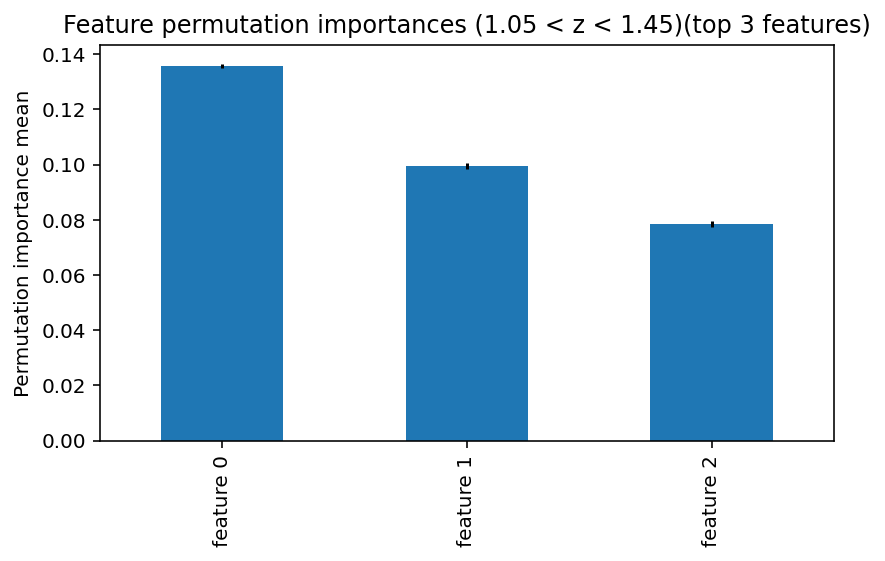

In [13]:
#for 1.05 < photoz < 1.45 (top 3 features of ri, iz, iy)
print("The mean of the permutation importances for 1.05 < photoz < 1.45 are") 
print(mean1) 
print("The std of the mean of permutation importances for 1.05 < photoz < 1.45 are")
print(std1)
#Statistics for  1.05 < photoz < 1.45
print("clf score for 1.05 < photoz < 1.45 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 1.05 < photoz < 1.45 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 1.05 < photoz < 1.45 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 1.05 < photoz < 1.45 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 1.05 < photoz < 1.45 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances of top 3 features(1.05 < z < 1.45)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph of top 3 features (1.05 < z < 1.45)(top 3 features of ri, iz, iy).png',dpi=300)





The mean of the permutation importances for 1.05 < photoz < 1.45 are
[ 2.44709294e-04  1.75828160e-03  3.22200571e-03 -2.53772602e-04
 -2.03924412e-04  1.82172475e-03  2.27489011e-03  2.17519373e-04
 -1.40481262e-04  1.92685911e-02  5.48330086e-04  5.89114968e-05
  7.07028595e-02  5.50641229e-02  1.77187656e-03  1.35949608e-04
  4.53165360e-05 -1.54076222e-04  9.06330720e-06  2.26582680e-05
 -3.17215752e-05]
The std of the mean of permutation importances for 1.05 < photoz < 1.45 are
[2.12746537e-04 2.25492460e-04 2.12987719e-04 1.76908699e-04
 1.47887514e-04 2.67943001e-04 2.56989113e-04 2.07468585e-04
 1.99031960e-04 9.48578046e-04 3.47167258e-04 1.31417954e-04
 1.20217860e-03 1.03147643e-03 2.61465024e-04 1.16420289e-04
 1.28174520e-04 1.36251383e-04 7.25064576e-05 1.37824864e-04
 1.14732305e-04]
clf score for 1.05 < photoz < 1.45 is 
0.9951509658415
The balanced accuracy score for 1.05 < photoz < 1.45 is
0.9640857820532999
The recall score for 1.05 < photoz < 1.45 is
0.9410076530612

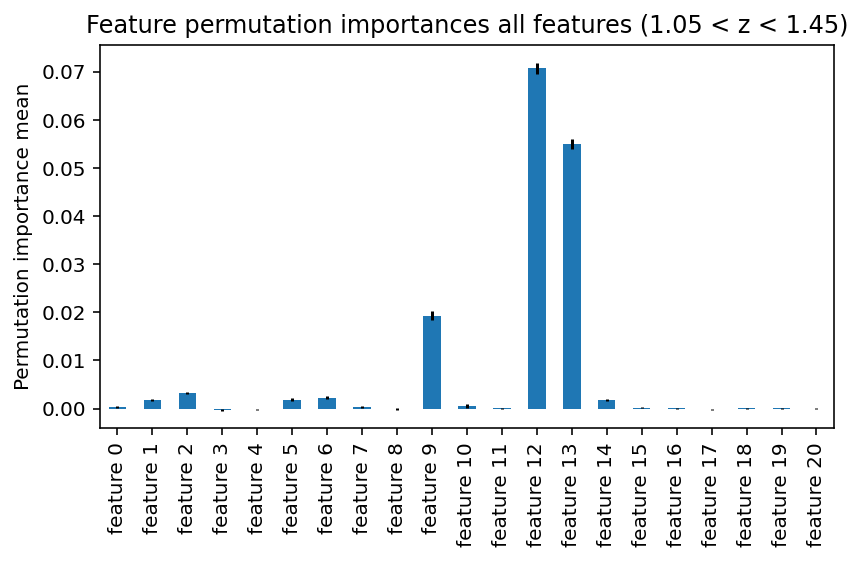

In [36]:
#for 1.05 < photoz < 1.45 (all features)
print("The mean of the permutation importances for 1.05 < photoz < 1.45 are") 
print(mean1) 
print("The std of the mean of permutation importances for 1.05 < photoz < 1.45 are")
print(std1)
#Statistics for  1.05 < photoz < 1.45
print("clf score for 1.05 < photoz < 1.45 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 1.05 < photoz < 1.45 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 1.05 < photoz < 1.45 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 1.05 < photoz < 1.45 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 1.05 < photoz < 1.45 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances all features (1.05 < z < 1.45)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph all features (1.05 < z < 1.45).png',dpi=300)






In [ ]:
#Here I am going to compare the metric scores for the different zbin ranges to decided which range is the best all across the board.
#After doing this I will compare how this particular zbin range does using all the features versus only the most important features

'''The balanced accuracy score for 0.9 < photoz < 1.45 is
0.9530151275680198
The recall score for 0.9 < photoz < 1.45 is
0.9282380396732789
The precision score for 0.9 < photoz < 1.45 is
0.9269761118663818
The roc auc score for 0.9 < photoz < 1.45 is
0.9530151275680196'''

'''The balanced accuracy score for 0.95 < photoz < 1.45 is
0.952661394395887
The recall score for 0.95 < photoz < 1.45 is
0.9259793318913723
The precision score for 0.95 < photoz < 1.45 is
0.9123845607388112
The roc auc score for 0.95 < photoz < 1.45 is
0.952661394395887'''

'''The balanced accuracy score for 1 < photoz < 1.45 is
0.9604894246741355
The recall score for 1 < photoz < 1.45 is
0.9400802752293578
The precision score for 1 < photoz < 1.45 is
0.9023115024766099
The roc auc score for 1 < photoz < 1.45 is
0.9604894246741356'''

'''The balanced accuracy score for 1.05 < photoz < 1.45 is
0.9618500522149726
The recall score for 1.05 < photoz < 1.45 is
0.9362588084561179
The precision score for 1.05 < photoz < 1.45 is
0.9247073710850997
The roc auc score for 1.05 < photoz < 1.45 is
0.9618500522149726'''

'''The balanced accuracy score for 1 < photoz < 1.5 is
0.9527335033059672
The recall score for 1 < photoz < 1.5 is
0.9319114027891715
The precision score for 1 < photoz < 1.5 is
0.8749679075738126
The roc auc score for 1 < photoz < 1.5 is
0.9527335033059672'''


'''The balanced accuracy score for 1.05 < photoz < 1.55 is
0.95645764038363
The recall score for 1.05 < photoz < 1.55 is
0.9295320064550834
The precision score for 1.05 < photoz < 1.55 is
0.9189045466631215
The roc auc score for 1.05 < photoz < 1.55 is
0.9564576403836299'''

#Comparing these by inspection, we identify that the range where the model has the best performance is over 1.05 < photoz < 1.45.
#Now we focus on this range compare how the model does with all features versus only the 3 most important features!

The mean of the permutation importances for 0.9 < photoz < 1.45 are
[ 4.75694287e-03  8.22271553e-03  2.55515789e-03  4.03207539e-04
  7.29397907e-04  2.54609704e-03  1.58564762e-03  2.31051511e-04
  2.71825307e-05  2.23349794e-03  9.99864087e-03  3.75118924e-03
  3.68232682e-02  8.87419019e-02  2.02962896e-03  4.98346396e-05
 -4.53042178e-05  1.35912653e-05  8.15475921e-05 -1.81216871e-04
 -1.81216871e-04]
The std of the mean of permutation importances for 0.9 < photoz < 1.45 are
[0.00047903 0.0005206  0.00038612 0.00025261 0.00015622 0.00027167
 0.00045395 0.00022511 0.00013162 0.00028513 0.00033295 0.00047377
 0.00105449 0.00216503 0.00034728 0.00013508 0.00024565 0.00019333
 0.00015403 0.00026494 0.0001543 ]
clf score for 0.9 < photoz < 1.45 is 
0.9915618027160802
The balanced accuracy score for 0.9 < photoz < 1.45 is
0.9530151275680198
The recall score for 0.9 < photoz < 1.45 is
0.9282380396732789
The precision score for 0.9 < photoz < 1.45 is
0.9269761118663818
The roc auc score 

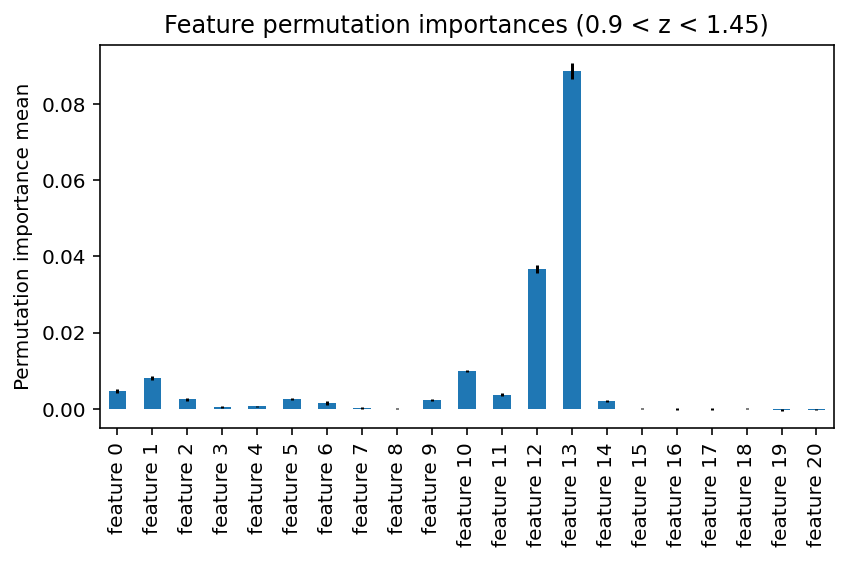

In [20]:
#for 0.9 < photoz < 1.45
print("The mean of the permutation importances for 0.9 < photoz < 1.45 are") 
print(mean1) 
print("The std of the mean of permutation importances for 0.9 < photoz < 1.45 are")
print(std1)
#Statistics for  0.9 < photoz < 1.45
print("clf score for 0.9 < photoz < 1.45 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 0.9 < photoz < 1.45 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 0.9 < photoz < 1.45 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 0.9 < photoz < 1.45 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 0.9 < photoz < 1.45 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances (0.9 < z < 1.45)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph (0.9 < z < 1.45).png',dpi=300)


The mean of the permutation importances for 0.95 < photoz < 1.45 are
[0.00340688 0.00435374 0.0035745  0.00037149 0.00036243 0.00240112
 0.00335704 0.00094233 0.00045304 0.00345218 0.00236035 0.00125946
 0.0464776  0.06481674 0.00263671 0.00017669 0.00023105 0.00024917
 0.0002537  0.0001042  0.00022652]
The std of the mean of permutation importances for 0.95 < photoz < 1.45 are
[0.00058923 0.00043096 0.00041791 0.00022815 0.00023628 0.00034503
 0.00025098 0.00016927 0.00025628 0.00058784 0.00035294 0.00037238
 0.00119734 0.00128012 0.00036906 0.00020103 0.00020001 0.00016366
 0.00025322 0.00022291 0.00021442]
clf score for 0.95 < photoz < 1.45 is 
0.9923206741496675
The balanced accuracy score for 0.95 < photoz < 1.45 is
0.952661394395887
The recall score for 0.95 < photoz < 1.45 is
0.9259793318913723
The precision score for 0.95 < photoz < 1.45 is
0.9123845607388112
The roc auc score for 0.95 < photoz < 1.45 is
0.952661394395887
[0.00058923 0.00043096 0.00041791 0.00022815 0.00023628 

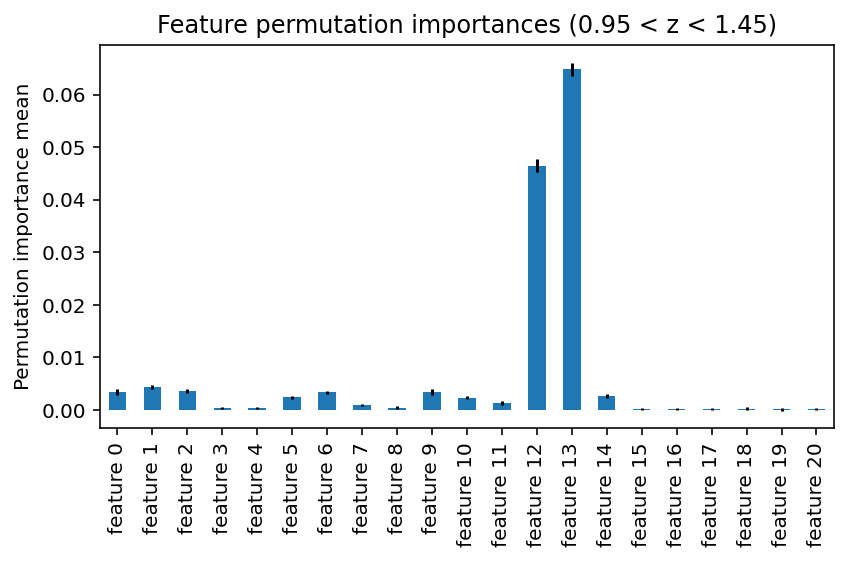

In [28]:
#for 0.95 < photoz < 1.45
print("The mean of the permutation importances for 0.95 < photoz < 1.45 are") 
print(mean1) 
print("The std of the mean of permutation importances for 0.95 < photoz < 1.45 are")
print(std1)
#Statistics for  0.95 < photoz < 1.45
print("clf score for 0.95 < photoz < 1.45 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 0.95 < photoz < 1.45 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 0.95 < photoz < 1.45 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 0.95 < photoz < 1.45 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 0.95 < photoz < 1.45 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances (0.95 < z < 1.45)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph (0.95 < z < 1.45).png',dpi=300)



The mean of the permutation importances for 1 < photoz < 1.45 are
[ 1.01028406e-03  3.55185068e-03  4.35826575e-03  9.06084356e-06
  2.26521089e-05  1.39536991e-03  2.62764463e-03  1.81216871e-05
 -2.40112354e-04  6.05717392e-03  1.17337924e-03  4.93815974e-04
  6.45766321e-02  5.58691614e-02  7.29397907e-04 -1.08730123e-04
 -2.80886151e-04 -1.31382232e-04 -4.43981335e-04 -1.94808137e-04
 -2.26521089e-05]
The std of the mean of permutation importances for 1 < photoz < 1.45 are
[2.31051511e-04 2.83069802e-04 3.65141878e-04 2.60883071e-04
 1.94597305e-04 2.61668628e-04 3.04584539e-04 2.22129310e-04
 2.26566389e-04 4.43449385e-04 2.66063460e-04 2.50159701e-04
 1.15861939e-03 1.93505765e-03 3.22552032e-04 1.59789717e-04
 1.78707769e-04 2.03061975e-04 1.83244221e-04 2.02657267e-04
 9.97721902e-05]
clf score for 1 < photoz < 1.45 is 
0.9936118882306969
The balanced accuracy score for 1 < photoz < 1.45 is
0.9604894246741355
The recall score for 1 < photoz < 1.45 is
0.9400802752293578
The prec

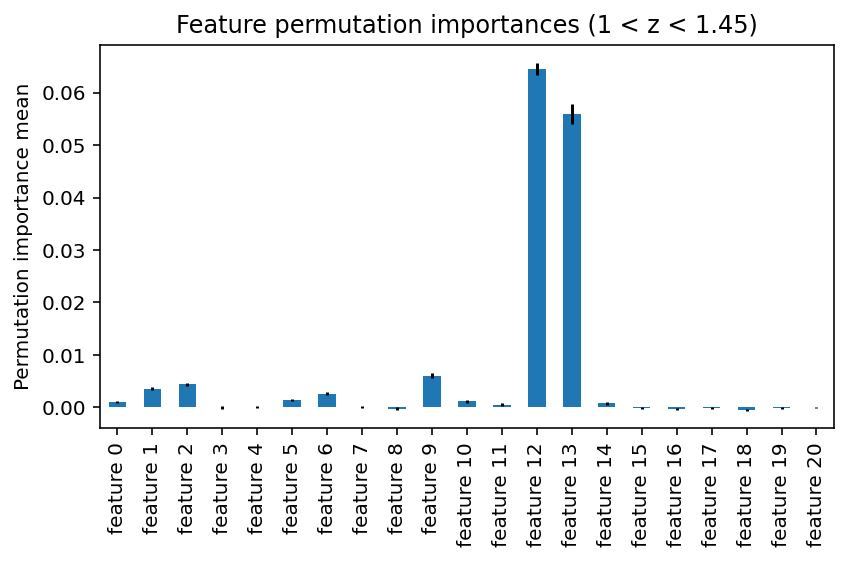

In [35]:
#for 1 < photoz < 1.45
print("The mean of the permutation importances for 1 < photoz < 1.45 are") 
print(mean1) 
print("The std of the mean of permutation importances for 1 < photoz < 1.45 are")
print(std1)
#Statistics for  1 < photoz < 1.45
print("clf score for 1 < photoz < 1.45 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 1 < photoz < 1.45 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 1 < photoz < 1.45 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 1 < photoz < 1.45 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 1 < photoz < 1.45 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances (1 < z < 1.45)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph (1 < z < 1.45).png',dpi=300)




The mean of the permutation importances for 1.05 < photoz < 1.45 are
[ 7.11276220e-04  2.24708920e-03  5.66302723e-03  9.06084356e-05
  5.88954832e-05  1.73968196e-03  3.90069315e-03  1.72156028e-04
 -2.08399402e-04  1.48507226e-02  9.01553935e-04  6.65972002e-04
  6.45539800e-02  4.67947266e-02  1.30929190e-03  8.60780139e-05
 -2.26521089e-04 -9.06084356e-06 -2.44642776e-04 -1.63095184e-04
  8.60780139e-05]
The std of the mean of permutation importances for 1.05 < photoz < 1.45 are
[0.00029012 0.00033427 0.00051176 0.0001543  0.0001419  0.00033672
 0.0003393  0.00015135 0.00016234 0.0006574  0.00025098 0.00034087
 0.0007049  0.00098331 0.00017599 0.00011362 0.00018458 0.00019623
 0.00014066 0.0001392  0.00013044]
clf score for 1.05 < photoz < 1.45 is 
0.9950503460227208
The balanced accuracy score for 1.05 < photoz < 1.45 is
0.9618500522149726
The recall score for 1.05 < photoz < 1.45 is
0.9362588084561179
The precision score for 1.05 < photoz < 1.45 is
0.9247073710850997
The roc auc 

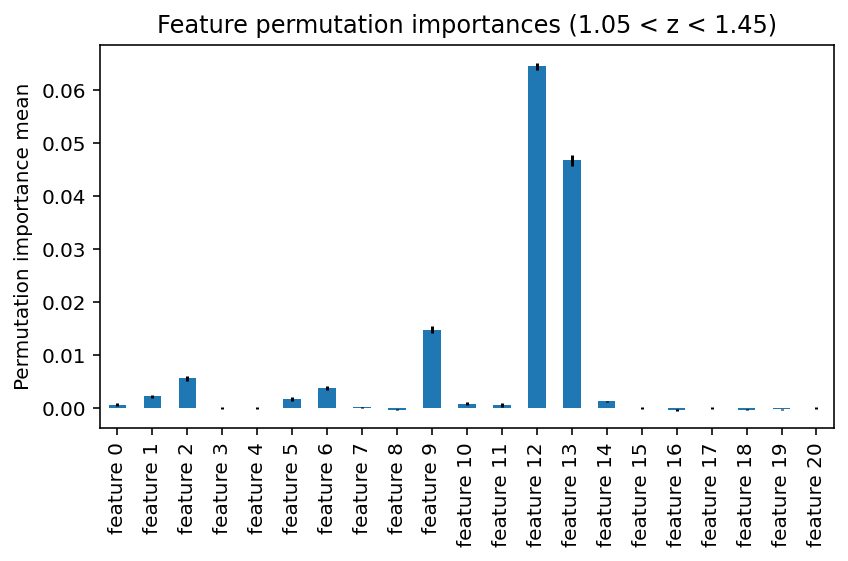

In [39]:
#for 1.05 < photoz < 1.45
print("The mean of the permutation importances for 1.05 < photoz < 1.45 are") 
print(mean1) 
print("The std of the mean of permutation importances for 1.05 < photoz < 1.45 are")
print(std1)
#Statistics for  1.05 < photoz < 1.45
print("clf score for 1.05 < photoz < 1.45 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 1.05 < photoz < 1.45 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 1.05 < photoz < 1.45 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 1.05 < photoz < 1.45 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 1.05 < photoz < 1.45 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances (1.05 < z < 1.45)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph (1.05 < z < 1.45).png',dpi=300)





The mean of the permutation importances for 1 < photoz < 1.5 are
[ 2.02962896e-03  3.66964164e-03  5.26435011e-03  1.14166629e-03
  4.80224709e-04  2.97195669e-03  2.15648077e-03  9.55918996e-04
  4.93815974e-04  8.15022879e-03  2.57327957e-03  1.72156028e-03
  4.15484982e-02  5.91582476e-02  3.45671182e-03  2.67294885e-04
 -3.62433743e-05  1.63095184e-04  5.98015675e-04  5.93485253e-04
  7.24867485e-05]
The std of the mean of permutation importances for 1 < photoz < 1.5 are
[0.00052161 0.00033599 0.00046679 0.00025851 0.00028739 0.00029722
 0.0003287  0.00014673 0.00033381 0.0004631  0.00031505 0.00034503
 0.00091093 0.00153992 0.0003579  0.00020707 0.00013561 0.00020781
 0.00018985 0.00018173 0.00013317]
clf score for 1 < photoz < 1.5 is 
0.9916637406698456
The balanced accuracy score for 1 < photoz < 1.5 is
0.9527335033059672
The recall score for 1 < photoz < 1.5 is
0.9319114027891715
The precision score for 1 < photoz < 1.5 is
0.8749679075738126
The roc auc score for 1 < photoz < 1

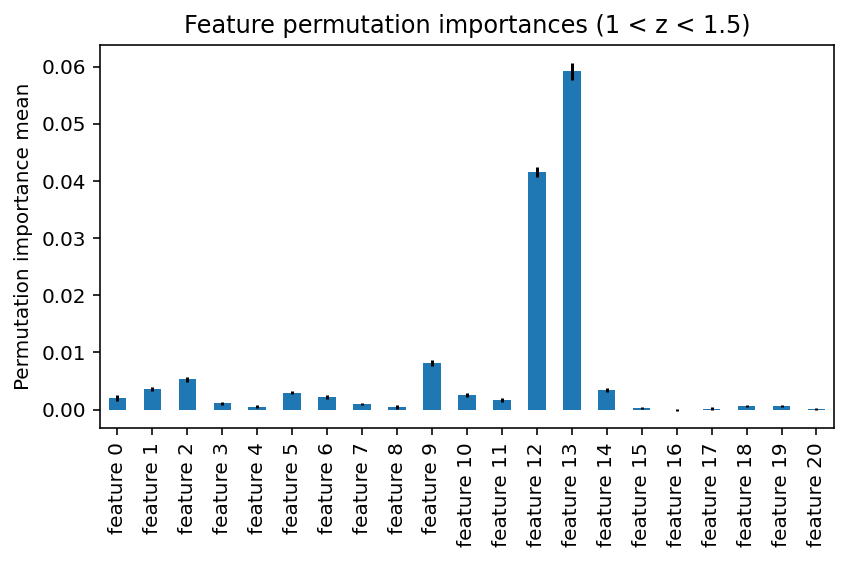

In [47]:
#for 1 < photoz < 1.5
print("The mean of the permutation importances for 1 < photoz < 1.5 are") 
print(mean1) 
print("The std of the mean of permutation importances for 1 < photoz < 1.5 are")
print(std1)
#Statistics for  1 < photoz < 1.5
print("clf score for 1 < photoz < 1.5 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 1 < photoz < 1.5 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 1 < photoz < 1.5 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 1 < photoz < 1.5 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 1 < photoz < 1.5 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances (1 < z < 1.5)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph (1 < z < 1.5).png',dpi=300)





The mean of the permutation importances for 1.05 < photoz < 1.55 are
[1.15072713e-03 2.09305486e-03 3.54278983e-03 3.08068681e-04
 4.16798804e-04 1.94808137e-03 2.40112354e-03 4.03207539e-04
 4.25859648e-04 1.65632220e-02 8.65310560e-04 1.76686450e-03
 3.14773705e-02 6.22434649e-02 3.34798170e-03 1.76686450e-04
 1.17790966e-04 3.17129525e-05 4.07737960e-05 4.62103022e-04
 1.31382232e-04]
The std of the mean of permutation importances for 1.05 < photoz < 1.55 are
[2.39041471e-04 3.10457875e-04 4.04097370e-04 2.01387313e-04
 2.15183112e-04 1.34394029e-04 3.91298380e-04 2.34052306e-04
 2.90936336e-04 6.00071424e-04 2.27831123e-04 2.77800203e-04
 8.18941879e-04 9.49758383e-04 2.85416572e-04 1.92689442e-04
 1.18485904e-04 9.51388574e-05 1.90547192e-04 1.55361104e-04
 2.19573611e-04]
clf score for 1.05 < photoz < 1.55 is 
0.9935665824734679
The balanced accuracy score for 1.05 < photoz < 1.55 is
0.95645764038363
The recall score for 1.05 < photoz < 1.55 is
0.9295320064550834
The precision sc

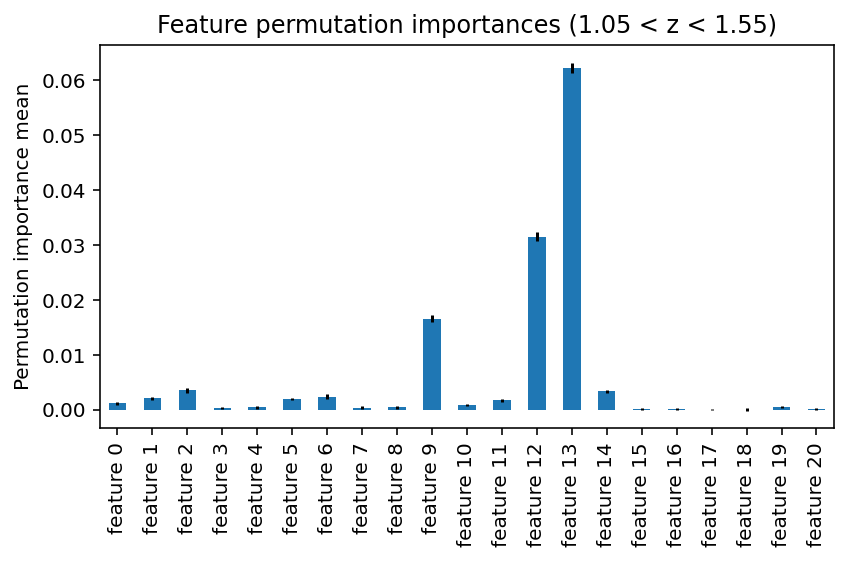

In [55]:
#for 1.05 < photoz < 1.55
print("The mean of the permutation importances for 1.05 < photoz < 1.55 are") 
print(mean1) 
print("The std of the mean of permutation importances for 1.05 < photoz < 1.55 are")
print(std1)
#Statistics for  1.05 < photoz < 1.55
print("clf score for 1.05 < photoz < 1.55 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 1.05 < photoz < 1.55 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 1.05 < photoz < 1.55 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 1.05 < photoz < 1.55 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for 1.05 < photoz < 1.55 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances (1.05 < z < 1.55)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph (1.05 < z < 1.55).png',dpi=300)






The mean of the permutation importances for 1.1 < photoz < 1.6 are
[ 2.31051511e-04  6.43319893e-04  2.45095818e-03 -2.67294885e-04
 -1.72156028e-04  8.92493091e-04  3.14864314e-03  1.13260545e-04
 -1.72156028e-04  3.51152992e-02  6.07076519e-04  3.71494586e-04
  1.94898745e-02  6.09387034e-02  1.64907353e-03 -2.12929824e-04
 -7.70171703e-05 -1.81216871e-04 -2.67294885e-04 -1.58564762e-04
 -2.31051511e-04]
The std of the mean of permutation importances for for 1.1 < photoz < 1.6 are
[0.00020103 0.00020741 0.00043758 0.00012563 0.00010291 0.00022383
 0.00031339 0.00018037 0.00027092 0.00111589 0.00036983 0.00022724
 0.00060809 0.00129073 0.00035742 0.0001092  0.00017435 0.00014326
 0.00013808 0.00017102 0.00017126]
clf score for for 1.1 < photoz < 1.6 is 
0.9938044376989206
The balanced accuracy score for 1.1 < photoz < 1.6 is
0.9548711638872767
The recall score for 1.1 < photoz < 1.6 is
0.9253949678174371
The precision score for 1.1 < photoz < 1.6 is
0.9154848046309696
The roc auc scor

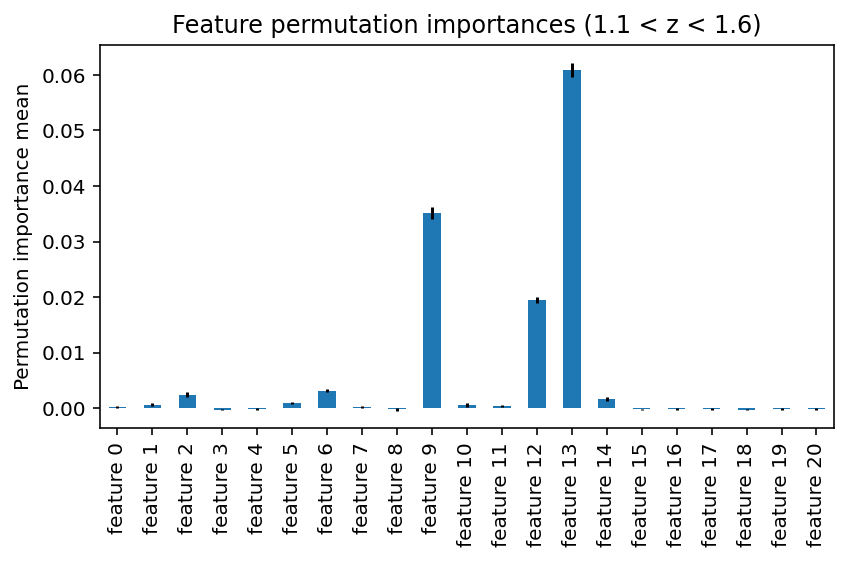

In [62]:
#for 1.1 < photoz < 1.6
print("The mean of the permutation importances for 1.1 < photoz < 1.6 are") 
print(mean1) 
print("The std of the mean of permutation importances for for 1.1 < photoz < 1.6 are")
print(std1)
#Statistics for  1.1 < photoz < 1.6
print("clf score for for 1.1 < photoz < 1.6 is ")
print(clf1.score(x1, y1, sample_weight=None))
print("The balanced accuracy score for 1.1 < photoz < 1.6 is")
print(balanced_accuracy_score(clf1.predict(x1_test), y1_test))
print("The recall score for 1.1 < photoz < 1.6 is")
print(recall_score(clf1.predict(x1_test), y1_test))
print("The precision score for 1.1 < photoz < 1.6 is")
print(precision_score(clf1.predict(x1_test), y1_test))
print("The roc auc score for for 1.1 < photoz < 1.6 is")
print(roc_auc_score(clf1.predict(x1_test), y1_test))

feature_names1 = [f"feature {i}" for i in range(x1.shape[1])]
permutation_importances = pd.Series(mean1, index=feature_names1)

fig, ax = plt.subplots()
permutation_importances.plot.bar(yerr=std1, ax=ax)
ax.set_title("Feature permutation importances (1.1 < z < 1.6)")
ax.set_ylabel("Permutation importance mean")
fig.tight_layout()
print(std1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/Permutation importance bar graph (1.1 < z < 1.6).png',dpi=300)







In [71]:
#The model for each zbin was ran 2 times and results were very consistent on feature permutation means
#Conclusion on runs for zbins: The most important features have consistently been 9, 12, and 13 throughout different zbins.
#These correspond to the features of #r-i, i-z, i-y.

## Introduction: the COSMOS2020 catalogue in two complementary versions

There are two versions of the COSMOS2020 catalogue: a *Classic* one where the photometry is produced by a pipeline similar to Laigle et al. (2016), and the *Farmer* version that relies on the software *Tractor* recently developed by Lang & Hogg (http://thetractor.org/). Respective file names are:

1. COSMOS2020_CLASSIC_R1_v2.0.fits
2. COSMOS2020_FARMER_R1_v2.0.fits

Both tables come with additional information from SED fitting anlaysis (photometric redshifts, stellar masses, etc.) and a `*.header` ASCII file explaining the content of each column. Depending on the version some column may have a slightly different name. Please note that SED fitting was performed twice, with eather *LePhare* or *EAZY* code. Therefore, there are four possible combinations to do science: *Farmer* + *LePhare*, *Farmer* + *EAZY*, etc. 

These and many more input parameters are specified in the present section.

In [3]:
# Specify the version of the catalog and the folder with the input/output files
catversion = 'Farmer'  # this string can be either 'Classic' or 'Farmer'
dir_in = '/Users/yokisalcedo/Cosmos2020repo/data/processed/'  
dir_out = '/Users/yokisalcedo/Cosmos2020repo/models/' # the directory where the output of this notebook will be stored
# Upload the main catalogue
cat = table.Table.read(dir_in+'COSMOS2020_{}_jan_processed.fits'.format(catversion),format='fits',hdu=1)

In [37]:
# Chose the SED fitting code: 
# set to 'lp' for LePhare results or
# set to 'ez' for EAZY
fitversion = 'lp'  

In [4]:
# Which type of photometric estimates to use? (suffix of the column name)
# This choice must be consistent with `catversion`,
# choices for Classic are: '_FLUX_APER2', '_FLUX_APER3', '_MAG_APER2,', '_MAG_APER3'
# choices for Farmer are '_FLUX' or '_MAG' 
flx = '_FLUX'  
flxerr = '_FLUXERR'  # catalog column for flux/mag error, just add 'ERR'
outflx = 'cgs' # 'cgs' or 'uJy'

There are several pararemeters regarding the telescope filters used for observations. They are collectively stored in a dictionary. 

In [38]:
# Filter names, mean wavelength, and other info (see Table 1 in W+21)
filt_name = ['GALEX_FUV', 'GALEX_NUV','CFHT_u','CFHT_ustar','HSC_g', 'HSC_r', 'HSC_i', 'HSC_z', 'HSC_y', 'UVISTA_Y', 'UVISTA_J', 'UVISTA_H', 'UVISTA_Ks', 
             'SC_IB427', 'SC_IB464', 'SC_IA484', 'SC_IB505', 'SC_IA527', 'SC_IB574', 'SC_IA624', 'SC_IA679',
             'SC_IB709', 'SC_IA738', 'SC_IA767', 'SC_IB827', 'SC_NB711', 'SC_NB816', 'UVISTA_NB118',
             'SC_B', 'SC_gp', 'SC_V', 'SC_rp', 'SC_ip','SC_zp', 'SC_zpp', 'IRAC_CH1', 'IRAC_CH2', 'IRAC_CH3','IRAC_CH4']  
filt_lambda = [0.1526,0.2307,0.3709,0.3858,0.4847,0.6219,0.7699,0.8894,0.9761,1.0216,1.2525,1.6466,2.1557,0.4266,0.4635,0.4851,0.5064,0.5261,0.5766,0.6232,0.6780,0.7073,0.7361,0.7694,0.8243,0.7121,0.8150,1.1909,0.4488,0.4804,0.5487,0.6305,0.7693,0.8978,0.9063,3.5686,4.5067,5.7788,7.9958]
filt_fwhm = [0.0224,0.07909,0.05181,0.05976,0.1383,0.1547,0.1471,0.0766,0.0786,0.0923,0.1718,0.2905,0.3074,0.02073,0.02182,0.02292,0.0231,0.02429,0.02729,0.03004,0.03363,0.03163,0.03235,0.03648,0.0343,0.0072,0.01198,0.01122,0.0892,0.1265,0.0954,0.1376,0.1497,0.0847,0.1335,0.7443,1.0119,1.4082,2.8796] 
# corresponding MW attenuation from Schelgel 
AlambdaDivEBV = [8.31,8.742,4.807,4.674,3.69,2.715,2.0,1.515,1.298,1.213,0.874,0.565,0.365,4.261,3.844,3.622,3.425,3.265,2.938,2.694,2.431,2.29,2.151,1.997,1.748,2.268,1.787,0.946,4.041,3.738,3.128,2.673,2.003,1.436,1.466,0.163,0.112,0.075,0.045]
# photometric offsets (not available for all filters, see Table 3 in W+21)
zpoff1 = [0.000,-0.352,-0.077,-0.023,0.073,0.101,0.038,0.036,0.086,0.054,0.017,-0.045,0.000,-0.104,-0.044,-0.021,-0.018,-0.045,-0.084,0.005,0.166,-0.023,-0.034,-0.032,-0.069,-0.010,-0.064,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,-0.212,-0.219,0.000,0.000]  # Farmer+LePhare
zpoff2 = [0.000,-0.029,-0.006,0.053,0.128,0.127,0.094,0.084,0.100,0.049,0.025,-0.044,0.000,-0.013,-0.008,0.022,0.025,0.033,-0.032,0.031,0.208,-0.009,0.003,-0.015,-0.001,0.023,-0.021,-0.017,-0.075,0.000,0.123,0.035,0.051,0.000,0.095,-0.087,-0.111,0.000,0.000]  # Classic+LePhare
zpoff3 = [0.000,0.000,-0.196,-0.054,0.006,0.090,0.043,0.071,0.118,0.078,0.047,-0.034,0.000,-0.199,-0.129,-0.084,-0.073,-0.087,-0.124,0.004,0.154,-0.022,-0.030,-0.013,-0.057,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,-0.102,-0.044,0.000,0.000] # Farmer+EAZY
zpoff4 = [0.000,0.000,0.000,-0.021,0.055,0.124,0.121,0.121,0.145,0.085,0.057,-0.036,0.000,-0.133,-0.098,-0.046,-0.037,-0.038,-0.062,0.038,0.214,0.024,0.022,0.01,0.022,0.000,0.000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.021,0.025,0.000,0.000] # Classic+EAZY
# create the dictionary
filt_dict = {filt_name[i]:(filt_lambda[i]*1e4,filt_fwhm[i]*1e4,AlambdaDivEBV[i],[zpoff1[i],zpoff2[i],zpoff3[i],zpoff4[i]]) for i in range(len(filt_name))}

--------------------
## Data preparation

This section includes corrections due to Milky Way foreground extinction, photometric offsets, and flux loss in case of aperture photometry. Here, a subsample of the catalogue (either by rows or columns) can also be selected, and the table re-formatted to be saved as a different file.

In [2]:
# Upload the main catalogue
cat = table.Table.read(dir_in+'COSMOS2020_{}_jan_processed.fits'.format(catversion),format='fits',hdu=1)

NameError: name 'dir_in' is not defined

----------------------- 
## Visualization of the catalogue's main features

We start with printing some stats. The main photoz column (e.g., `lp_zBEST` now renamed `photoz`) tells which class the object belongs to:
- $z=$ for stars (classification criteria described in Sect. TBD of W+21)
- $0<z\leq10$ for galaxies
- $z=99$ for AGN (with the actual redshift stored in the `lp_zq` column)

In [15]:
#a[start:stop]  # items start through stop-1
#a[start:]      # items start through the rest of the array
#a[:stop]       # items from the beginning through stop-1
#a[:]           # a copy of the whole array
#a[start:stop:step] # start through not past stop, by step
cat[0:4:2]

ID,RA,DEC,FLAG_HSC,FLAG_SUPCAM,EBV_MW,CFHT_u_FLUX,CFHT_u_FLUXERR,CFHT_ustar_FLUX,CFHT_ustar_FLUXERR,HSC_g_FLUX,HSC_g_FLUXERR,HSC_r_FLUX,HSC_r_FLUXERR,HSC_i_FLUX,HSC_i_FLUXERR,HSC_z_FLUX,HSC_z_FLUXERR,HSC_y_FLUX,HSC_y_FLUXERR,UVISTA_Y_FLUX,UVISTA_Y_FLUXERR,UVISTA_J_FLUX,UVISTA_J_FLUXERR,UVISTA_H_FLUX,UVISTA_H_FLUXERR,UVISTA_Ks_FLUX,UVISTA_Ks_FLUXERR,IRAC_CH1_FLUX,IRAC_CH1_FLUXERR,IRAC_CH2_FLUX,IRAC_CH2_FLUXERR,photoz,lp_type,lp_zPDF_l68,lp_zPDF_u68,lp_zMinChi2,lp_chi2_best,lp_zp_2,lp_chi2_2,lp_zq,lp_chiq,lp_chis,lp_mask,lp_model,lp_age,lp_dust,lp_Attenuation,lp_MU,lp_MG,lp_MR,lp_MJ,lp_mass_med,lp_mass_med_min68,lp_mass_med_max68,lp_mass_best,lp_SFR_med,lp_SFR_med_min68,lp_SFR_med_max68,lp_SFR_best,ez_z_phot,ez_z_phot_chi2,ez_z_phot_risk,ez_z_min_risk,ez_min_risk,ez_z025,ez_z160,ez_z500,ez_z840,ez_z975,ez_star_min_chi2,ez_restU,ez_restB,ez_restV,ez_restJ,ez_mass,ez_sfr,ez_LHa,ez_LOII,ez_Av,ez_lwAgeV,ez_mass_p160,ez_mass_p840,ez_sfr_p160,ez_sfr_p840,ez_LOII_p160,ez_LOII_p840,ez_ssfr_p160,ez_ssfr_p500,ez_ssfr_p840,CFHT_ustar_MAG,CFHT_u_MAG,HSC_g_MAG,HSC_r_MAG,HSC_i_MAG,HSC_z_MAG,HSC_y_MAG,UVISTA_Y_MAG,UVISTA_J_MAG,UVISTA_H_MAG,UVISTA_Ks_MAG,IRAC_CH1_MAG,IRAC_CH2_MAG
,deg,deg,,,,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,,,,,,,,,,,,,,,,,mag,mag,mag,mag,,,,,,,,,,,,,,,,,,,,uJy,uJy,uJy,uJy,,,solLum,solLum,mag,Gyr,solMass,solMass,solMass / yr,solMass / yr,solLum,solLum,1 / yr,1 / yr,1 / yr,,,,,,,,,,,,,
int64,float64,float64,int16,int16,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,150.47759181348482,2.3289280599580477,0,0,0.01465764190485742,1.5252260316610877e-30,4.1863488283601616e-32,1.5536189913397627e-30,3.566769095834382e-32,1.4174373484865035e-30,3.4682673072330925e-32,1.5153990810882991e-30,4.804885971761918e-32,1.4633022174080137e-30,4.5610206599078234e-32,1.6146652966034725e-30,6.886879564422908e-32,2.0202876142579984e-30,1.512743701028521e-31,2.184533700198253e-30,1.0935296985526243e-31,3.4549102825715356e-30,1.2955112496925438e-31,3.911804487833673e-30,1.6259644938874592e-31,3.2536508304140975e-30,2.16464934093371e-31,2.433137139315819e-30,1.2499986182277433e-31,3.9747878027788734e-30,1.0825896424508906e-31,1.593,0,1.514,1.6732,1.581,1.8967115384615385,nan,nan,2.21,4.9497307692307695,10.968444444444446,0.0,10,508800000.0,0.1,0,-18.58492,-19.16556,-19.28665,-18.82977,8.5707,8.4769,8.72267,8.52185,0.1587,-0.17138,0.26124,0.2347,1.5981634,226.50162,0.004000952,1.5985415,0.004009182,1.547226,1.5752951,1.5965912,1.6176264,1.652233,1150.471,0.18273404,0.26975456,0.31889814,0.26588404,8.930507970884136,-0.16172483687841568,57953991.22018559,46568549.76439913,0.03846124223190879,0.4302562381923336,813050442.7427151,891693755.3555163,0.676109559834417,0.7070195529363686,45691212.24827505,47780435.10709193,7.644313929987373e-10,8.14331767978337e-10,8.632032971719754e-10,25.921638696538725,25.94166447763064,26.021240320166857,25.948682451087866,25.98666492324113,25.879793721881637,25.636466996688497,25.551603127904173,25.05390806485616,24.919057148499974,25.119072639377556,25.434583530416873,24.9017151

In [ ]:
nsrc = len(cat)
print('This catalogue has',nsrc,'sources: ')
print(' - unreliable/corrupted ones = ',np.count_nonzero(cat['lp_type']<0.))
print(' - photometric stars = ',np.count_nonzero(cat['lp_type']==1))
print(' - photometric galaxies = ',np.count_nonzero(cat['lp_type']==0))
print(' -- plus other {} objects that are classified as X-ray AGN'.format(np.count_nonzero(cat['lp_type']==2))) 
print('\nThis catalogue has',len(cat.columns),'columns')
zmin = min(cat['photoz'][cat['photoz']>0.])  
zmax = max(cat['photoz'][cat['photoz']<99.])  
print('Redshift range {:.2f}<zphot<{:.2f}'.format(zmin,zmax))
ramin = min(cat['RA']); ramax = max(cat['RA'])
decmin = min(cat['DEC']); decmax = max(cat['DEC'])
print('Area covered [deg]: {:.6f}<RA<{:.6f} & {:.6f}<Dec<{:.6f}'.format(ramin,ramax,decmin,decmax))


A quick sky projection 

In [ ]:
# Select a random subsample for sake of clarity
a = np.random.randint(0,nsrc,size=100000)
plt.scatter(cat['RA'][a],cat['DEC'][a],color='k',s=0.4,alpha=0.1
        )
plt.xlim(ramax,ramin)
plt.ylim(decmin,decmax)
plt.xlabel('Right Ascension[°]')
plt.ylabel('Declination[°]')
plt.show()

Redshift distributions and GzK diagram.
`lp_zp_2` is the secondary photoz solution in LePhare.
`lp_zq` is the photoz solution in LePhare using QSO/AGN templates. 

In [8]:

colormask = np.logical_and(np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(cat['HSC_z_MAG']))
from functools import reduce

total_mask = reduce(np.logical_and,colormask,sel)

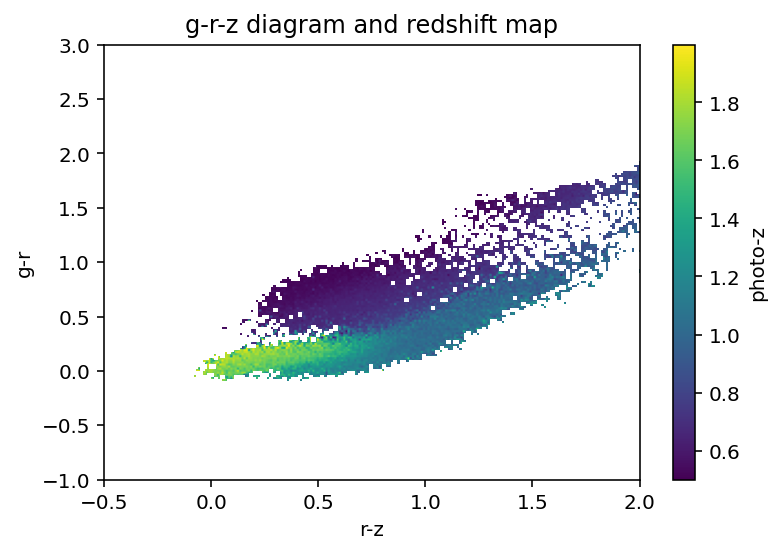

In [27]:
colormask = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(cat['HSC_z_MAG'])))
color1 = cat['HSC_r_MAG'] - cat['HSC_z_MAG']
color2 = cat['HSC_g_MAG'] - cat['HSC_r_MAG']
zmap = cat['ez_z_phot']
sel = np.logical_and.reduce(((cat['ez_z_phot']>=0.5),(cat['ez_z_phot']<2.),(cat['HSC_r_MAG']<24.5)))
color1mask= np.logical_and(color1>-1,color1<4)
color2mask= np.logical_and(color2>-1,color2<3)
total_mask = np.logical_and.reduce((colormask,sel,color1mask,color2mask))

fig = plt.figure()
ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
sd=ax.scatter_density(color1[total_mask],color2[total_mask],c=zmap[total_mask],cmap='viridis')
ax.set_xlim(-0.5,2)
ax.set_ylim(-1,3)
ax.set_xlabel('r-z')
ax.set_ylabel('g-r')
ax.set_title('g-r-z diagram and redshift map')
cbar=fig.colorbar(sd)
cbar.set_label('photo-z')

/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


ID,RA,DEC,FLAG_HSC,FLAG_SUPCAM,EBV_MW,CFHT_u_FLUX,CFHT_u_FLUXERR,CFHT_ustar_FLUX,CFHT_ustar_FLUXERR,HSC_g_FLUX,HSC_g_FLUXERR,HSC_r_FLUX,HSC_r_FLUXERR,HSC_i_FLUX,HSC_i_FLUXERR,HSC_z_FLUX,HSC_z_FLUXERR,HSC_y_FLUX,HSC_y_FLUXERR,UVISTA_Y_FLUX,UVISTA_Y_FLUXERR,UVISTA_J_FLUX,UVISTA_J_FLUXERR,UVISTA_H_FLUX,UVISTA_H_FLUXERR,UVISTA_Ks_FLUX,UVISTA_Ks_FLUXERR,IRAC_CH1_FLUX,IRAC_CH1_FLUXERR,IRAC_CH2_FLUX,IRAC_CH2_FLUXERR,photoz,lp_type,lp_zPDF_l68,lp_zPDF_u68,lp_zMinChi2,lp_chi2_best,lp_zp_2,lp_chi2_2,lp_zq,lp_chiq,lp_chis,lp_mask,lp_model,lp_age,lp_dust,lp_Attenuation,lp_MU,lp_MG,lp_MR,lp_MJ,lp_mass_med,lp_mass_med_min68,lp_mass_med_max68,lp_mass_best,lp_SFR_med,lp_SFR_med_min68,lp_SFR_med_max68,lp_SFR_best,ez_z_phot,ez_z_phot_chi2,ez_z_phot_risk,ez_z_min_risk,ez_min_risk,ez_z025,ez_z160,ez_z500,ez_z840,ez_z975,ez_star_min_chi2,ez_restU,ez_restB,ez_restV,ez_restJ,ez_mass,ez_sfr,ez_LHa,ez_LOII,ez_Av,ez_lwAgeV,ez_mass_p160,ez_mass_p840,ez_sfr_p160,ez_sfr_p840,ez_LOII_p160,ez_LOII_p840,ez_ssfr_p160,ez_ssfr_p500,ez_ssfr_p840,CFHT_ustar_MAG,CFHT_u_MAG,HSC_g_MAG,HSC_r_MAG,HSC_i_MAG,HSC_z_MAG,HSC_y_MAG,UVISTA_Y_MAG,UVISTA_J_MAG,UVISTA_H_MAG,UVISTA_Ks_MAG,IRAC_CH1_MAG,IRAC_CH2_MAG
,deg,deg,,,,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,erg / cm2,,,,,,,,,,,,,,,,,mag,mag,mag,mag,,,,,,,,,,,,,,,,,,,,uJy,uJy,uJy,uJy,,,solLum,solLum,mag,Gyr,solMass,solMass,solMass / yr,solMass / yr,solLum,solLum,1 / yr,1 / yr,1 / yr,,,,,,,,,,,,,
int64,float64,float64,int16,int16,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float32,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
1,150.47759181348482,2.3289280599580477,0,0,0.01465764190485742,1.5252260316610877e-30,4.1863488283601616e-32,1.5536189913397627e-30,3.566769095834382e-32,1.4174373484865035e-30,3.4682673072330925e-32,1.5153990810882991e-30,4.804885971761918e-32,1.4633022174080137e-30,4.5610206599078234e-32,1.6146652966034725e-30,6.886879564422908e-32,2.0202876142579984e-30,1.512743701028521e-31,2.184533700198253e-30,1.0935296985526243e-31,3.4549102825715356e-30,1.2955112496925438e-31,3.911804487833673e-30,1.6259644938874592e-31,3.2536508304140975e-30,2.16464934093371e-31,2.433137139315819e-30,1.2499986182277433e-31,3.9747878027788734e-30,1.0825896424508906e-31,1.593,0,1.514,1.6732,1.581,1.8967115384615385,nan,nan,2.21,4.9497307692307695,10.968444444444446,0.0,10,508800000.0,0.1,0,-18.58492,-19.16556,-19.28665,-18.82977,8.5707,8.4769,8.72267,8.52185,0.1587,-0.17138,0.26124,0.2347,1.5981634,226.50162,0.004000952,1.5985415,0.004009182,1.547226,1.5752951,1.5965912,1.6176264,1.652233,1150.471,0.18273404,0.26975456,0.31889814,0.26588404,8.930507970884136,-0.16172483687841568,57953991.22018559,46568549.76439913,0.03846124223190879,0.4302562381923336,813050442.7427151,891693755.3555163,0.676109559834417,0.7070195529363686,45691212.24827505,47780435.10709193,7.644313929987373e-10,8.14331767978337e-10,8.632032971719754e-10,25.921638696538725,25.94166447763064,26.021240320166857,25.948682451087866,25.98666492324113,25.879793721881637,25.636466996688497,25.551603127904173,25.05390806485616,24.919057148499974,25.119072639377556,25.434583530416873,24.9017151

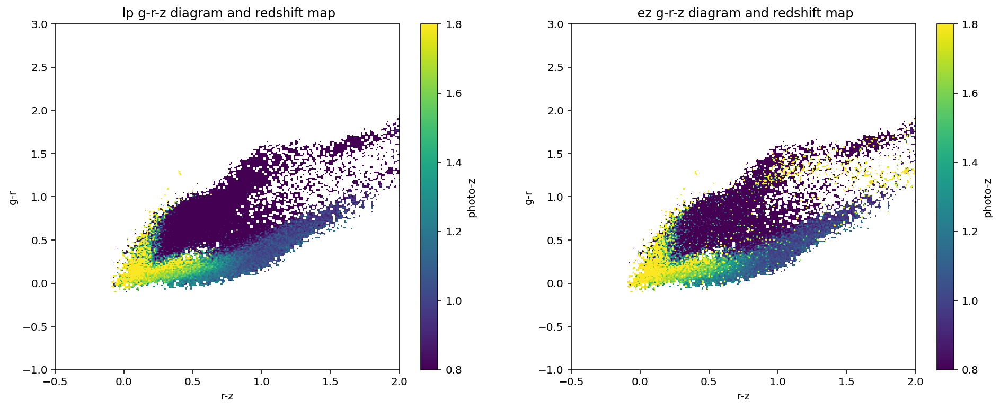

In [7]:

colormask = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(cat['HSC_z_MAG'])))
color1 = cat['HSC_r_MAG'] - cat['HSC_z_MAG']
color2 = cat['HSC_g_MAG'] - cat['HSC_r_MAG']
zmap = cat['photoz']
zmapez = cat['ez_z_phot']
sel =np.logical_and.reduce((np.isfinite(cat['photoz']),np.isfinite(cat['ez_z_phot']),(cat['HSC_r_MAG']<24.5))) 
color1mask= np.logical_and(color1>-1,color1<4)
color2mask= np.logical_and(color2>-1,color2<3)
total_mask = np.logical_and.reduce((colormask,sel,color1mask,color2mask))

fig, (ax0, ax1) = plt.subplots(figsize= (16,6),ncols=2, subplot_kw=dict(projection='scatter_density'))
sd=ax0.scatter_density(color1[total_mask],color2[total_mask],c=zmap[total_mask],cmap='viridis', vmax= 1.8,vmin=.8)
ax0.set_xlim(-0.5,2)
ax0.set_ylim(-1,3)
ax0.set_xlabel('r-z')
ax0.set_ylabel('g-r')
ax0.set_title(' lp g-r-z diagram and redshift map')
cbar=fig.colorbar(sd,ax=ax0)
cbar.set_label('photo-z')
sd=ax1.scatter_density(color1[total_mask],color2[total_mask],c=zmapez[total_mask],cmap='viridis',vmax= 1.8, vmin=.8)
ax1.set_xlim(-0.5,2)
ax1.set_ylim(-1,3)
ax1.set_xlabel('r-z')
ax1.set_ylabel('g-r')
ax1.set_title(' ez g-r-z diagram and redshift map')

cbar=fig.colorbar(sd,ax=ax1)
cbar.set_label('photo-z')
cat[0:6]

<ipython-input-14-30d41a924416>:8: RuntimeWarning: invalid value encountered in log10
  chi2diff= np.log10(cat['ez_star_min_chi2'] - cat['ez_z_phot_chi2'])


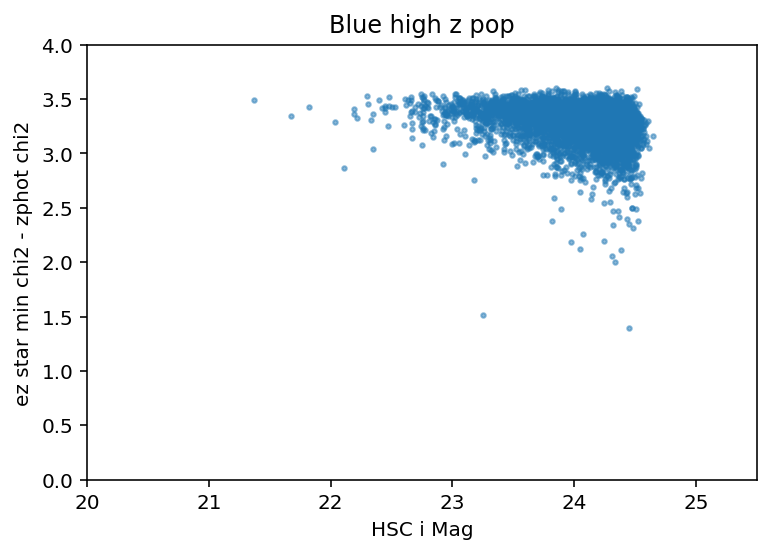

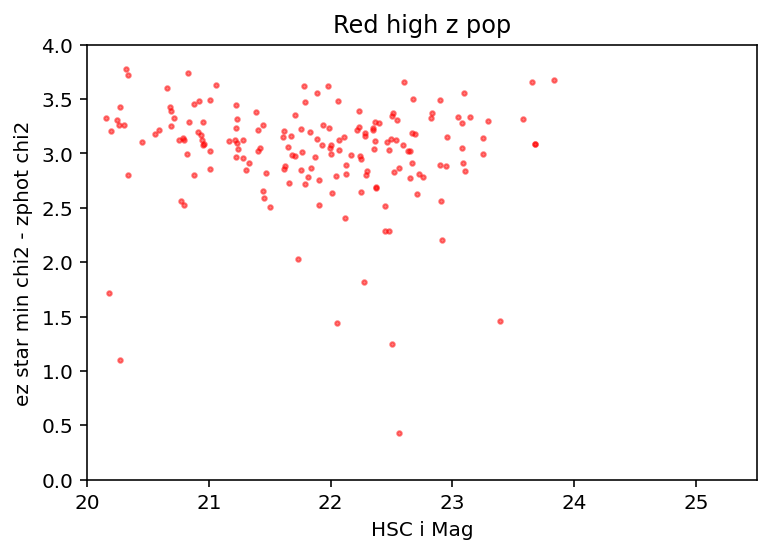

In [14]:
#For the blue population in the cc figures above we are interested in the g-r<1/2 and r-z<1/4 regions with z>1.6
#For the red population we are interested interested in the r-z>1 region with z>1.6
'''chi2 difference vs i Mag scatter plots for blue and red populations '''
rz = cat['HSC_r_MAG'] - cat['HSC_z_MAG']
gr = cat['HSC_g_MAG'] - cat['HSC_r_MAG']
colormaskblue = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(cat['photoz']),np.isfinite(cat['ez_z_phot']),np.isfinite(rz),np.isfinite(gr),np.isfinite(cat['HSC_z_MAG']),cat['HSC_r_MAG']<24.5,cat['ez_z_phot']>1.6,rz<.25,gr<.50))
colormaskred = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(rz),np.isfinite(gr),np.isfinite(cat['HSC_z_MAG']),cat['HSC_r_MAG']<24.5,cat['ez_z_phot']>1.6,rz>1,gr>1))
chi2diff= np.log10(cat['ez_star_min_chi2'] - cat['ez_z_phot_chi2'])
chi2mask=np.logical_and.reduce((np.isfinite(chi2diff),np.isfinite(cat['HSC_i_MAG']), cat['HSC_i_MAG']<25.5)) 
total_maskblue = np.logical_and.reduce((colormaskblue,chi2mask))
total_maskred = np.logical_and.reduce((colormaskred,chi2mask))

bluepop= scatter(cat['HSC_i_MAG'][total_maskblue], chi2diff[total_maskblue], xlabel='HSC i Mag', ylabel='ez star min chi2 - zphot chi2',xlim=(20,25.5),ylim=(0,4), title='Blue high z pop', s=5, alpha=.5)
redpop = scatter(cat['HSC_i_MAG'][total_maskred], chi2diff[total_maskred], xlabel='HSC i Mag', ylabel='ez star min chi2 - zphot chi2',xlim=(20,25.5),ylim=(0,4), title='Red high z pop', color= 'red', s=5, alpha=.5) 

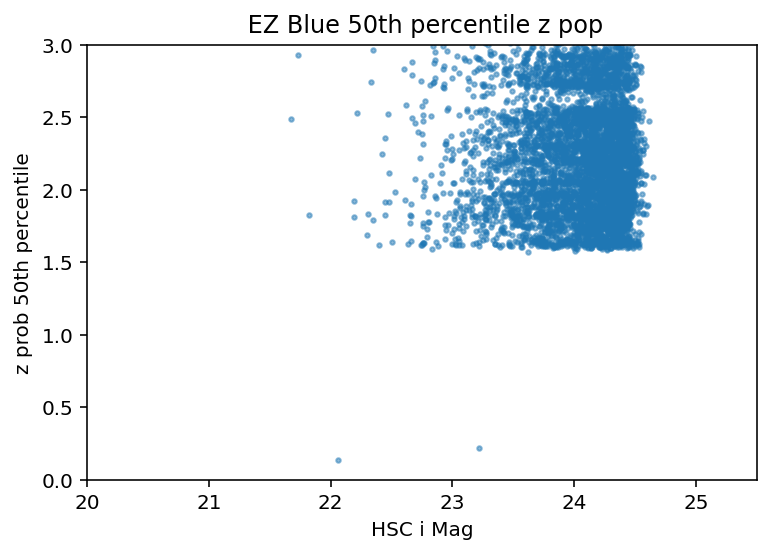

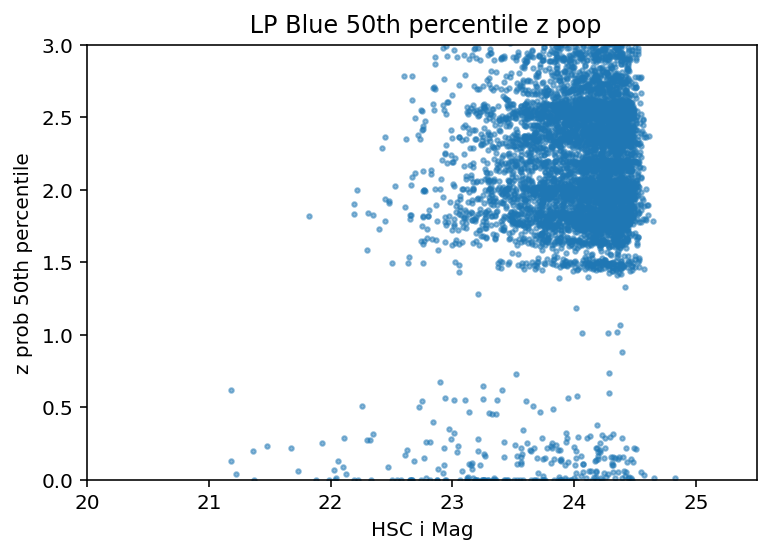

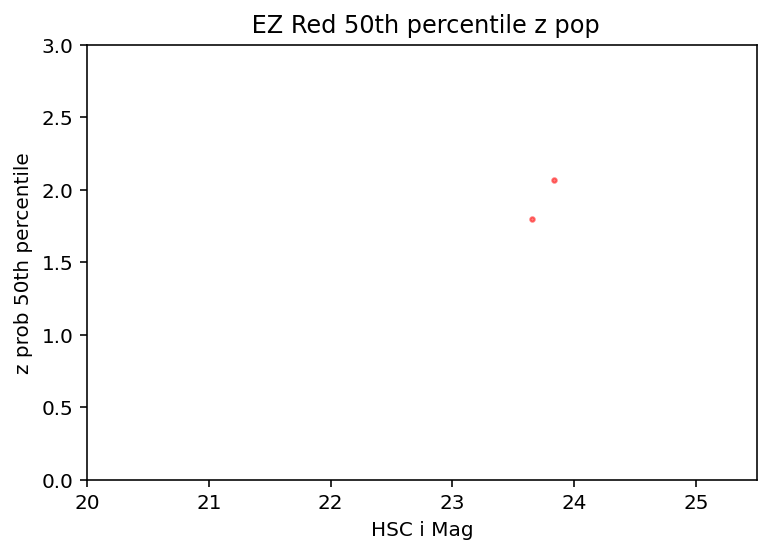

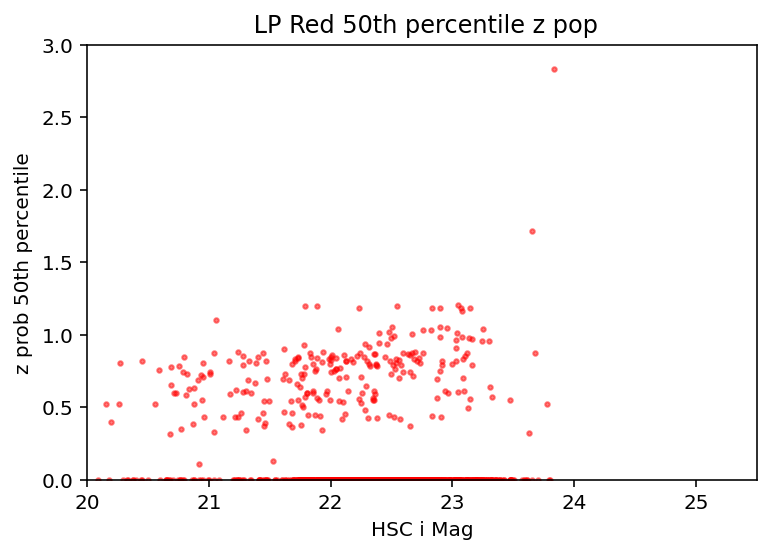

In [22]:
#For the blue population in the cc figures above we are interested in the g-r<1/2 and r-z<1/4 regions with z>1.6
#For the red population we are interested interested in the r-z>1 region with z>1.6
'''both ez and lp z prob 50th percentile distribution vs i Mag scatter plots for blue and red populations'''
zprob50= cat['ez_z500'] 
lpzprob =cat['photoz']
rz = cat['HSC_r_MAG'] - cat['HSC_z_MAG']
gr = cat['HSC_g_MAG'] - cat['HSC_r_MAG']
#colormaskblue = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(rz),np.isfinite(gr),np.isfinite(cat['HSC_z_MAG']),cat['photoz']>1.6,cat['ez_z_phot']>1.6,rz<.25,gr<.50))
#colormaskred = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(rz),np.isfinite(gr),np.isfinite(cat['HSC_z_MAG']),cat['photoz']>1.6,cat['ez_z_phot']>1.6,rz>1)) 
maskprob50ez=np.logical_and.reduce((np.isfinite(zprob50),np.isfinite(cat['HSC_i_MAG']), cat['HSC_i_MAG']<25.5))
masklp = np.logical_and.reduce((np.isfinite(lpzprob),np.isfinite(cat['HSC_i_MAG']), cat['HSC_i_MAG']<25.5))

total_maskezblue = np.logical_and.reduce((colormaskblue,maskprob50ez))
total_maskezred = np.logical_and.reduce((colormaskred,maskprob50ez))
total_masklpblue = np.logical_and.reduce((colormaskblue,masklp))
total_masklpred = np.logical_and.reduce((colormaskred,masklp))




blueez50= scatter(cat['HSC_i_MAG'][total_maskezblue], zprob50[total_maskezblue], xlabel='HSC i Mag', ylabel='z prob 50th percentile',xlim=(20,25.5),ylim=(0,3), title=' EZ Blue 50th percentile z pop', s=5, alpha=.5)
bluelp50= scatter(cat['HSC_i_MAG'][total_masklpblue], lpzprob[total_masklpblue], xlabel='HSC i Mag', ylabel='z prob 50th percentile',xlim=(20,25.5),ylim=(0,3), title=' LP Blue 50th percentile z pop', s=5, alpha=.5)
redez50= scatter(cat['HSC_i_MAG'][total_maskezred], zprob50[total_maskezred], xlabel='HSC i Mag', ylabel='z prob 50th percentile',xlim=(20,25.5),ylim=(0,3), title=' EZ Red 50th percentile z pop', color= 'red', s=5, alpha=.5)
redlp50= scatter(cat['HSC_i_MAG'][total_masklpred], lpzprob[total_masklpred], xlabel='HSC i Mag', ylabel='z prob 50th percentile',xlim=(20,25.5),ylim=(0,3
                                                                                                        ), title=' LP Red 50th percentile z pop', color= 'red', s=5, alpha=.5) 
a,b,c = plt.hist(zprob50[total_maskezred], bins=50)
plt.show()

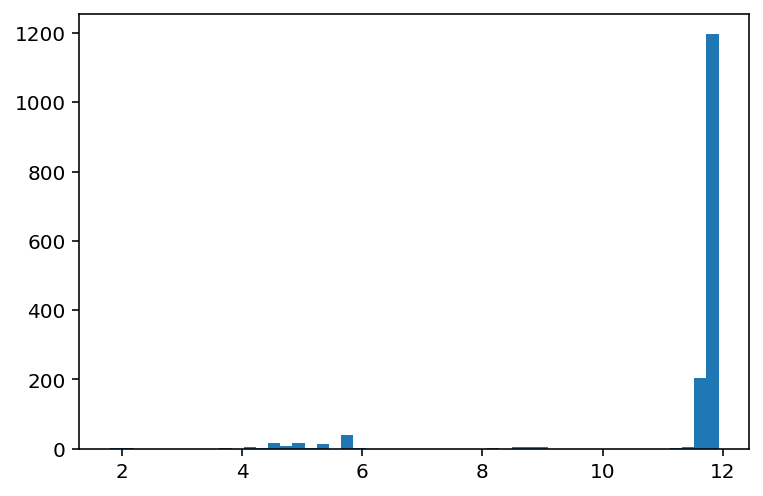

In [23]:
a,b,c = plt.hist(zprob50[total_maskezred], bins=50)
plt.show()

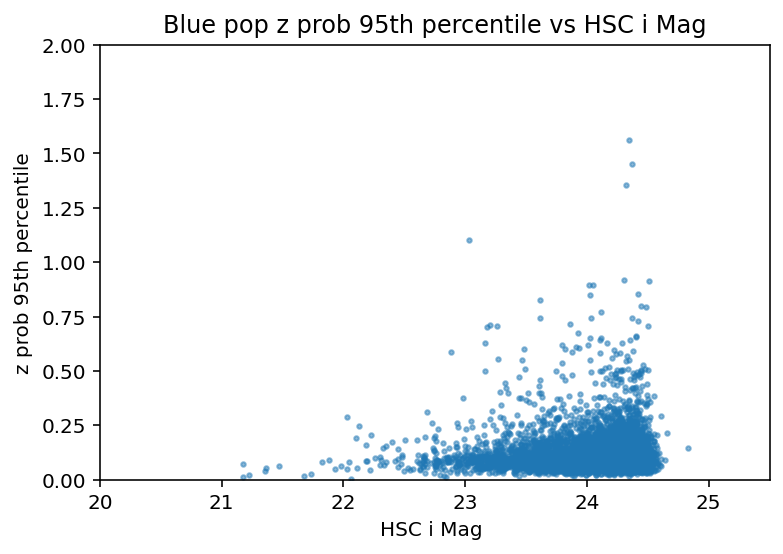

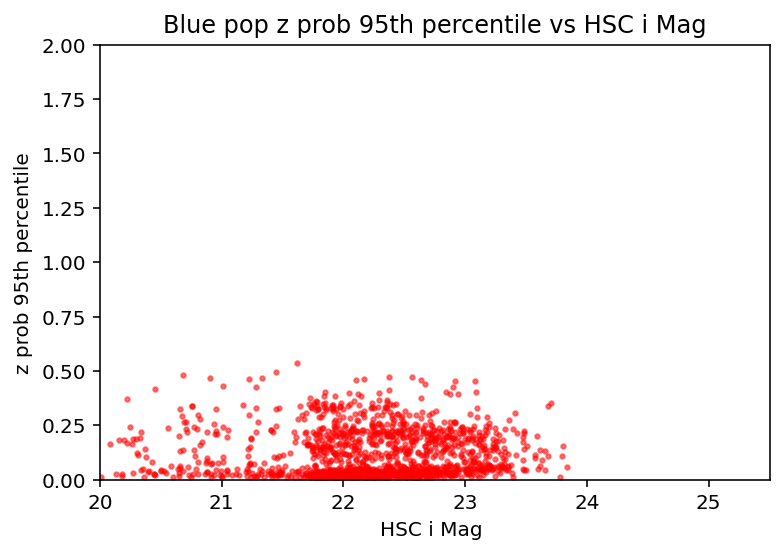

In [19]:
#For the blue population in the cc figures above we are interested in the g-r<1/2 and r-z<1/4 regions with z>1.6
#For the red population we are interested interested in the r-z>1 region with z>1.6
'''ez 95th percentile z prob distribution vs i Mag scatter plots for blue and red populations'''
zprob95= cat['ez_z975'] - cat['ez_z025']
rz = cat['HSC_r_MAG'] - cat['HSC_z_MAG']
gr = cat['HSC_g_MAG'] - cat['HSC_r_MAG']
#colormaskblue = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(rz),np.isfinite(gr),np.isfinite(cat['HSC_z_MAG']),cat['photoz']>1.6,cat['ez_z_phot']>1.6,rz<.25,gr<.50))
#colormaskred = np.logical_and.reduce((np.isfinite(cat['HSC_r_MAG']),np.isfinite(cat['HSC_g_MAG']),np.isfinite(rz),np.isfinite(gr),np.isfinite(cat['HSC_z_MAG']),cat['photoz']>1.6,cat['ez_z_phot']>1.6,rz>1)) 
maskprob95ez=np.logical_and.reduce((np.isfinite(zprob95),np.isfinite(cat['HSC_i_MAG']), cat['HSC_i_MAG']<25.5))


total_maskezblue = np.logical_and.reduce((colormaskblue,maskprob95ez))
total_maskezred = np.logical_and.reduce((colormaskred,maskprob95ez))


blueez95= scatter(cat['HSC_i_MAG'][total_maskezblue], zprob95[total_maskezblue], xlabel='HSC i Mag ', ylabel='z prob 95th percentile', ylim=(0,2),xlim=(20,25.5),title='Blue pop z prob 95th percentile vs HSC i Mag',  s=5, alpha=.5)
redez95= scatter(cat['HSC_i_MAG'][total_maskezred], zprob95[total_maskezred], xlabel='HSC i Mag ', ylabel='z prob 95th percentile', ylim=(0,2),xlim=(20,25.5),title='Blue pop z prob 95th percentile vs HSC i Mag', color= 'red', s=5, alpha=.5)

In [13]:
ug = cat['CFHT_u_MAG'] - cat['HSC_g_MAG'] 
gr = cat['HSC_g_MAG'] - cat['HSC_r_MAG']
ri = cat['HSC_r_MAG'] - cat['HSC_i_MAG']
iz = cat['HSC_i_MAG'] - cat['HSC_z_MAG']
zy = cat['HSC_z_MAG'] - cat['HSC_y_MAG']
rz = cat['HSC_r_MAG'] - cat['HSC_z_MAG']
ur = cat['CFHT_u_MAG'] - cat['HSC_r_MAG']
iy = cat['HSC_i_MAG'] - cat['HSC_y_MAG']


In [ ]:
'''try plotting g-r vs i-z (in z bins, with vertical and horizontal reference lines at 0 color) as well as (r-i) vs (i-z)
6:04
r-z looks pretty good too, try g-r vs r-z, u-r vs r-z, and i-y vs r-z (in z bins)'''

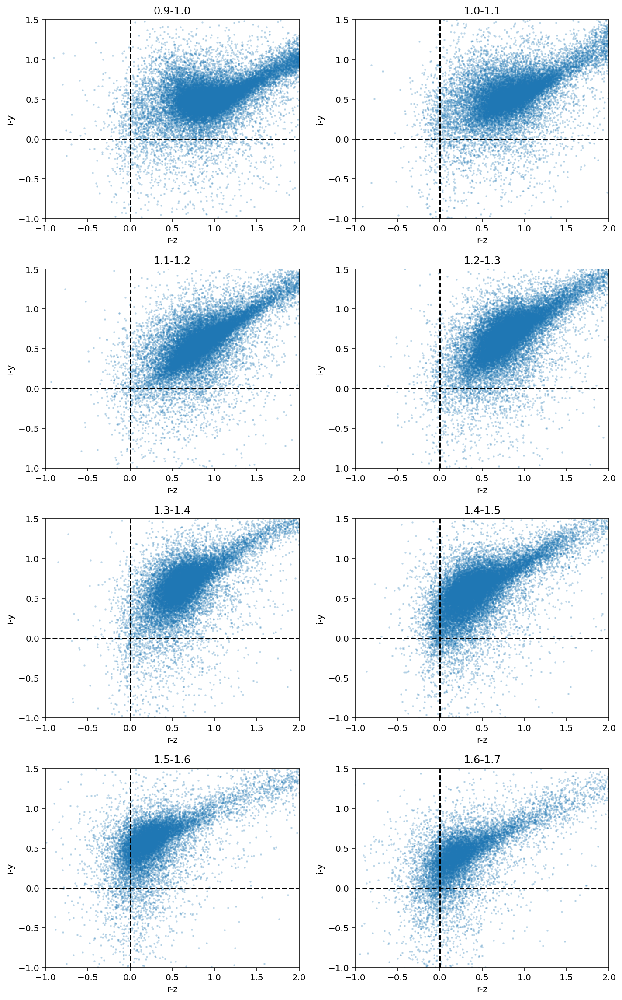

In [14]:
'''Below we look at color vs color plots with reference lines at y=x=0'''
#i-y vs r-z
color_scat2(rz,iy, xlabel='r-z',ylabel='i-y', s=2, alpha=0.2)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/i-y vs r-z zbins.png',dpi=300)

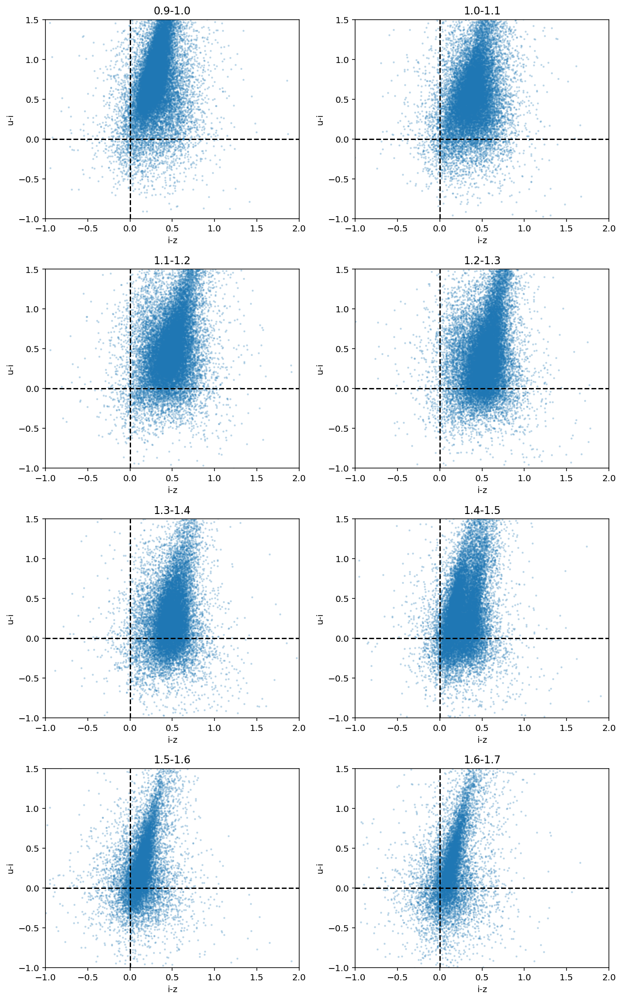

In [25]:
#u-i vs i-z
color_scat2(iz,ui, xlabel='i-z',ylabel='u-i', s=2, alpha=0.2)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/u-i vs i-z zbins.png',dpi=300)

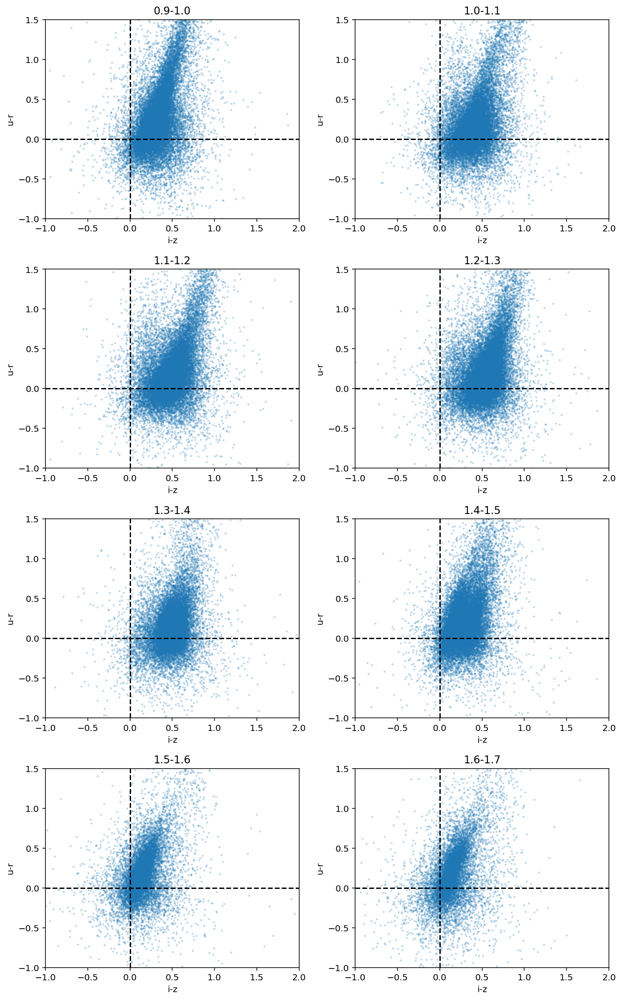

In [26]:
#u-r vs i-z 
color_scat2(iz,ur, xlabel='i-z',ylabel='u-r', s=2, alpha=0.2)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/u-r vs i-z zbins.png',dpi=300)

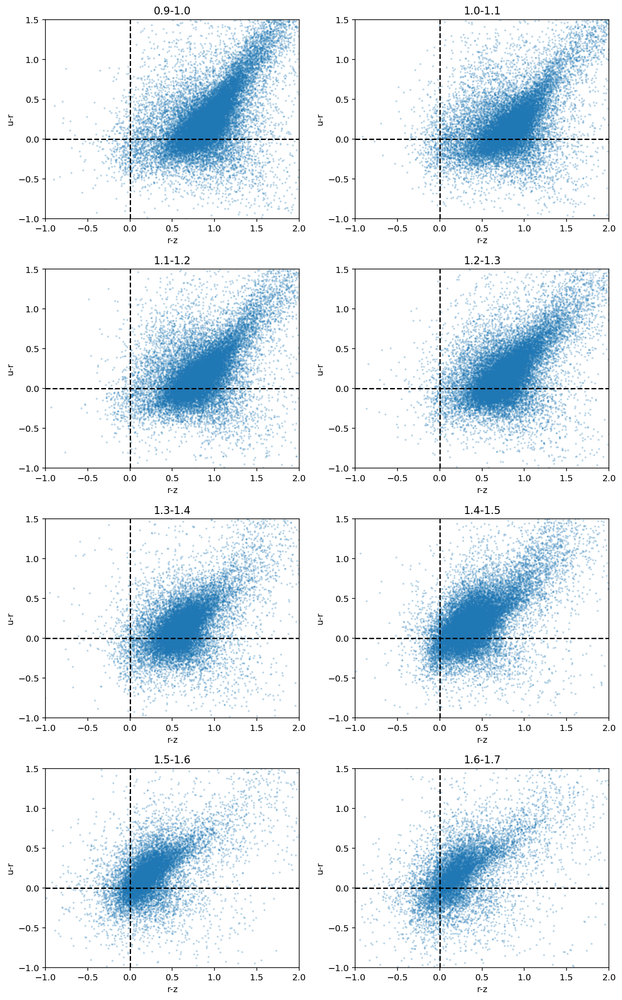

In [15]:
#u-r vs r-z
color_scat2(rz,ur, xlabel='r-z',ylabel='u-r', s=2, alpha=0.2)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/u-r vs r-z zbins.png',dpi=300)

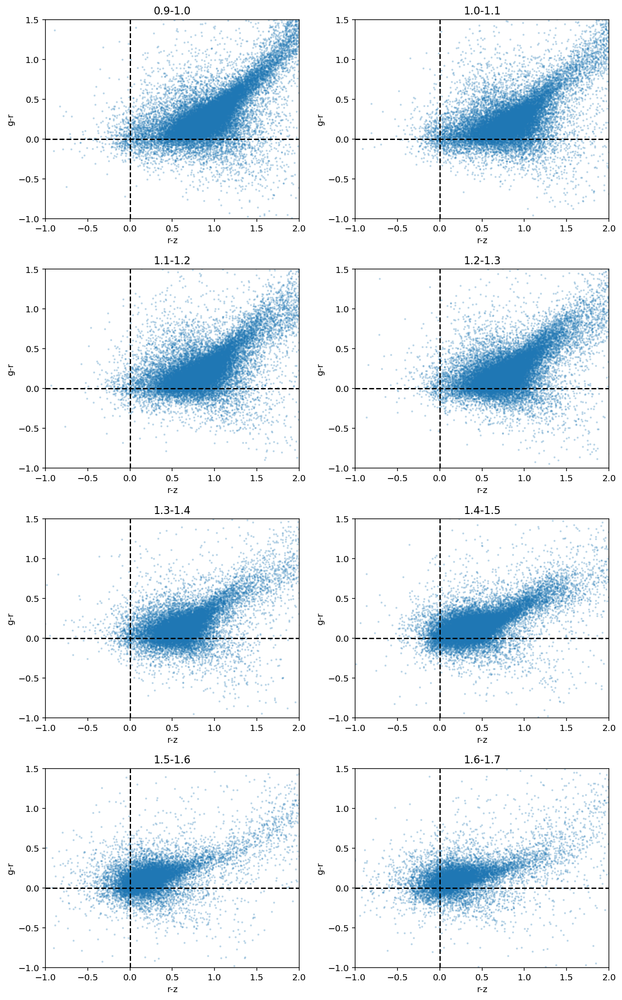

In [16]:
#g-r vs r-z
color_scat2(rz,gr, xlabel='r-z',ylabel='g-r', s=2, alpha=0.2)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/g-r vs r-z zbins.png',dpi=300)

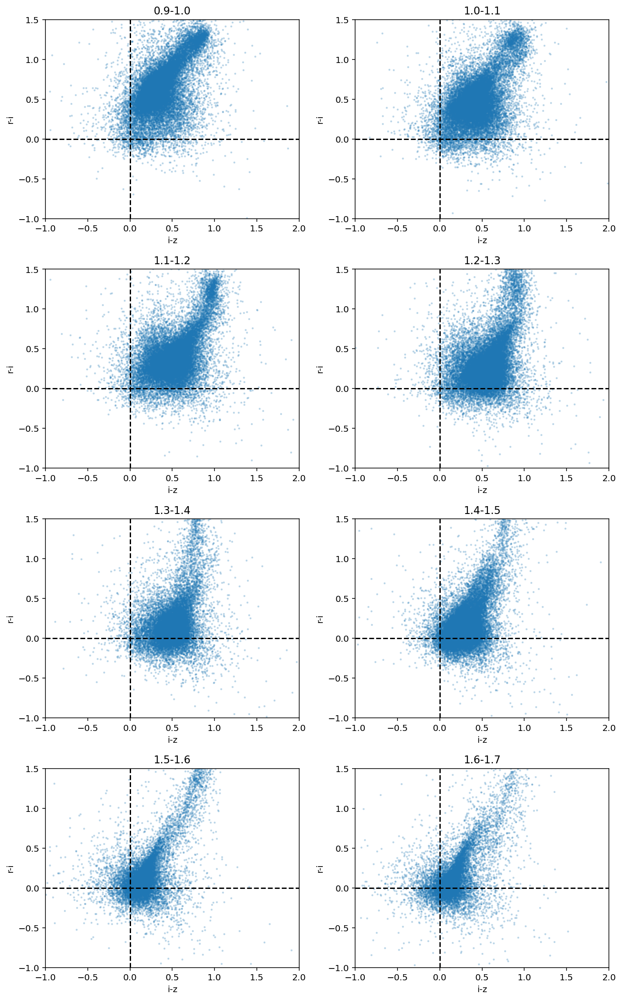

In [18]:
#r-i vs i-z
color_scat2(iz,ri, xlabel='i-z',ylabel='r-i', s=2, alpha=0.2)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/r-i vs i-z zbins.png',dpi=300)

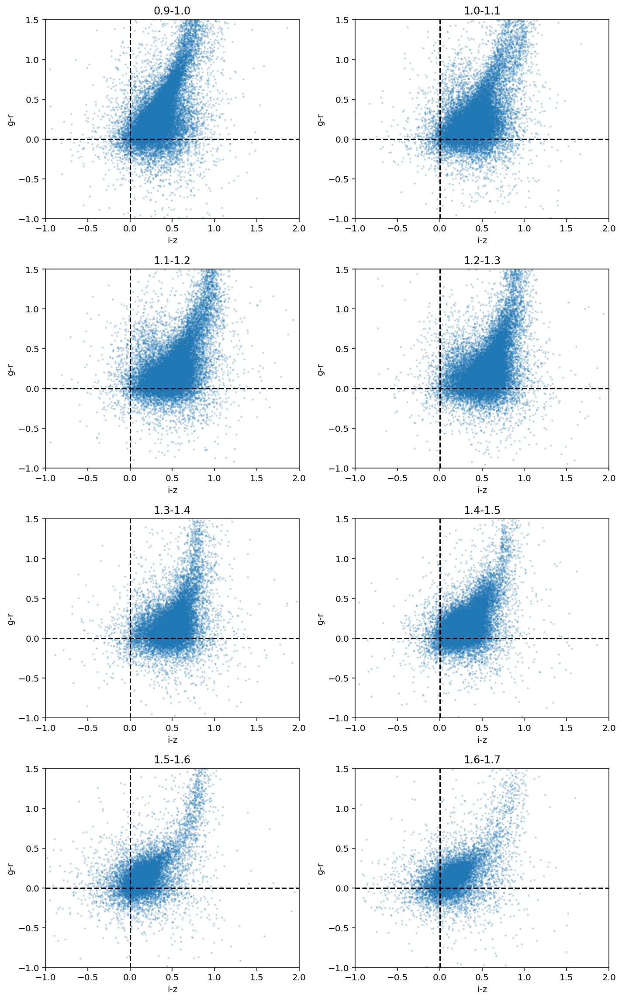

In [19]:

#g-r vs i-z
color_scat2(iz,gr, xlabel='i-z',ylabel='g-r', s=2, alpha=0.2)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/g-r vs i-z zbins.png',dpi=300)

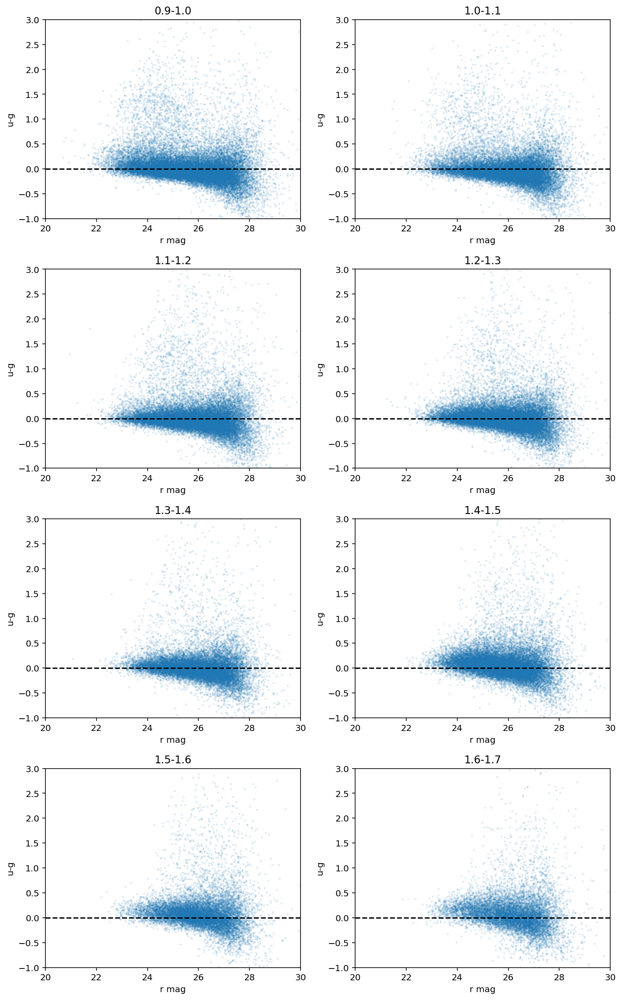

In [45]:
'''Since we were not able to identify clear separation for high and low photoz, we will look at the  plots of color vs mag and color vs photoz'''
#First we start with the color vs mag
#u-g vs r mag 

color_scat2(cat['HSC_r_MAG'],ug,xlim=(20,30),ylim=(-1,3), xlabel='r mag', ylabel='u-g', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/u-g vs r mag zbins.png',dpi=300)



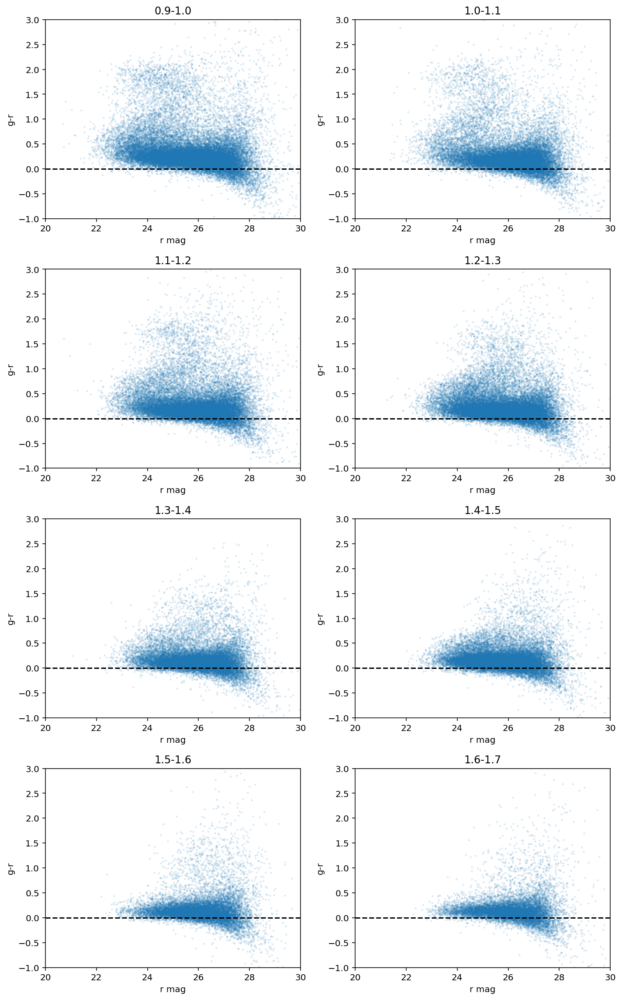

In [46]:
#g-r vs r mag
color_scat2(cat['HSC_r_MAG'],gr,xlim=(20,30),ylim=(-1,3), xlabel='r mag', ylabel='g-r', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/g-r vs r mag zbins.png',dpi=300)






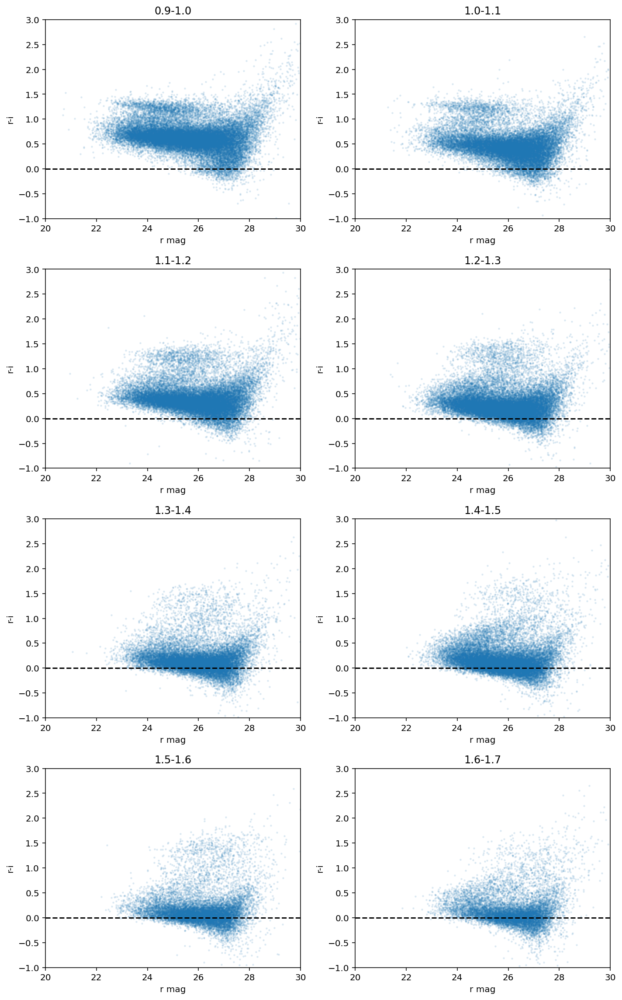

In [47]:
#r-i vs rmag
color_scat2(cat['HSC_r_MAG'],ri,xlim=(20,30),ylim=(-1,3), xlabel='r mag', ylabel='r-i', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/r-i vs r mag zbins.png',dpi=300)








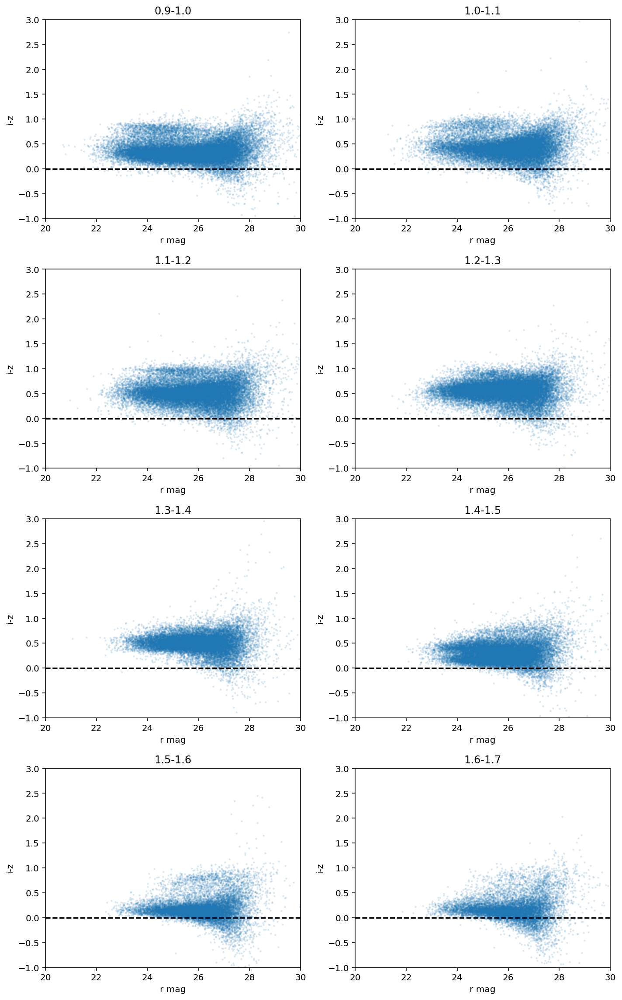

In [48]:
#i-z vs r mag
color_scat2(cat['HSC_r_MAG'],iz,xlim=(20,30),ylim=(-1,3), xlabel='r mag', ylabel='i-z', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/i-z vs r mag zbins.png',dpi=300)










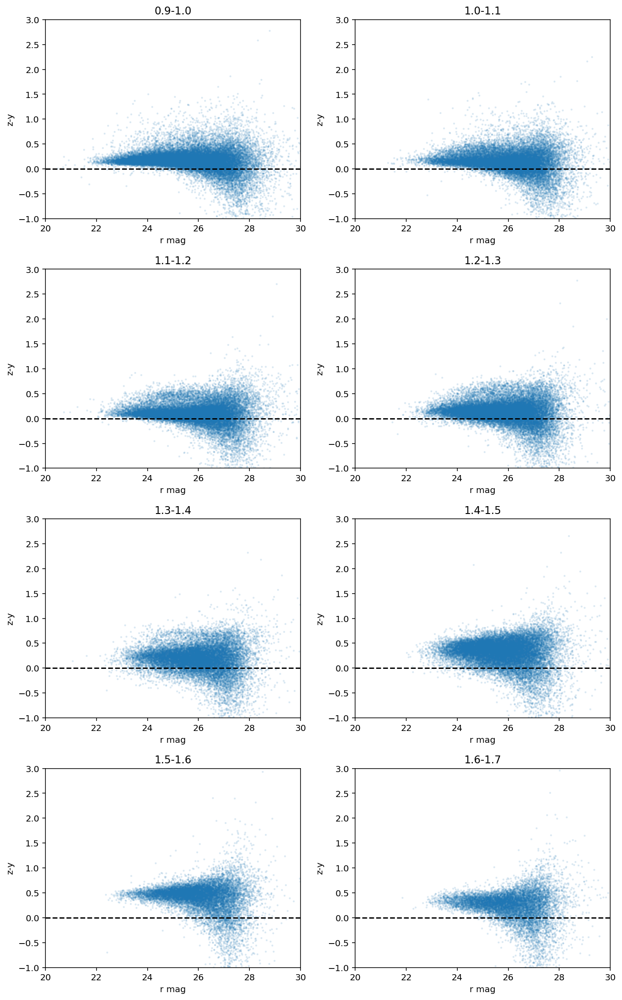

In [49]:
#z-y vs rmag
color_scat2(cat['HSC_r_MAG'],zy,xlim=(20,30),ylim=(-1,3), xlabel='r mag', ylabel='z-y', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/z-y vs r mag zbins.png',dpi=300)










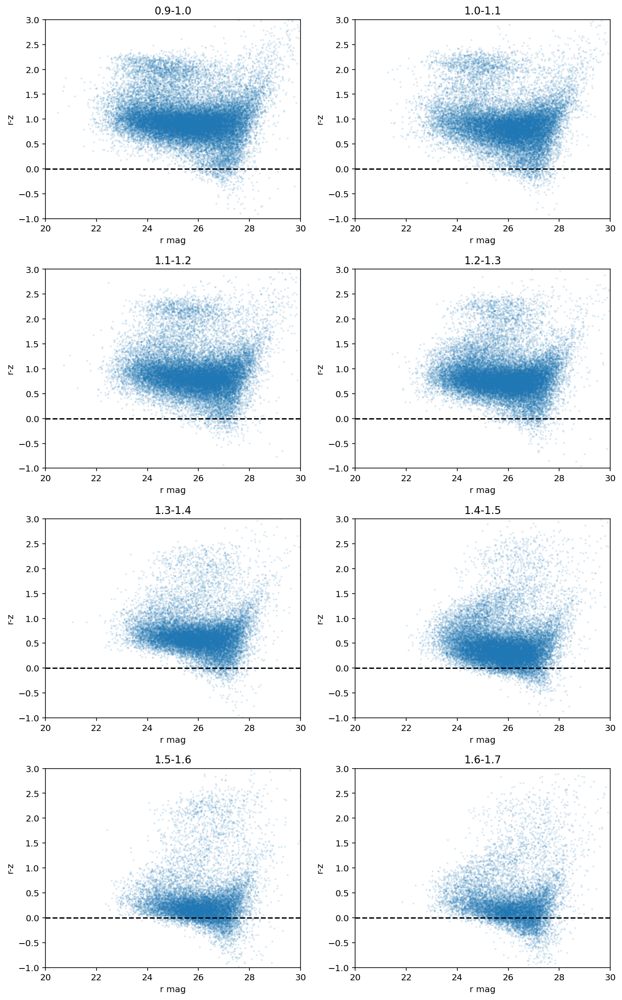

In [50]:
#r-z vs rmag 
color_scat2(cat['HSC_r_MAG'],rz,xlim=(20,30),ylim=(-1,3), xlabel='r mag', ylabel='r-z', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/r-z vs r mag zbins.png',dpi=300)











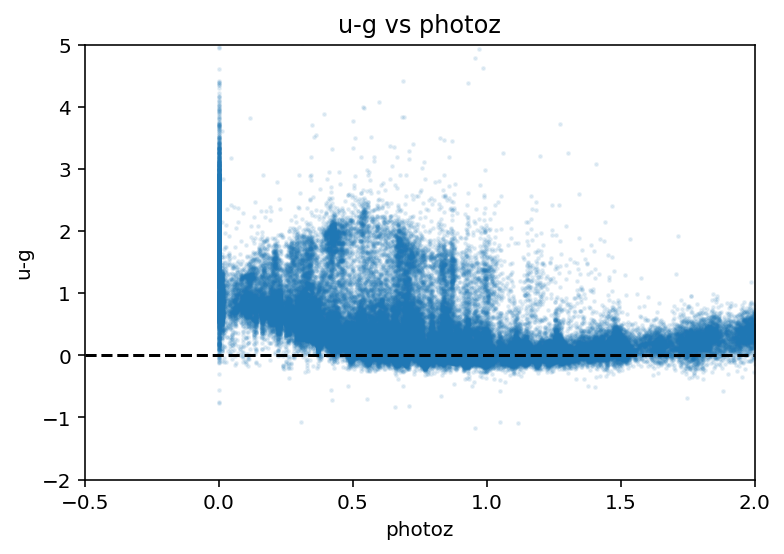

In [39]:
'''Here begans the plots of color vs photoz'''
#u-g vs photoz 
scatter(cat['photoz'][colormask1],ug[colormask1],xlim=(-0.5,2),ylim=(-2,5), xlabel='photoz', ylabel='u-g',title='u-g vs photoz', s=2, alpha=0.1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/u-g vs photoz.png',dpi=300)





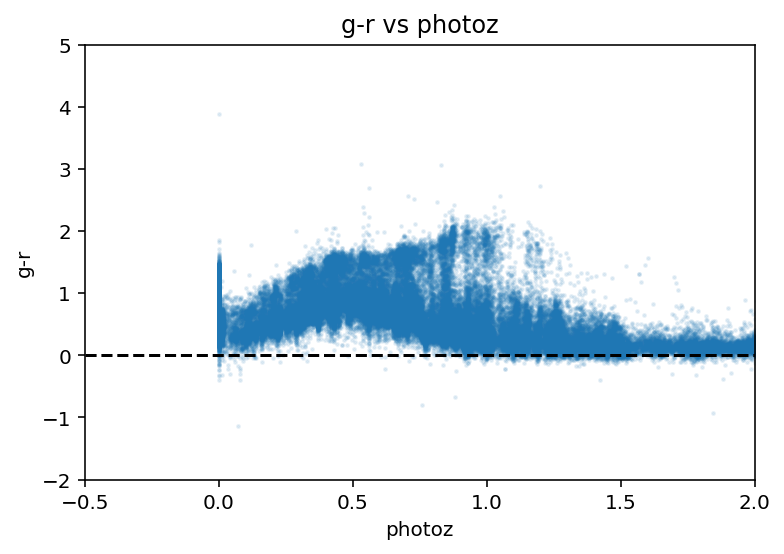

In [40]:
#g-r vs photoz 
scatter(cat['photoz'][colormask1],gr[colormask1],xlim=(-0.5,2),ylim=(-2,5), xlabel='photoz', ylabel='g-r',title='g-r vs photoz', s=2, alpha=0.1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/g-r vs photoz.png',dpi=300)

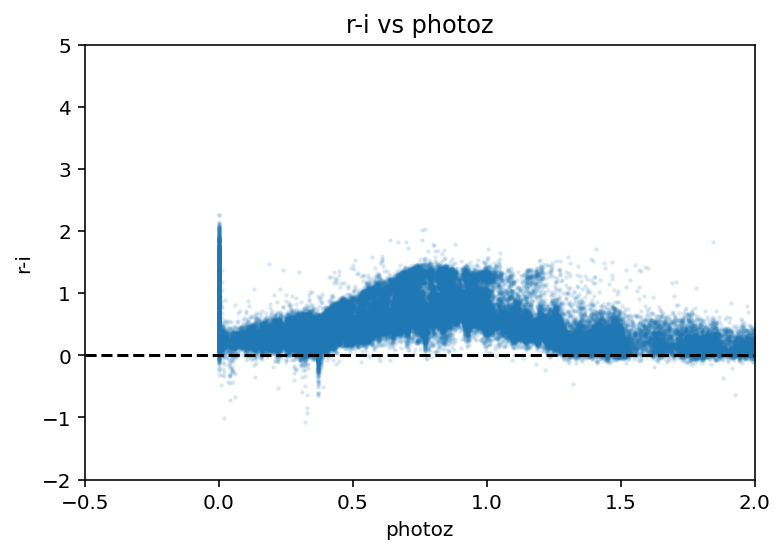

In [41]:
#r-i vs photoz 
scatter(cat['photoz'][colormask1],ri[colormask1],xlim=(-0.5,2),ylim=(-2,5), xlabel='photoz', ylabel='r-i',title='r-i vs photoz', s=2, alpha=0.1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/r-i vs photoz.png',dpi=300)

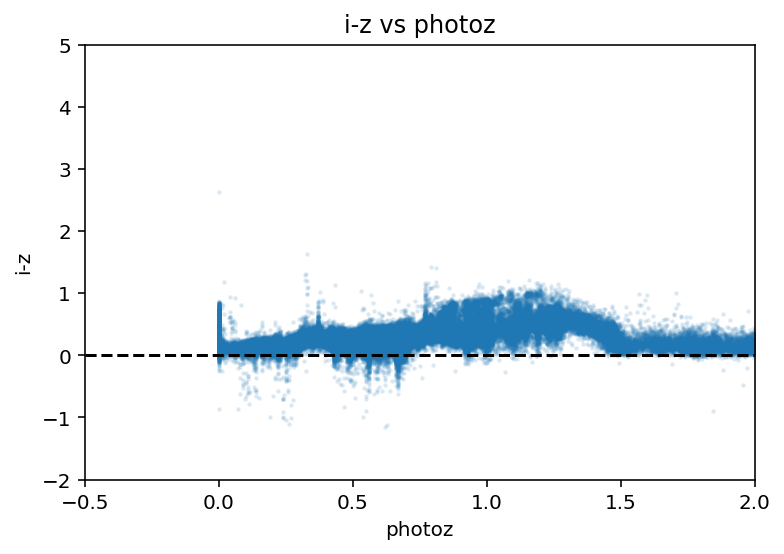

In [42]:
#i-z vs photoz 
scatter(cat['photoz'][colormask1],iz[colormask1],xlim=(-0.5,2),ylim=(-2,5), xlabel='photoz', ylabel='i-z',title='i-z vs photoz', s=2, alpha=0.1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/i-z vs photoz.png',dpi=300)

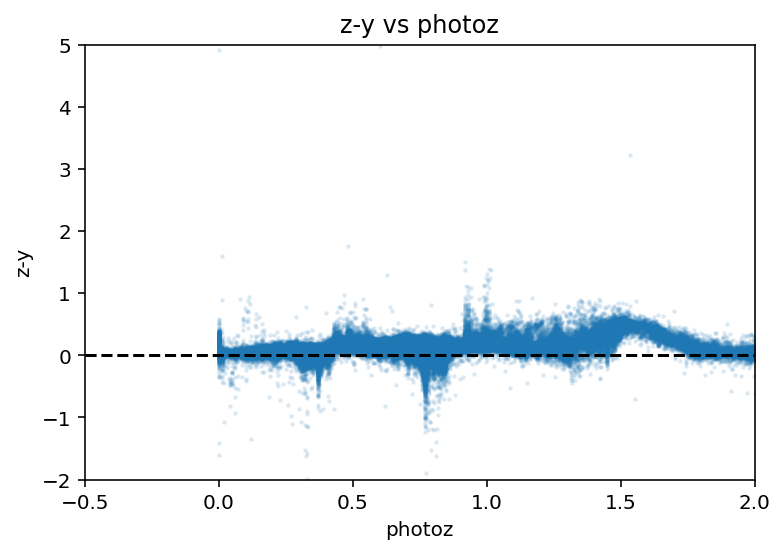

In [43]:
#z-y vs photoz 
scatter(cat['photoz'][colormask1],zy[colormask1],xlim=(-0.5,2),ylim=(-2,5), xlabel='photoz', ylabel='z-y',title='z-y vs photoz', s=2, alpha=0.1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/z-y vs photoz.png',dpi=300)

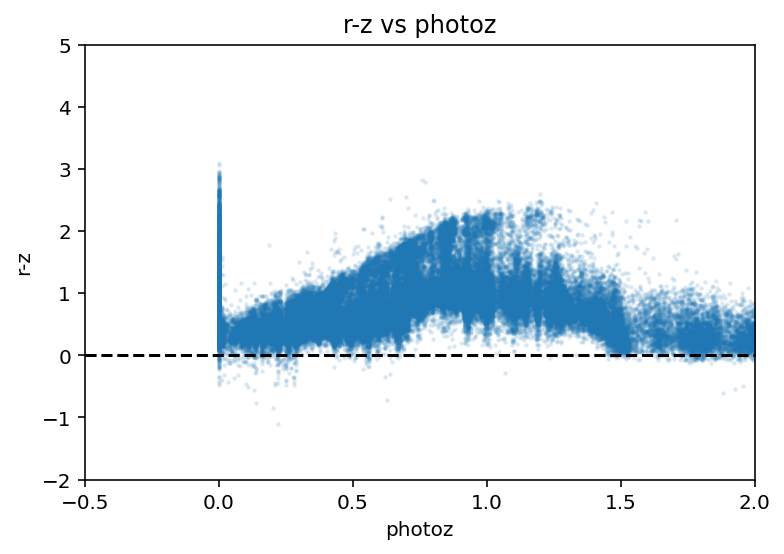

In [44]:
#r-z vs photoz 
scatter(cat['photoz'][colormask1],rz[colormask1],xlim=(-0.5,2),ylim=(-2,5), xlabel='photoz', ylabel='r-z',title='r-z vs photoz', s=2, alpha=0.1)
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/r-z vs photoz.png',dpi=300)

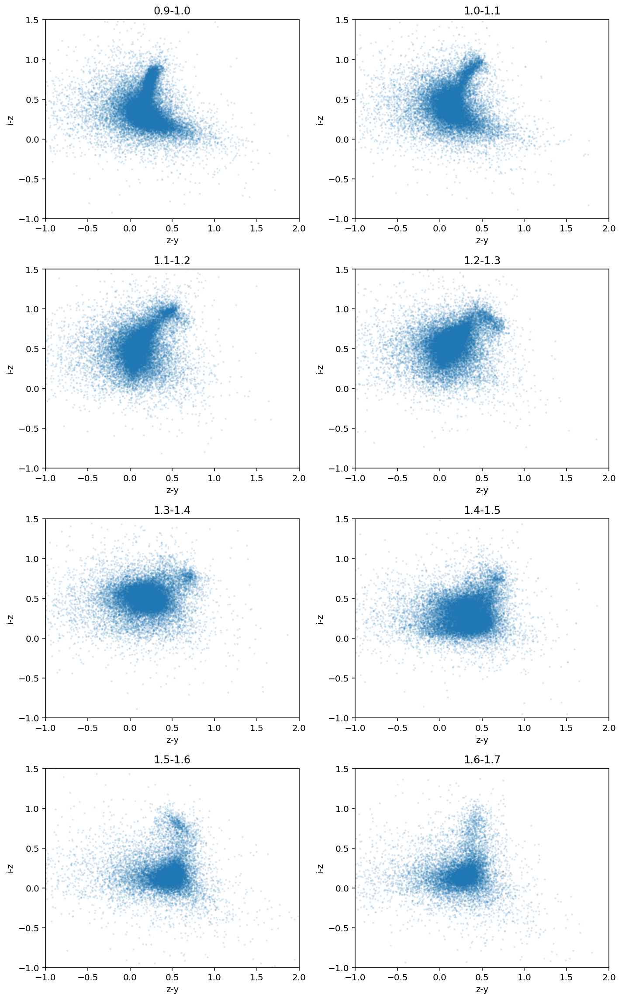

In [8]:
#i-z vs z-y
color_scat2(zy,iz,xlabel='z-y',ylabel='i-z', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/i-z vs z-y zbins.png',dpi=300)

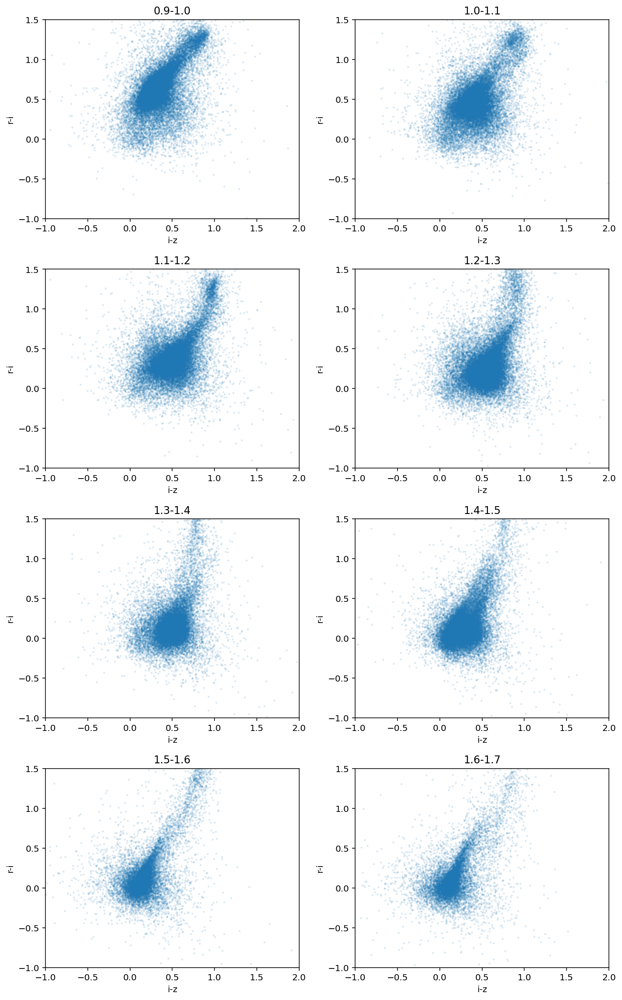

In [9]:
#r-i vs i-z
color_scat2(iz,ri,xlabel='i-z',ylabel='r-i', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/r-i vs i-z zbins.png',dpi=300)

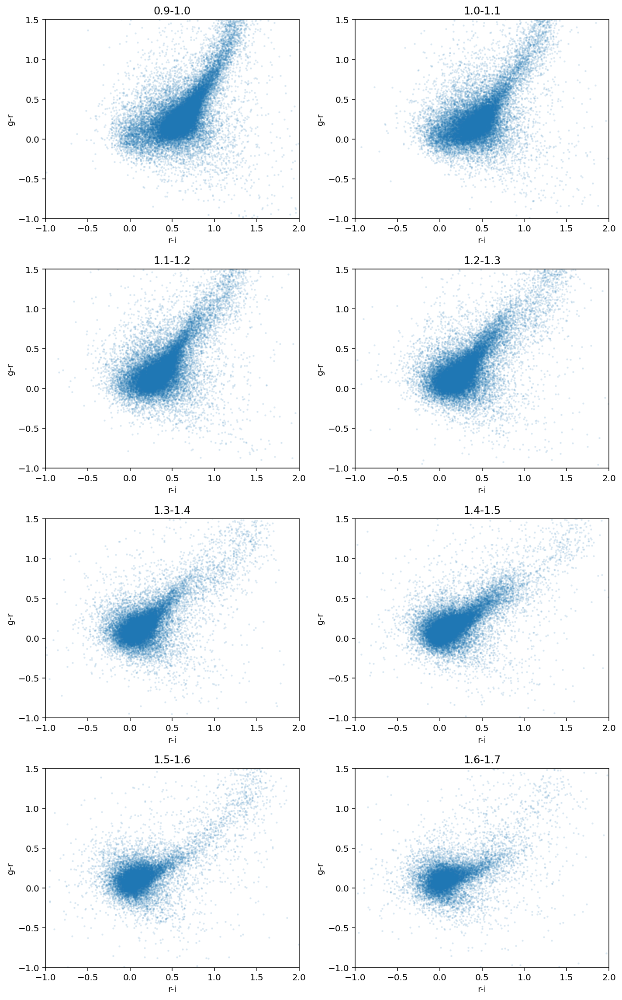

In [10]:
#g-r vs r-i
color_scat2(ri,gr,xlabel='r-i',ylabel='g-r', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/g-r vs r-i zbins.png',dpi=300)

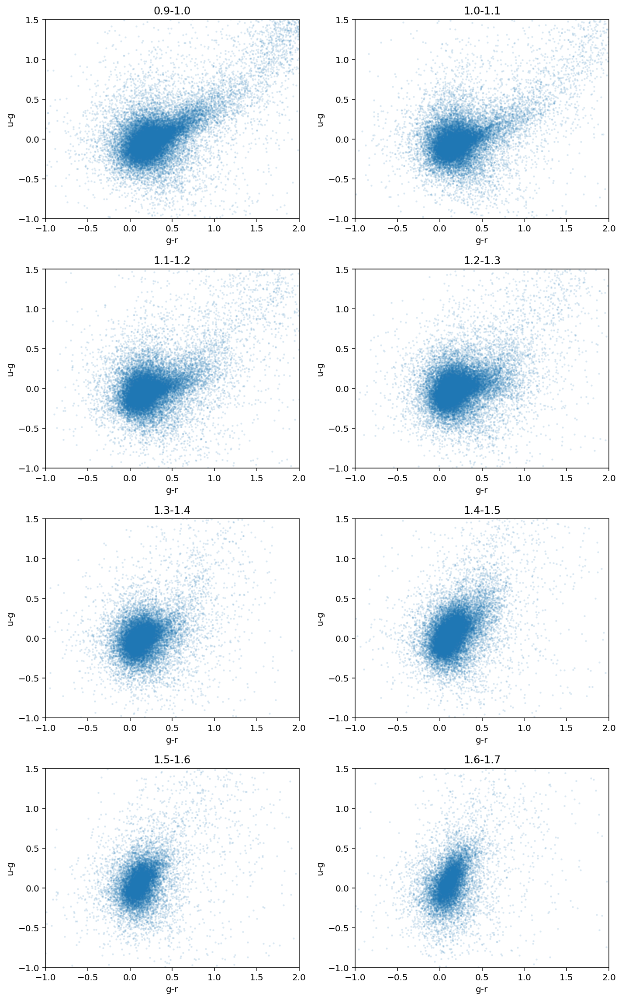

In [11]:
#u-g vs g-r
color_scat2(gr,ug,xlabel='g-r',ylabel='u-g', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/u-g vs g-r zbins.png',dpi=300)

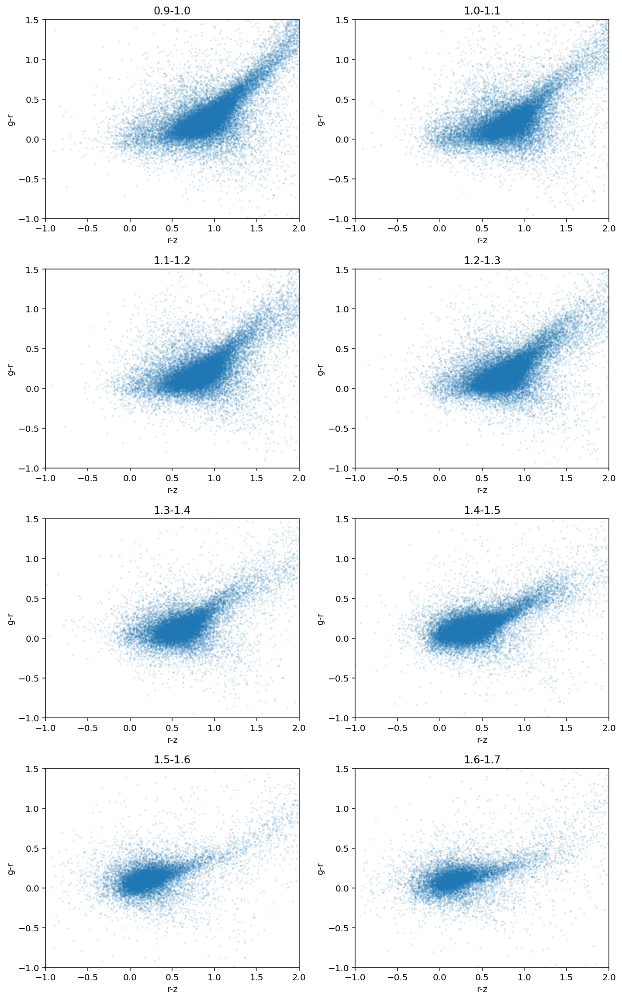

In [12]:
#g-r vs r-z
color_scat2(rz,gr,xlabel='r-z',ylabel='g-r', s=2, alpha=0.1)
plt.subplots_adjust(top = 0.99, bottom=0.01, hspace=1, wspace=0.4)
plt.tight_layout()
plt.savefig('/Users/yokisalcedo/Desktop/Cosmos2020analysisfigs/g-r vs r-z zbins.png',dpi=300)

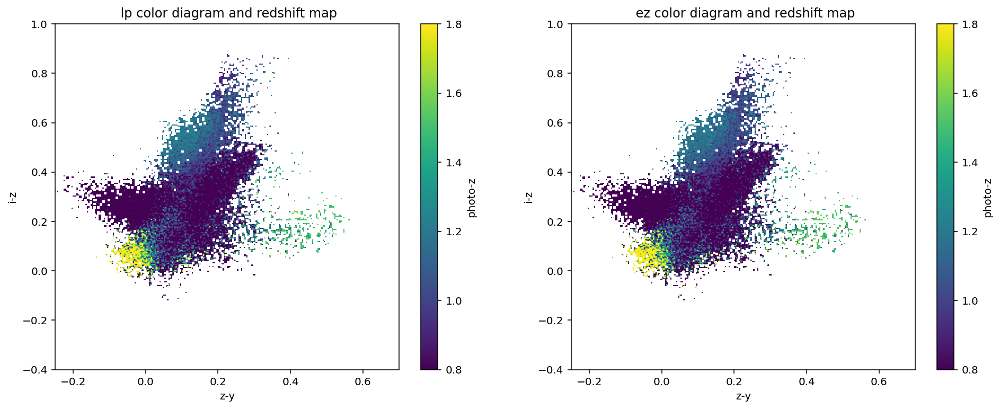

In [38]:
#i-z vs z-y
color(zy[total_mask],iz[total_mask],xlabel='z-y',ylabel='i-z',xlim=(-0.25,0.7),ylim= (-0.4,1))
plt.savefig("izy.png",dpi=300)

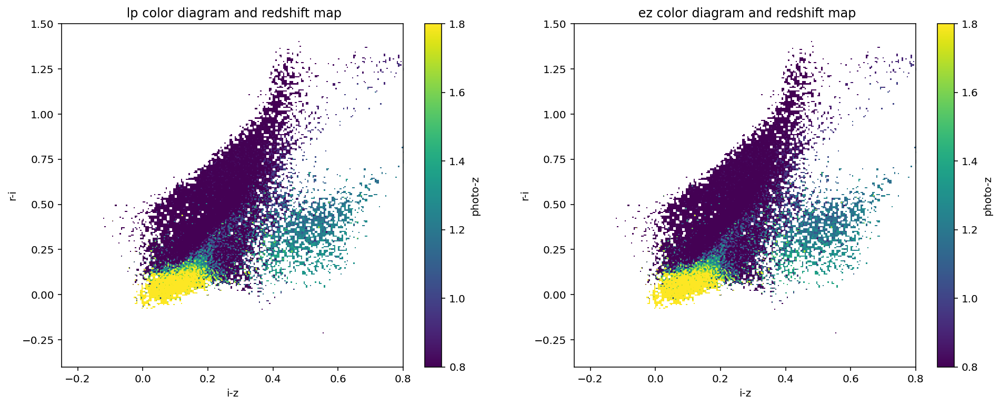

In [39]:
#r-i vs i-z
color(iz[total_mask],ri[total_mask],xlabel='i-z',ylabel='r-i',xlim=(-0.25,0.8),ylim= (-0.4,1.5))
plt.savefig("riz.png",dpi=300)

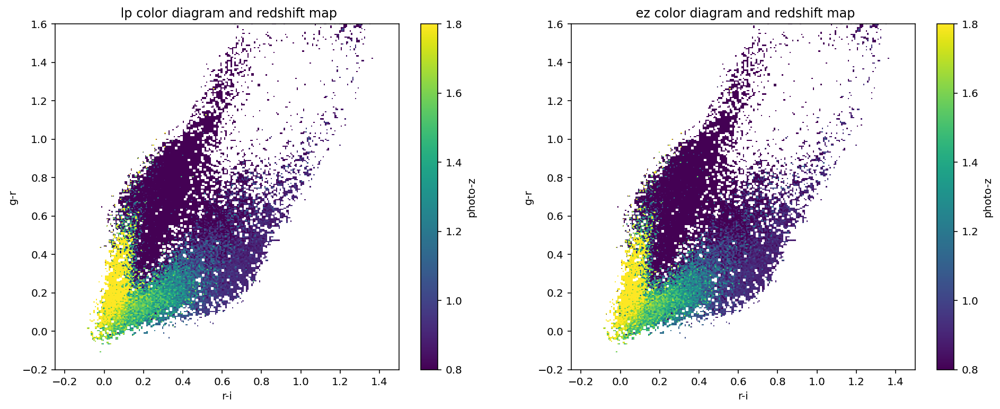

In [40]:
#g-r vs r-i
color(ri[total_mask],gr[total_mask],xlabel='r-i',ylabel='g-r',xlim=(-0.25,1.5
                                                                   ),ylim= (-.2,1.6))
plt.savefig("gri.png",dpi=300)

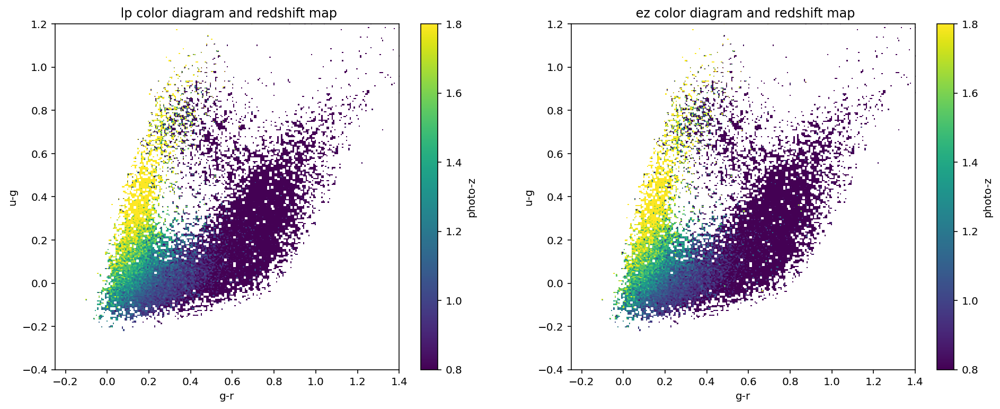

In [41]:
#u-g vs g-r

color(gr[total_mask],ug[total_mask],xlabel='g-r',ylabel='u-g',xlim=(-0.25,1.4),ylim= (-0.4,1.2))
plt.savefig("ugr.png",dpi=300)

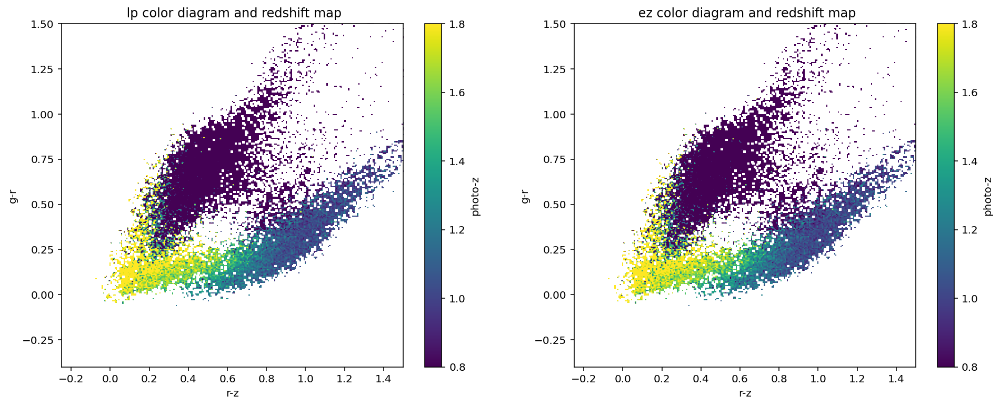

In [42]:
#g-r vs r-z color color plot
color1 = cat['HSC_r_MAG'] - cat['HSC_z_MAG']
color2 = cat['HSC_g_MAG'] - cat['HSC_r_MAG']
color(color1[total_mask],color2[total_mask],xlabel='r-z',ylabel='g-r',xlim=(-0.25,1.5),ylim= (-0.4,1.5))
plt.savefig("grz.png",dpi=300)

In [10]:
def scat_gen(data1, data2, xlabel, ylabel, title,xlim=(20,30),ylim= (0,2),**kwargs):
    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
    ax.scatter_density(data1,data2,**kwargs)
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    #ax.axvline(vline,ls= '--',label = 'normal depth', color='black')
    #ax.plot(data1, data2,**kwargs)
    
    return ax

In [12]:

def mag_err(data1, xlabel, title,vline,**kwargs):
    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1, projection='scatter_density')
    ax.scatter_density(data1,mag_error[okplot],**kwargs)
    ax.set_xlim(20,30)
    ax.set_ylim(0,0.5)
    ax.set_xlabel(xlabel)
    ax.set_ylabel('Mag Error')
    ax.set_title(title)
    ax.axvline(vline,ls= '--',label = 'normal depth', color='black')
    #ax.plot(data1, xlabel, title, vline,**kwargs)
    
    return ax



/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


<ScatterDensityAxesSubplot:title={'center':'Mag Error vs z band Mag'}, xlabel='z band Mag', ylabel='Mag Error'>

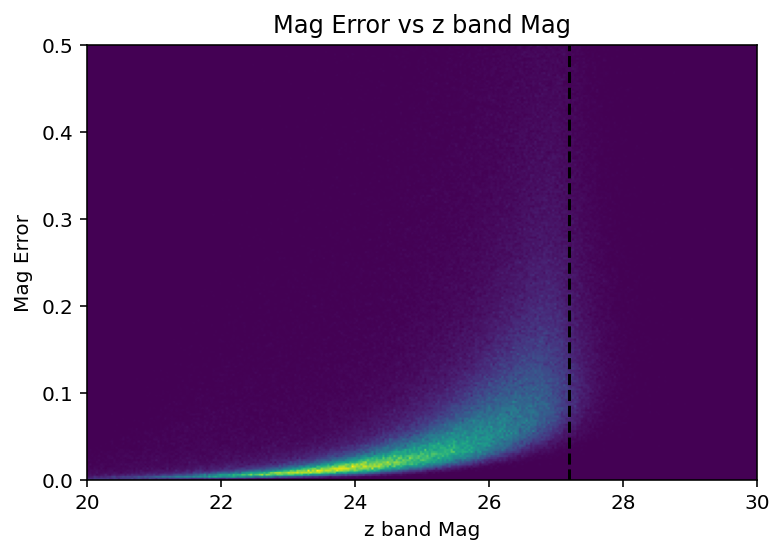

In [64]:
okplot = np.logical_and(np.isfinite(cat['HSC_z_MAG']),np.isfinite(mag_error))
mag_err(cat['HSC_z_MAG'][okplot], xlabel='z band Mag', title='Mag Error vs z band Mag', vline=27.2)

In [12]:

def mag_hist(data,vline,bins=100, xlabel ='Magnitude', title='Counts', color='blue', histtype='step', grid_on=True, log=True, density=True, alpha=0.5, **hist_kwargs):
    fig, ax = plt.subplots()

# note change to following line to pass **hist_kwargs
    ax.hist(data,bins=bins,color=color,alpha=alpha,histtype=histtype,density=density, **hist_kwargs)
    ax.set_xlim(20, 30)
    ax.set_xlabel(xlabel)
    ax.set_ylabel('Normalized counts')
    ax.grid(grid_on)
    ax.set_title(title, size=16)
    ax.axvline(vline,ls= '--',label = 'normal depth', color='black')
    return fig


#fig = mag_hist(cat['CFHT_u_MAG'], xlabel='u band Mag', title='counts vs i band Mag', grid_on=True, bins=100,linewidth=1,alpha=0.5, color='blue', vline=27.3,histtype='bar')



In [13]:
#Histograms and Mag Error vs Mag plots start here
#Best estimate is around 26.5 for 5 sigma limit
mag_hist(cat['CFHT_u_MAG'],865,vline=27.8,title='Normalized counts vs u band Mag', xlabel= 'u band Mag', color='teal')

TypeError: mag_hist() got multiple values for argument 'vline'

/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


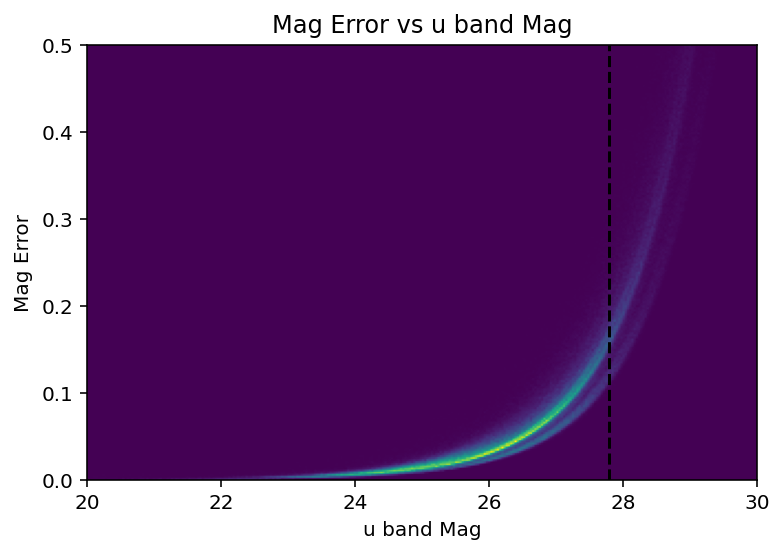

In [14]:
f_e = cat['CFHT_u_FLUXERR']
f = cat['CFHT_u_FLUX']
#flux_error = np.array(f_e[np.isfinite(f_e)])
#flux = np.array(f[np.isfinite(f)])
#mask = np.isfinite(a) | np.isfinite(b)

flux_error = np.array(f_e)
flux = np.array(f)

mag_error = (2.5/np.log(10))*(flux_error/flux)
#okplot = np.isfinite((cat['HSC_g_MAG'])) & (np.isfinite(mag_error))
okplot = np.logical_and(np.isfinite(cat['CFHT_u_MAG']),np.isfinite(mag_error))



okplot = np.logical_and(np.isfinite(cat['CFHT_u_MAG']),np.isfinite(mag_error))
axes = mag_err(cat['CFHT_u_MAG'][okplot], xlabel='u band Mag', title='Mag Error vs u band Mag', vline=27.8)

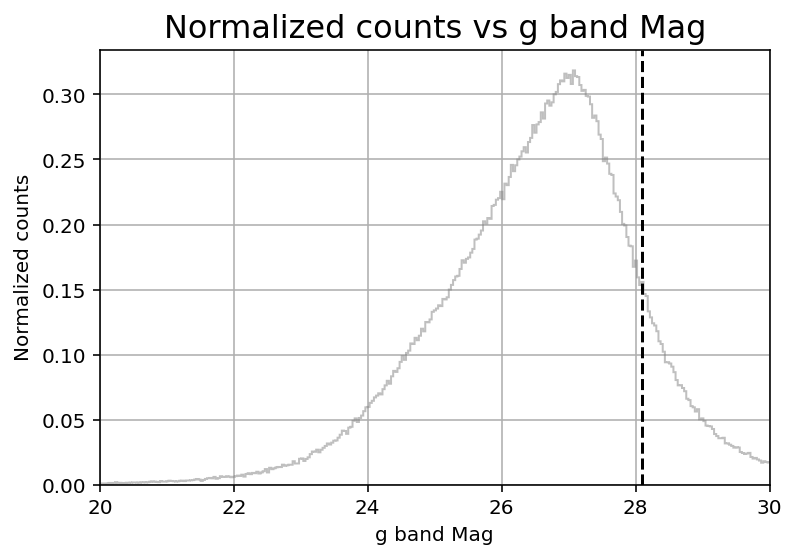

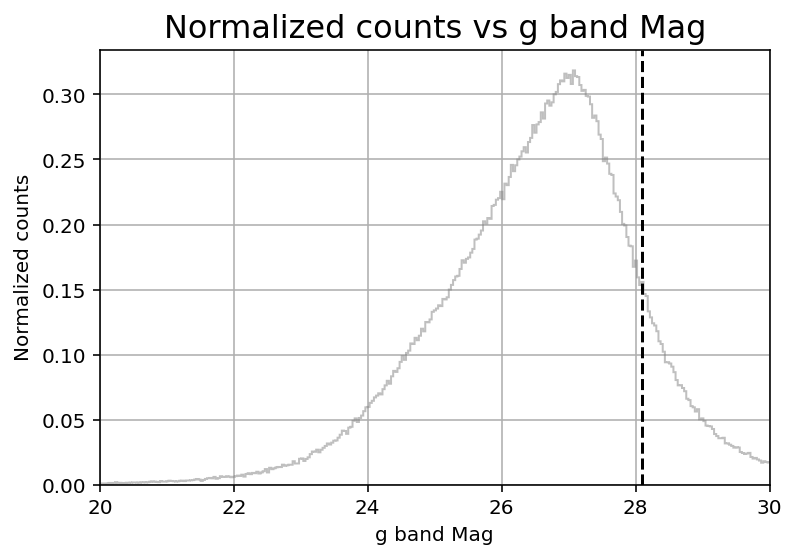

In [15]:
#best estimate is around 26.7 for 5 sigma limit
mag_hist(cat['HSC_g_MAG'],bins=865,title='Normalized counts vs g band Mag', xlabel= 'g band Mag', vline=28.1, color='grey')

<ScatterDensityAxesSubplot:title={'center':'Mag Error vs g band Mag'}, xlabel='g band Mag', ylabel='Mag Error'>

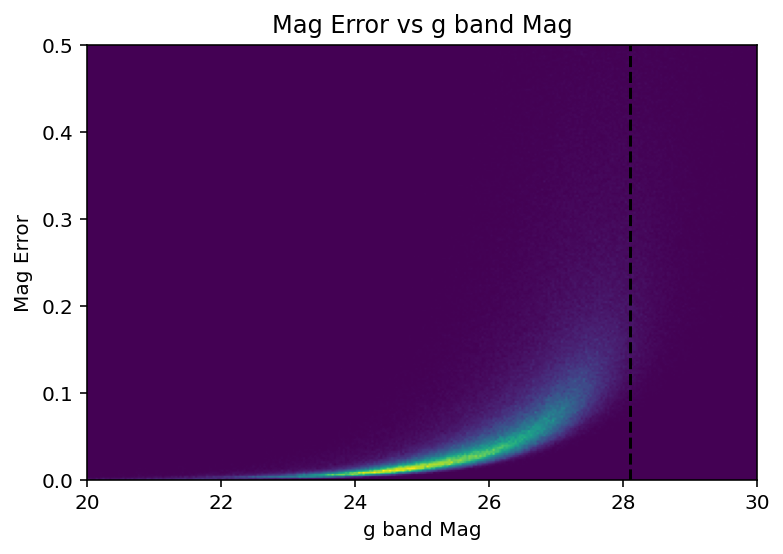

In [50]:
okplot = np.logical_and(np.isfinite(cat['HSC_g_MAG']),np.isfinite(mag_error))
mag_err(cat['HSC_g_MAG'][okplot], xlabel='g band Mag', title='Mag Error vs g band Mag', vline=28.1)

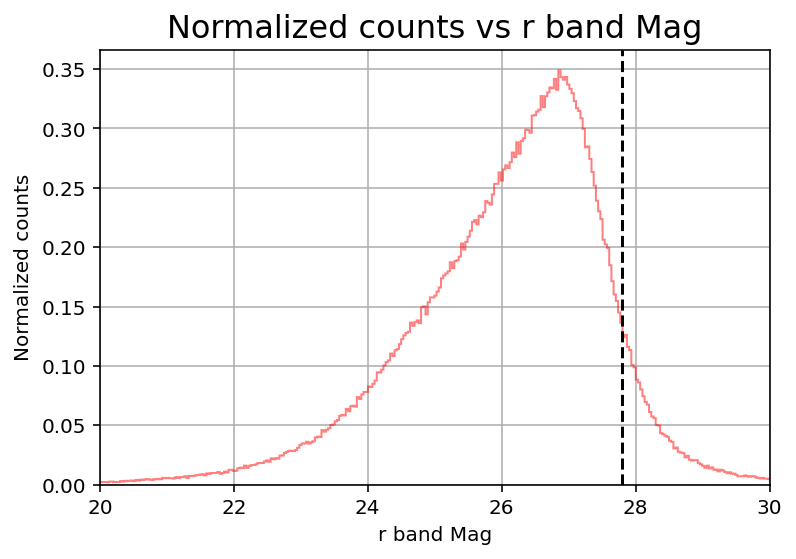

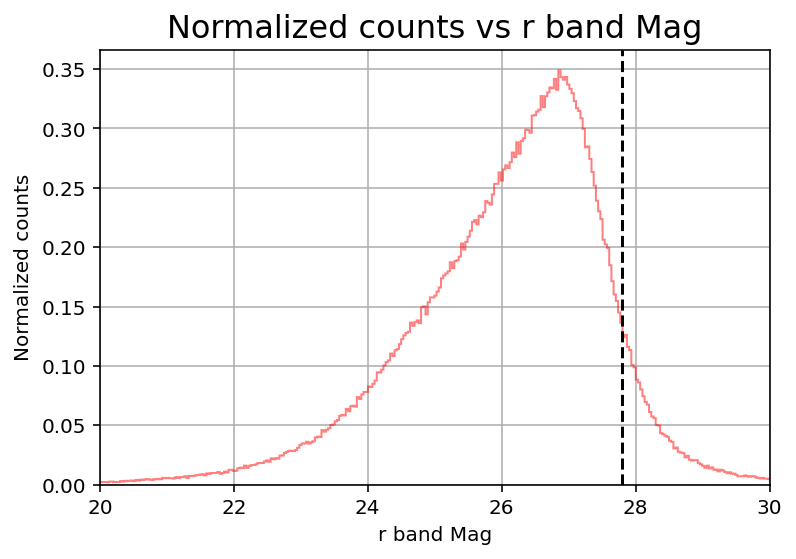

In [69]:
#best estimate is around 26.7 for 5 sigma limit
#fall off is sharper for tail
mag_hist(cat['HSC_r_MAG'],bins=865,title='Normalized counts vs r band Mag', xlabel= 'r band Mag', vline=27.8, color='red')

/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


<ScatterDensityAxesSubplot:title={'center':'Mag Error vs r band Mag'}, xlabel='r band Mag', ylabel='Mag Error'>

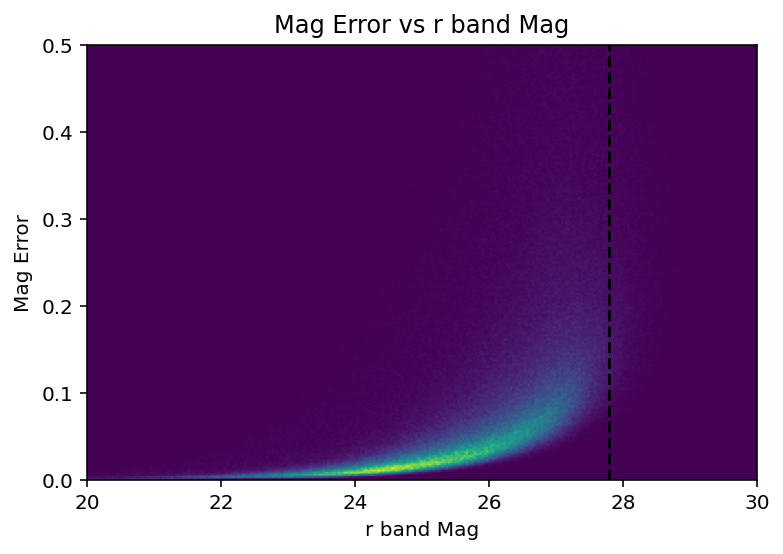

In [52]:
okplot = np.logical_and(np.isfinite(cat['HSC_r_MAG']),np.isfinite(mag_error))
mag_err(cat['HSC_r_MAG'][okplot], xlabel='r band Mag', title='Mag Error vs r band Mag', vline=27.8)

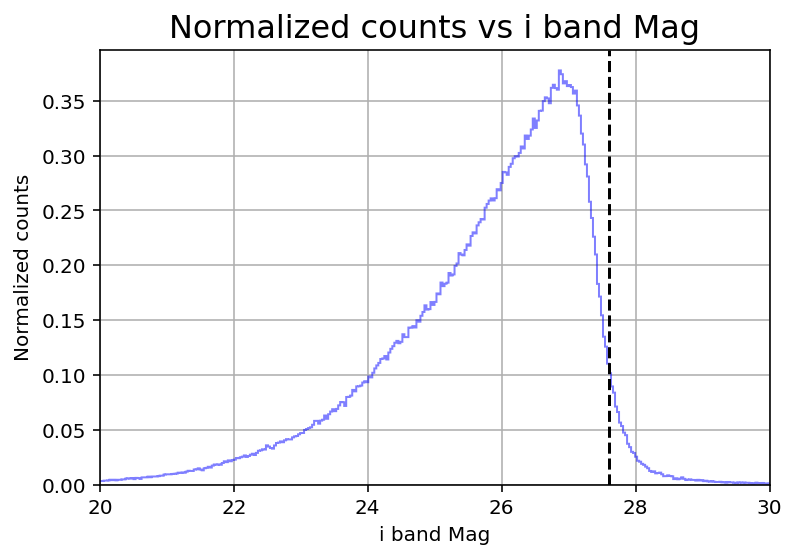

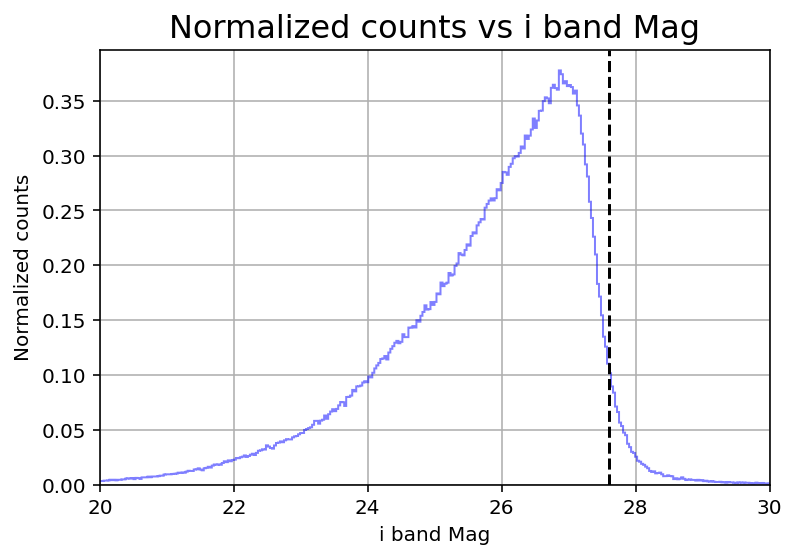

In [70]:
# best estimate is around 26.8
mag_hist(cat['HSC_i_MAG'],bins=865,title='Normalized counts vs i band Mag', xlabel= 'i band Mag', vline=27.6, color='blue')

/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


<ScatterDensityAxesSubplot:title={'center':'Mag Error vs i band Mag'}, xlabel='i band Mag', ylabel='Mag Error'>

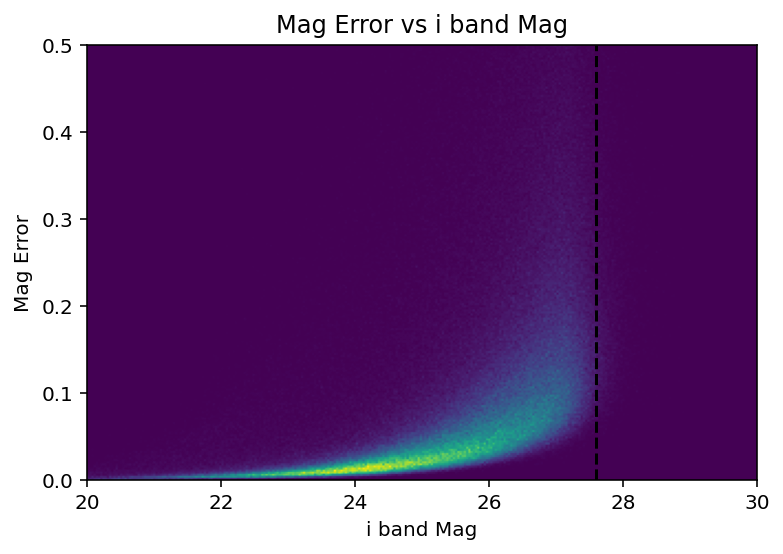

In [71]:
okplot = np.logical_and(np.isfinite(cat['HSC_i_MAG']),np.isfinite(mag_error))
mag_err(cat['HSC_i_MAG'][okplot], xlabel='i band Mag', title='Mag Error vs i band Mag', vline=27.6)

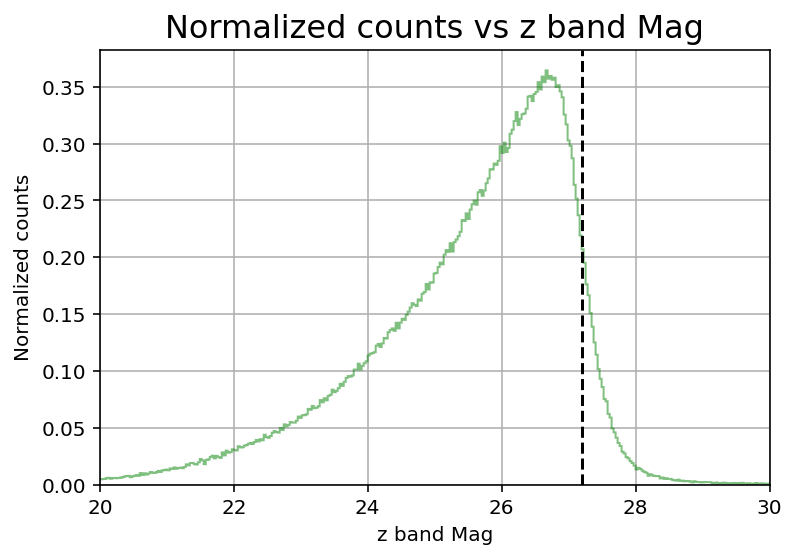

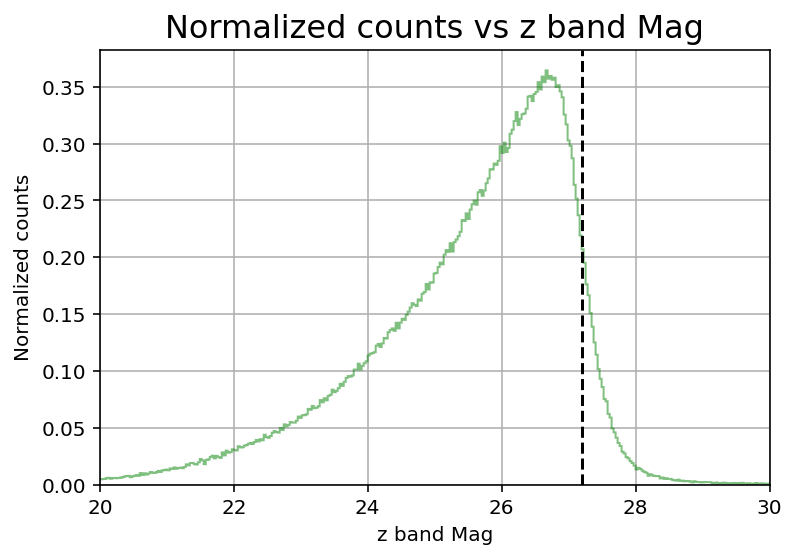

In [72]:
#best estimate is around 26.6
mag_hist(cat['HSC_z_MAG'],bins=865,title='Normalized counts vs z band Mag', xlabel= 'z band Mag', vline=27.2, color='green')

/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


<ScatterDensityAxesSubplot:title={'center':'Mag Error vs z band Mag'}, xlabel='z band Mag', ylabel='Mag Error'>

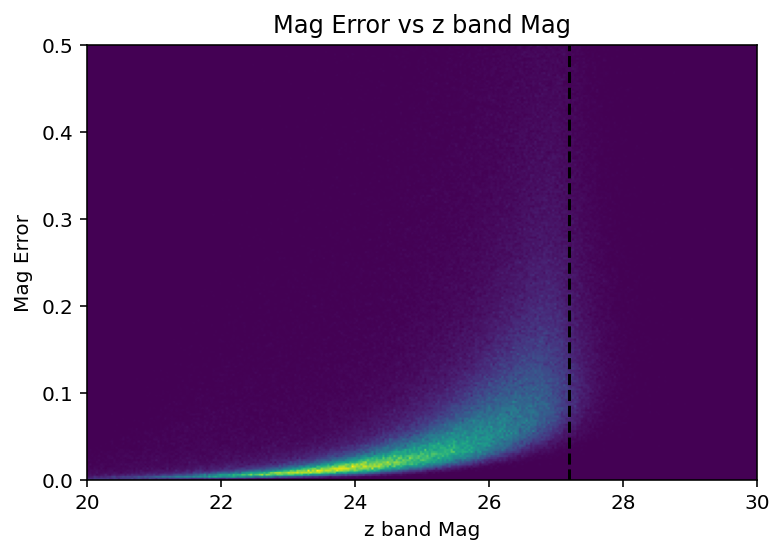

In [73]:
okplot = np.logical_and(np.isfinite(cat['HSC_z_MAG']),np.isfinite(mag_error))
mag_err(cat['HSC_z_MAG'][okplot], xlabel='z band Mag', title='Mag Error vs z band Mag', vline=27.2)

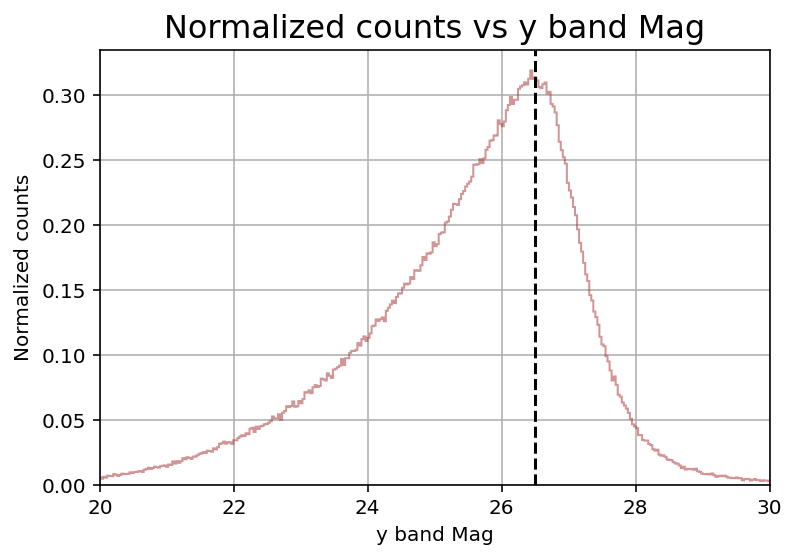

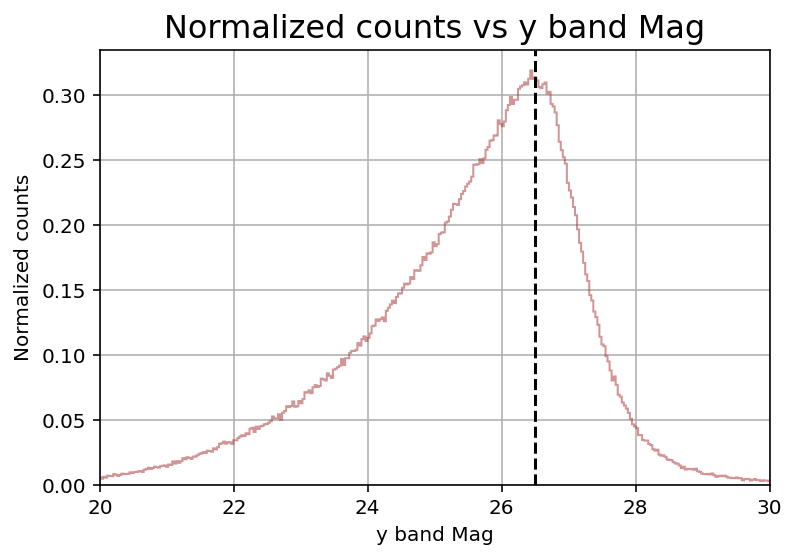

In [74]:
#best estimate is around 26.3 
mag_hist(cat['HSC_y_MAG'],bins=865,title='Normalized counts vs y band Mag', xlabel= 'y band Mag', vline=26.5, color='brown')

/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:77: RuntimeWarning: All-NaN slice encountered
  vmin = self._density_vmin(array)
/opt/anaconda3/lib/python3.8/site-packages/mpl_scatter_density/generic_density_artist.py:82: RuntimeWarning: All-NaN slice encountered
  vmax = self._density_vmax(array)


<ScatterDensityAxesSubplot:title={'center':'Mag Error vs y band Mag'}, xlabel='y band Mag', ylabel='Mag Error'>

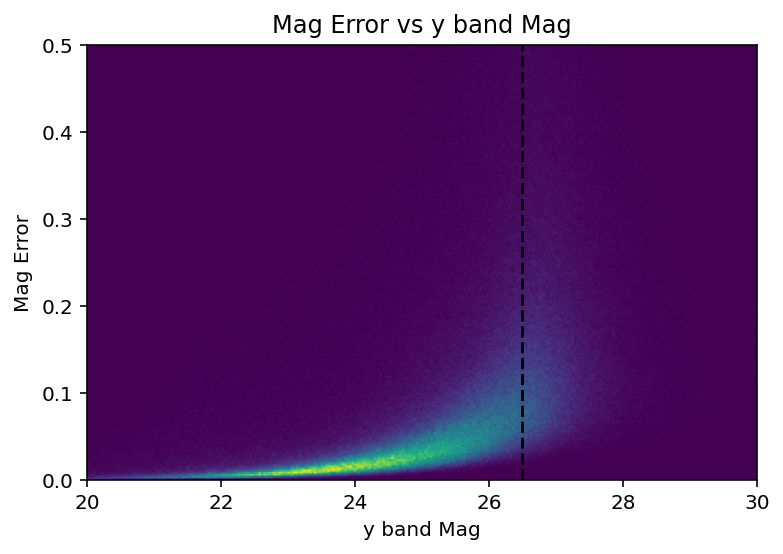

In [75]:
okplot = np.logical_and(np.isfinite(cat['HSC_y_MAG']),np.isfinite(mag_error))
mag_err(cat['HSC_y_MAG'][okplot], xlabel='y band Mag', title='Mag Error vs y band Mag', vline=26.5)

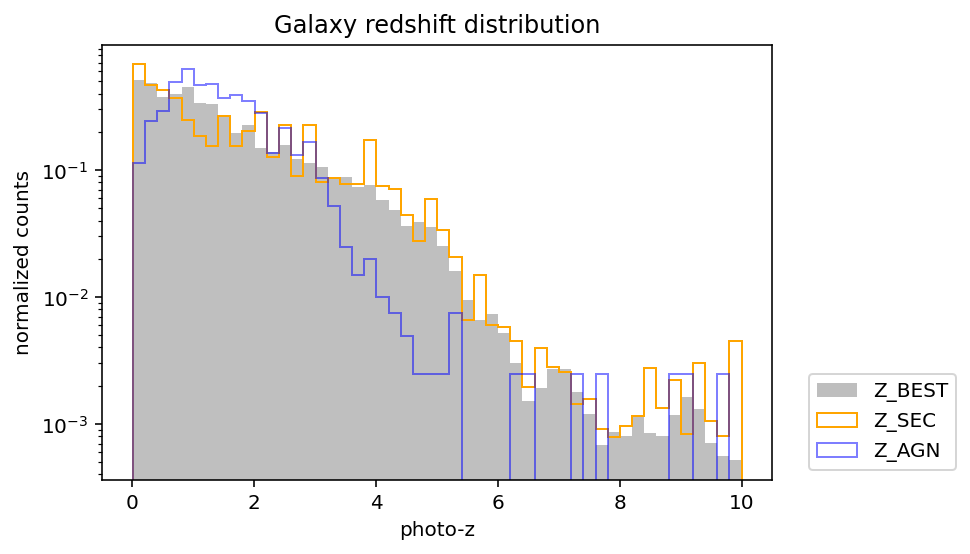

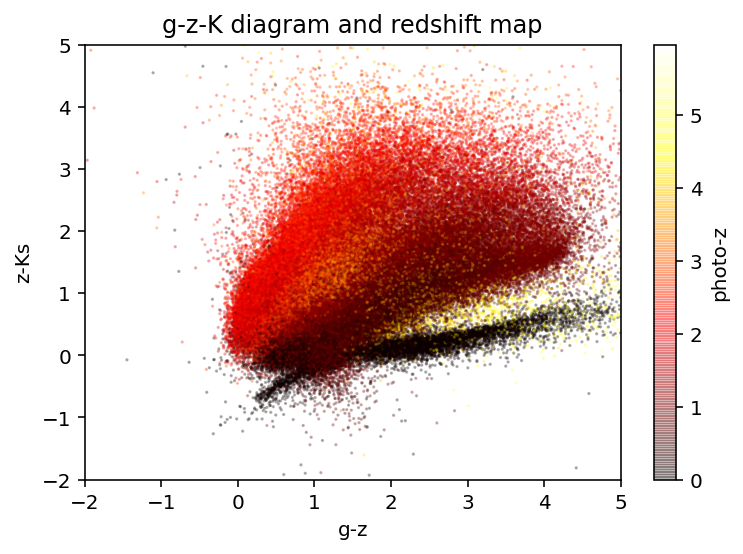

In [76]:
plt.hist(cat['photoz'],range=(0.01,10),log=True,bins=50,density=True,color ='grey',alpha=0.5,label = 'Z_BEST')
plt.hist(cat['lp_zp_2'],range=(0.01,10),log=False,bins=50,density=True,color ='orange',histtype='step',label = 'Z_SEC')
plt.hist(cat['lp_zq'][cat['lp_type']==2],range=(0.01,10),log=False,bins=50,density=True,color ='blue',alpha=0.5,label = 'Z_AGN',histtype='step')
plt.title('Galaxy redshift distribution')
plt.xlabel('photo-z')
plt.ylabel('normalized counts')
plt.legend(bbox_to_anchor=(1.04,0),loc='lower left') 
plt.show()

color1 = cat['HSC_g_MAG'] - cat['HSC_z_MAG']
color2 = cat['HSC_z_MAG'] - cat['UVISTA_Ks_MAG']
zmap = cat['photoz']
sel = (cat['photoz']>=0.) & (cat['photoz']<6.) & (cat['UVISTA_Ks_MAG']<24.5)
plt.scatter(color1[sel],color2[sel],c=zmap[sel],cmap='hot',s=0.4,alpha=0.3)
plt.xlim(-2,5)
plt.ylim(-2,5)
cbar=plt.colorbar()
cbar.set_label('photo-z')
plt.xlabel('g-z')
plt.ylabel('z-Ks')

plt.title('g-z-K diagram and redshift map')
plt.show()
    


Show the galaxy models from Bruzual & Charlot (2003) that have been used in *LePhare* to measure physical quantities. These are the basic (dust-free) templates in the rest-frame reference system, stored in an acillary file with HDF5 format. The instrinsic models are modified a-posteriori by adding redshift, dust attenuation, intervening IGM absorption. 

**Structure of the HDF5 file:** each BC03 model is a dataset (`/model1`,`/model2`, etc.) with a list of spectra (e.g., `/model1/spectra`) defined at the wavelength points stored in the attribute `lambda[AA]`. The number of spectra correspond to the number of ages stored in the attribute 'age' for each model dataset.

In [ ]:
hdf = h5py.File("COSMOS2020_LePhare_v2_20210507_LIB_COMB.hdf5","r")

In [ ]:
 def model_check(models,wvl,labels,title='SED templates (rest frame)'):
    
    """
    This function plots the SEDs (F_lambda vs lambda and F_nu vs lambda) 
    of the models specified by the user.    
    """
    # from a matplotlib colormap, create RGB colors for the figure
    cm = plt.get_cmap('gist_rainbow')
    cc = [cm(1.*i/len(labels)) for i in range(len(labels))]

    for i,f_lam in enumerate(models):
        plt.plot(wvl,f_lam,color=cc[i],label=labels[i]) # This will plot the flux lambda  
    plt.legend(bbox_to_anchor=(1.04,0),loc='lower left',ncol=3) 
    plt.title(title)
    plt.yscale('log') 
    plt.xscale('log')
    plt.xlim(800.,50000.) # focus on wvl range from UV to mid-IR
    plt.ylim(1e-14,1e-7)
    plt.xlabel('wavelength [Å]')
    plt.ylabel('Flux [erg/cm^2/s/Å]')
    plt.show()
    
    wvl *= u.AA # add units to ease conversion
    for i,f_lam in enumerate(models):
        f_lam *= u.erg/u.cm/u.cm/u.s/u.AA 
        f_nu = f_lam*(wvl**2)/const.c
        f_nu = f_nu.to(u.erg/u.cm/u.cm/u.s/u.Hz) 
        plt.plot(wvl,f_nu,color=cc[i],label=labels[i])
    plt.legend(bbox_to_anchor=(1.04,0),loc='lower left',ncol=3) 
    plt.title(title)
    plt.yscale('log') 
    plt.xscale('log')
    plt.xlim(800.,50000.)
    plt.ylim(1e-26,1e-18)
    plt.xlabel('wavelength [Å]')
    plt.ylabel('Flux [erg/cm^2/s/Hz]')
    plt.show()

    


In [ ]:
nmod = 3 # which model
model_check(hdf['/model{}/spectra'.format(nmod)],hdf['/model{}/spectra'.format(nmod)].attrs['lambda[AA]'],
            ['age={:.2f}'.format(i/1e9) for i in hdf['/model{}'.format(nmod)].attrs['age']],
           title='BC03 model {}'.format(nmod))

Show the observed SED of a given object, and overplot its BC03 template (after flux rescaling and dust attenuation). The template is the one resulting in the best fit (smallest $\chi^2$) according to *LePhare*. The SED fitting code takes also into account the absorption of intervening ISM and the flux contamination by strong nebular emission lines. However, for sake of simplicity, those two elements are not included here in the Notebook.  

To visualize *EAZY* templates, a different python script is available upon request to Gabriel Brammer ([contacts](https://gbrammer.github.io/))

In [ ]:
# we need this to compute luminosity distances
cosmo = FlatLambdaCDM(H0=70, Om0=0.3)  
# note that COSMOS2020 SED fitting assumes 'vanilla' cosmology

In [ ]:
def dust_ext(w,law=0,ebv=0.):
    
    law1 = np.loadtxt("SB_calzetti.dat").T
    law2 = np.loadtxt("extlaw_0.9.dat").T
    ext_w = [law1[0],law2[0]]
    ext_k = [law1[1],law2[1]]
    if ebv>0.:
        k = np.interp(w,ext_w[law],ext_k[law])
        return np.power(10.,-0.4*ebv*k)
    else:
        return 1.
    

In [ ]:
id_gal = 25000 # the ID number of the galaxy you want to plot; IDs are different for Farmer and Classic
nid = np.where(cat['ID']==id_gal)[0][0]

wl_obs = np.array([filt_dict[i][0] for i in filt_use])  # wavelength center of the filter used 
wl_obserr = np.array([filt_dict[i][1] for i in filt_use])/2.
fnu_obs = np.array([cat[i+'_FLUX'][nid] for i in filt_use]) # Reads the measured magnitude at that wavelength
fnu_obserr = np.array([cat[i+'_FLUXERR'][nid] for i in filt_use]) #Magnitude associated +/-error
sel = fnu_obs>0.
if cat['{}_FLUX'.format(filt_use[0])].unit.to_string()=='uJy':
    plt.ylabel('Flux [$\mu$Jy]')
    plt.errorbar(wl_obs[sel],fnu_obs[sel],xerr=wl_obserr[sel],yerr=fnu_obserr[sel],fmt='.k', ecolor = 'k', capsize=3, elinewidth=1,zorder=2)
    ymin = min(fnu_obs[sel])*0.5
    ymax = max(fnu_obs[sel]+fnu_obserr[sel])*6
else: # assuming it's cgs
    plt.ylabel('Flux [$10^{-29}$ erg/cm$^2$/s/Hz]')
    plt.errorbar(wl_obs[sel],fnu_obs[sel]*1e29,xerr=wl_obserr[sel],yerr=fnu_obserr[sel]*1e29,fmt='.k', ecolor = 'k', capsize=3, elinewidth=1,zorder=2)
    ymin = min(fnu_obs[sel])*1e29*0.5
    ymax = max(fnu_obs[sel]+fnu_obserr[sel])*1e29*6
    
# Using the redshift of best-fit template
zp = cat['photoz'][nid] 
m = int(cat['lp_model'][nid])
wvl = hdf['/model{}/spectra'.format(m)].attrs['lambda[AA]'] *u.AA 
t = np.abs(hdf['/model{}'.format(m)].attrs['age']-cat['lp_age'][nid]).argmin()
flam_mod = hdf['/model{}/spectra'.format(m)][t,:] *u.erg/u.cm/u.cm/u.s/u.AA 
fnu_mod = flam_mod*(wvl**2)/const.c 
# Calculates the flux in units of [uJy] also applying dust ext
fnu_mod = fnu_mod.to(u.erg/u.cm/u.cm/u.s/u.Hz) * dust_ext(wvl.value,law=cat['lp_Attenuation'][nid],ebv=cat['lp_dust'][nid]) 
# Rescale the template
mscal = hdf['/model{}'.format(m)].attrs['mass'][t]/10**cat['lp_mass_best'][nid]  # luminosity/mass resc
dm = cosmo.luminosity_distance(zp)/(10*u.pc)  # distance modulus
offset = dm.decompose()**2*mscal/(1+zp) # all together * (1+z) factor
# Plot the best-fit model 
plt.plot(wvl*(1+zp),fnu_mod.to(u.uJy).value/offset,color='red',alpha=1,label='model',zorder=1) 

# Show where nebular emission lines would potentially boost the flux
plt.vlines(3727*(1+zp),ymin,ymax,label='[OII]',zorder=0,color='0.3',ls=':')
plt.vlines(5007*(1+zp),ymin,ymax,label='[OIII]b',zorder=0,color='0.3',ls=':')
plt.vlines(4861*(1+zp),ymin,ymax,label='Hb',zorder=0,color='0.3',ls=':') # H_beta
plt.vlines(6563*(1+zp),ymin,ymax,label='Ha',zorder=0,color='0.3',ls=':') # H_alpha 


plt.xscale('log')
plt.yscale('log')
plt.xlim(1000,100000) 
plt.ylim(ymin,ymax)
plt.xlabel('wavelength [Å]')


print("The COSMOS fitted model is model number",m)
print('The offset applied is',offset,'and a redshift of',zp)
plt.show()  

----------------------------
## Classic diagnostics

Also useful to learn what columns contain the galaxy physical quantities.
Columns for the *LePhare* version:
- Absolute magnitudes have the `lp_M` prefix followed by the filter name in capital letters (e.g., `lp_MI` for the *i* band).
- The most reliable stellar mass estimate is `lp_mass_med`, since it's the median of the PDF$(M_\ast)$; `lp_mass_best` is the $M_\ast$ of the best-fit template which is actually not the best to use.
- Simliarly to $M_\ast$, also the other physical quantities should be used in their `lp_{}_med` version (e.g., `lp_SFR_med`)

**WARNING:** the SFR estimates included in the COSMOS2020 catalogs have not been thoroughly tested, and are not recommended for high-level scientific projects. Nonetheless, they can be useful for sanity checks like in this case. 

In [ ]:
# Plot the NUV-r vs r-J diagram in a given z bin

zlow=0.5
zupp=0.8

# Cut the K magnitude at K<24 to remove noisy galaxies and stellar sequence
sel = (cat['UVISTA_Ks_MAG']<24) & (cat['photoz']<zupp) & (cat['photoz']>zlow) & (cat['lp_mass_med']>7) 
catselec=cat[sel]

plt.scatter(catselec['lp_MR']-catselec['lp_MJ'],catselec['lp_MU']-catselec['lp_MR'],c=catselec['lp_SFR_med']-catselec['lp_mass_med'],s=0.3,alpha=0.05,cmap='hot',vmin=-12)
plt.clim(-5,-12)
clb = plt.colorbar()
clb.set_label('Specific SFR')
plt.ylim(0,3
    )
plt.xlim(-0.5,2)
plt.xlabel('R-K')
plt.ylabel('NUV-R')
plt.title('NUV-R vs R-K plot')
plt.show()

In [ ]:
# Plot the SFR vs stellar mass diagram
# WARNING: the SFR estimates from SED fitting without far-IR data (as in this case) are not particularly reliable, use them with caution
plt.hexbin(catselec['lp_mass_med'],catselec['lp_SFR_med'],gridsize=(50,50),extent=(5,13,-7,4),mincnt=5)
plt.ylim(-3,2.5)
plt.xlim(7,12)
plt.title('SFR vs Stellar mass')
plt.ylabel('log SFR [$M_\odot$/yr]')
plt.xlabel('log Stellar mass [$M_\odot$]')
plt.show()

--------------------------------------------------
## A simple machine learning application: GMM

Mixture models are probabilistic models that represent a number of subgroups within a population. **Gaussian mixture models (GMM)** do so by modelling the data set through a number of Gaussians (Duda et al., 1973). Its main assumption relies on the fact that all the data points within a certain data set can be generated from a mixture of a finite number of Gaussian distributions with unknown means and standard deviations. 

In this section we run the GMM algorithm on the COSMOS2020 galaxy sample, setting 4 Gaussian components that will divide the data in the same number of clusters (each data point being assigned to the cluster it has the most probability to belong to).

In [ ]:
def mlinput(dat,colors,flux=False,cname="{}_MAG",verbose=True):
    """
    sominput(dat,colors,flux=False,cname="{}_MAG",verbose=True)

    This function helps preparing broad-band colors as input features 
    of a ML algorithm.

    Parameters
    ----------
    dat : NxM astropy.Table with M magnitudes (or fluxes) for N objects
    colors : list of str, each element is a pair of filters to compute colors (should be coherent with `dat` column names for filters)
    flux : bool, set to True if `dat` contains fluxes instead of magnitudes
    cname : str, format of the magnitude (or flux) column names
    verbose : bool, set to True to print out more info

    Output
    ------
    array to be used as input in ML applications; shape is N objects x M features
    """
    ngal = len(dat)
    ndim = len(colors)
    if verbose: print('\nDimensions of the param space:')
    datin = np.empty([ngal,ndim])
    # Prepare the colors
    for i,col in enumerate(colors): 
        col1 = cname.format(col[0]); col2 = cname.format(col[1])
        if verbose: print('dim#{} = '.format(i), col1,' - ',col2) #just a sanity check
        if flux: 
            datin[:,i] = -2.5*np.log10(dat[col1]/dat[col2])
            datin[:,i][(dat[col1]<0.)|(dat[col2]<0.)] = np.nan
        else: 
            datin[:,i] = dat[col1]-dat[col2]
            datin[:,i][(dat[col1]<0.)|(dat[col2]<0.)] = np.nan
    return datin

In [ ]:
# Filters to use
filt_pick = ['CFHT_u','HSC_g','HSC_r','HSC_i','HSC_z','UVISTA_Y','UVISTA_J','UVISTA_H','UVISTA_Ks','IRAC_CH1']
# Colors to make
color_pick = [(filt_pick[i],filt_pick[i+1]) for i in range(len(filt_pick)-1)] # just use pair-wise colors (u-g, g-r, r-i, etc.)
# Create a parameter space of obs. fr. colors
color_in = mlinput(cat[cat['lp_type']==0],color_pick,flux=True,cname='{}_FLUX')

In [ ]:
# Run the GMM algorithm
X = color_in[np.isfinite(color_in).all(axis=1)] # features, only for objects where all  of  themm are defined (no color is NaN or inf)
Xplus = cat[cat['lp_type']==0][np.isfinite(color_in).all(axis=1)]  # extra info (photoz etc)

gmm = mixture.GaussianMixture(n_components=4, covariance_type='full').fit(X)
labels = gmm.predict(X)
probs = gmm.predict_proba(X)
print(gmm.aic(X))  # print the Akaike Information Criterion (AIC)

In [ ]:
# Project the data in a color-color space, distinguishing the cluster classification
plt.figure(figsize=(7,4))
colA = 2; colB = -2
plt.scatter(X[:, colA], X[:, colB], c=labels, s=0.3, cmap='Accent');
plt.xlabel('{0}'.format(color_pick[colA]))
plt.ylabel('{}'.format(color_pick[colB]))
plt.xlim(-2,6)
plt.ylim(-7,5)
plt.show()

In [ ]:
# Show the redshift distribution of the GMM clusters
for i in range(0,4):
    sel = labels==i
    catselec = Xplus[sel]
    plt.hist(catselec['photoz'],bins=30,density=True,histtype='step',linewidth=2,label='CLuster #{}'.format(i+1))
plt.legend(loc='upper right')
plt.show()

One of the main advantages of GMM is that the probabilistic description of the data distribution can be then used to create synthetic data samples. Although these "mock" samples do not have galaxy physical properties attached, they can be helpful for various tests (e.g. Monte Carlo extractions re-shuffling the photometry). 

In [ ]:
# Create 3 synthetic "mocks" of 500 galaxies each
mocks = []
for i in range(3):
    modx = gmm.sample(n_samples=500)
    mocks.append(modx)

In [ ]:
# Just visualize one color distribution
colA = 8

# the mocks
plt.hist(mocks[0][0][:,colA],bins=60,density=True,range=[-1,3],histtype='step',color='red',linewidth=2,alpha=1,label='Model 1')
plt.hist(mocks[1][0][:,colA],bins=60,density=True,range=[-1,3],histtype='step',color='blue',linewidth=2,alpha=1,label='Model 2')
plt.hist(mocks[2][0][:,colA],bins=60,density=True,range=[-1,3],histtype='step',color='green',linewidth=2,alpha=1,label='Model 3')

# and the original data
plt.hist(X[:,colA],bins=60,density=True,range=[-1,3],histtype='stepfilled',color='black',alpha=0.3,label='COSMOS2020')

plt.legend(loc='upper right')
plt.xlabel('{}-{} color'.format(color_pick[colA][0],color_pick[colA][1]))
plt.ylabel('# of sources')
plt.show()